# etf_technical_2020.05.13





* This comes after `http://localhost:8888/notebooks/research/etf_technical/etf_technical_2020.05.05.v1.ipynb`. 


## Main Problem : re-computing weights.

There was a problem in the residualization 

For example the ticker HERO has a massive returns spike in 2015.11.09 - which throws off residualization quite a bit.

However, this symbol has no weight to speak of. So the solution is 
* a) more agressive clamping of returns when computing beta and residuals
* b) a more representative weight




## Notes from `etf_technical_2020.05.05.v1`

There were too many conceptual problems of using the unadjusted prices - and I decided to bite the bullet
* Downloaded a complete dump of 30min all stocks + ETF data from Kibot on Apr 27th.
* Prepare the data - use adujsted and unadjusted prices properly

### Accompanied by
* `research.etf_technical.etf_data_apr2020.py`
* `research.etf_technical.compute_returns_apr2020.py`



In [8]:
# preamble
%alias_magic  nbagg matplotlib -p nbagg
%alias_magic  inline matplotlib -p inline
%load_ext memory_profiler

from pylab import *
from madmax.api import *
mx = mx.reload()
mxtr = mxtr.reload()


###################################################################
# Interactive configuration 
# When running a config grid this will throw a FrozenException 
# and the grid Config will be used
###################################################################
try:
    mx.Config.name = 'etf_technical/technical/2020.05.13'
    mx.Config.mode = 'interactive'
    mx.Config.hps = mx.HPSet()
    mx.Config.code = 'etf_deep_learning_2020.05.03.ipynb'
    disp( 'Running template configuration ', h=2 )        
except mx.Config.FrozenException:
    if mx.Config.mode != 'grid':
        raise RuntimeError( 'An unexpected configruation encountered' )
    disp( 'Running a grid configuration ', h=2 )


device = 'cuda'
dtype = tr.float32
hps = mx.HPSet(
    start = '20070101',    
    INTS_PER_DAY = 13,
)

mx.Config.start()


# to run run a grid of hyperparameters ...
####################################

# # hyperparameters
# mx.Config.hps = fr.HPSet( 
  
# )
# mx.Config.code = ''

# # configs = []
# # for obs_weight in ['no_weight', 'dollar_weight', 'log_weight']:
# #     cfg = fr.Config.clone()
# #     cf
# #     cfg.hps = cfg.hps.clone( obs_weight=obs_weight )
# #     cfg.freeze()
# #     display_html( cfg )
# #     configs.append( cfg )
# # notebook = fr.Config.run_grid( configs, outfile=fr.Config.uri+'/../cadre_price_index.20200302 - weight_grid_results.ipynb', n_jobs=None )



Created `%nbagg` as an alias for `%matplotlib nbagg`.
Created `%inline` as an alias for `%matplotlib inline`.
The memory_profiler extension is already loaded. To reload it, use:
  %reload_ext memory_profiler


<h1> Config etf_technical/technical/2020.05.13 </h1>
<b> hash</b>: none </h4>
<b> mode </b>: interactive
<b> frozen </b>: False
<b> uri </b>: /home/fj/experiments/etf_technical/technical/2020.05.13/none
<h3> Hyperparameters </h3>
HPSet(
	)<h3> Code </h3>
<b> format </b>: .ipynb
<b> code </b> : /local/cloud/code/research/etf_technical/etf_deep_learning_2020.05.03.ipynb

<IPython.core.display.Javascript object>


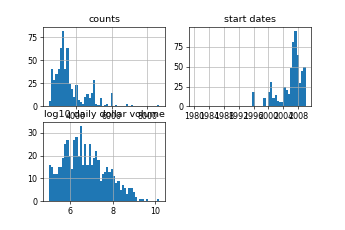

/home/fj/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


In [9]:
# identify the universe of ETFS
#############################################################
%nbagg
from research.etf_technical import etf_data_apr2020 as etfd; reload( etfd )

hps.universe = mx.HPSet(
    start = '20100101',
    end='20200401',
    min_count=2000,
    min_dollar_vol=1e5
)
etf_stats = etfd.compute_etf_stats()
etf_stats = etf_stats[etf_stats.vendor=='kibot']
orig_len = len( etf_stats )
# drop etfs without enough history
etf_stats = etf_stats[(etf_stats['start'] <= hps.universe.start ) 
                      & (etf_stats['end'] > hps.universe.end ) 
                      & (etf_stats['n'] >= hps.universe.min_count)
                      & (etf_stats['daily_dollar_volume_adj'] >= hps.universe.min_dollar_vol ) ]

disp( 'after filtering', len( etf_stats ), 'symbols out of original ' ,orig_len )

etf_stats = (etf_stats
             .merge( etfd.all_etfs, how='left', left_on='symbol', right_on='Symbol' )
             .drop( columns=['Symbol', 'ETP Name', 'Leveraged / Inverse' ])
             .rename( columns={'Asset Class':'asset_class', 'Description':'name'} )
             .fillna( 'Not Specified')             
             .set_index('symbol')
            )
disp( etf_stats.groupby('asset_class').name.count() )

ax = subplot( 2,2, 1 )
etf_stats.n.hist(ax=ax, bins=50)
ax.set_title( 'counts')

ax = subplot( 2,2, 2 )
etf_stats.start.hist(ax=ax, bins=50)
ax.set_title( 'start dates')

ax = subplot( 2,2, 3 )
etf_stats.daily_dollar_volume_adj.log10().hist(ax=ax, bins=50)
ax.set_title( 'log10 daily dollar volume')

# this is the universe we will work with. 
# HERO has a massive returns spike in 2015.11.09 - which throws off residualization quite a bit.
hps.universe.symbols = sorted( etf_stats.index.values )


In [10]:
# load the new data from April 2020
#############################################
from research.etf_technical import etf_data_apr2020 as etfd; reload( etfd )

# fetch the data as a dataarray
concater = etfd.Concat30minData( symbols=hps.universe.symbols ).set(memoize=True)
concater.data = None
disp( 'concater Concat30minData_dec5b03cf expected got', concater.hash() )
da = concater(  )

disp( concater.output_meta.mean() )

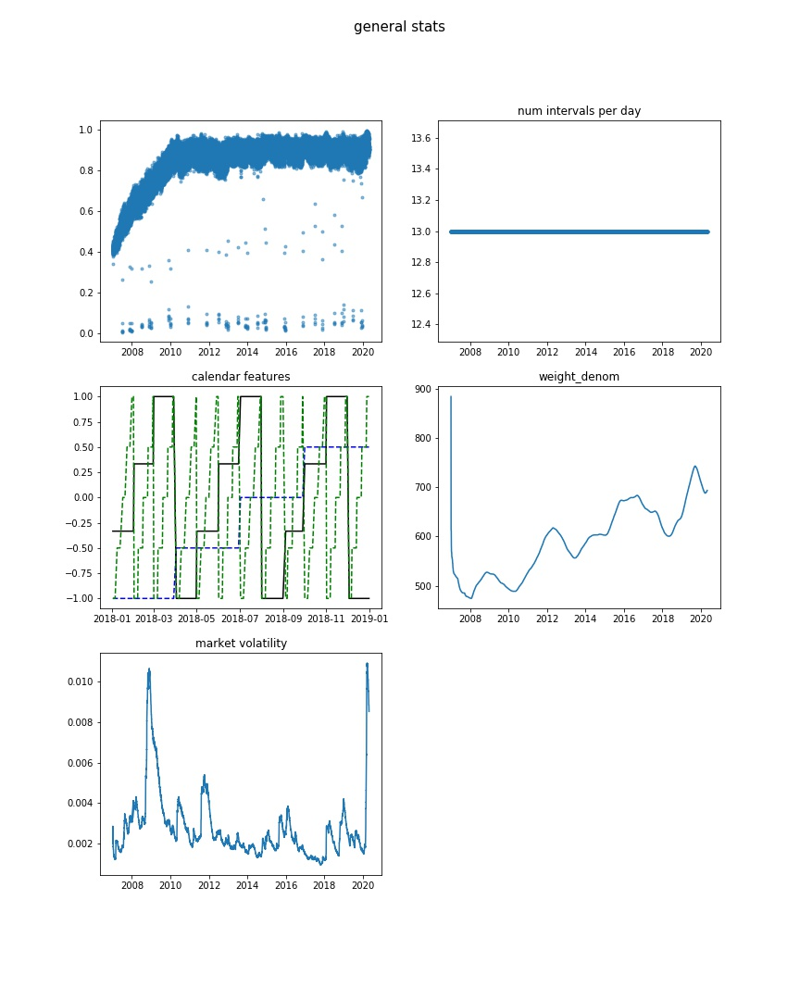

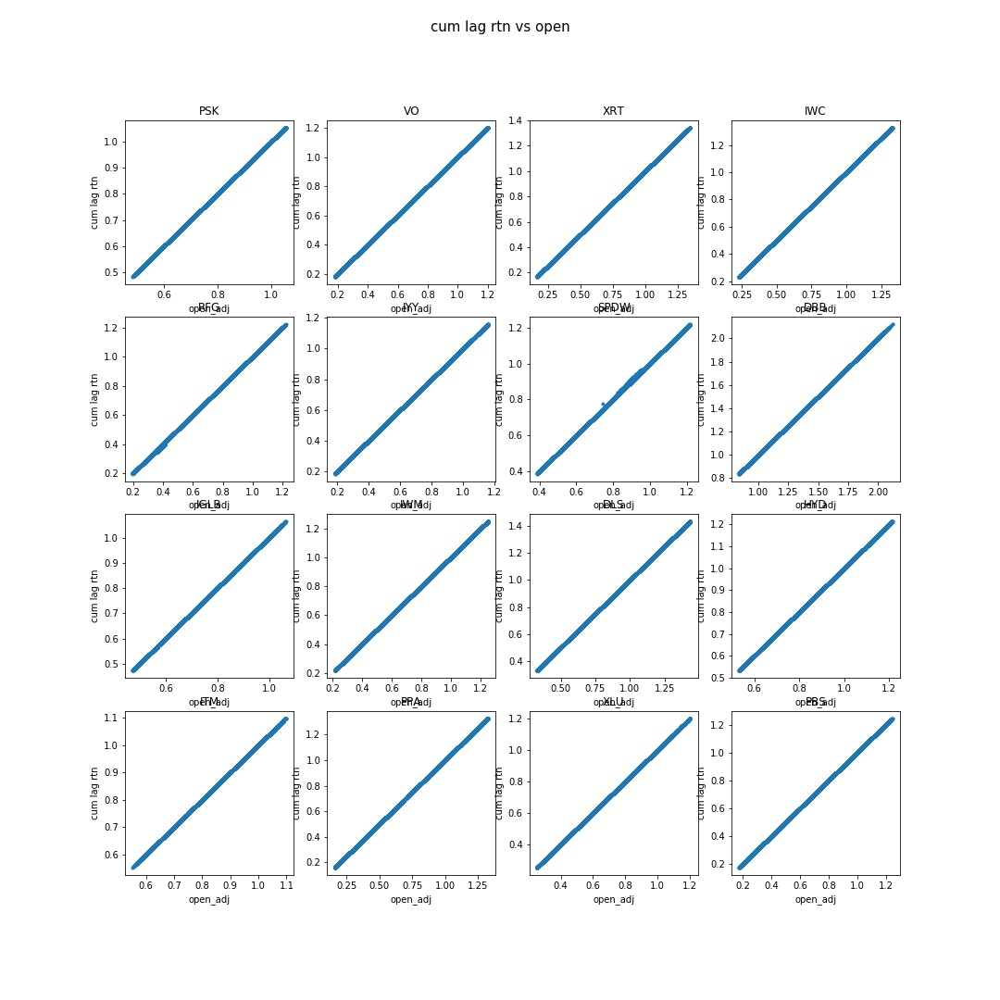

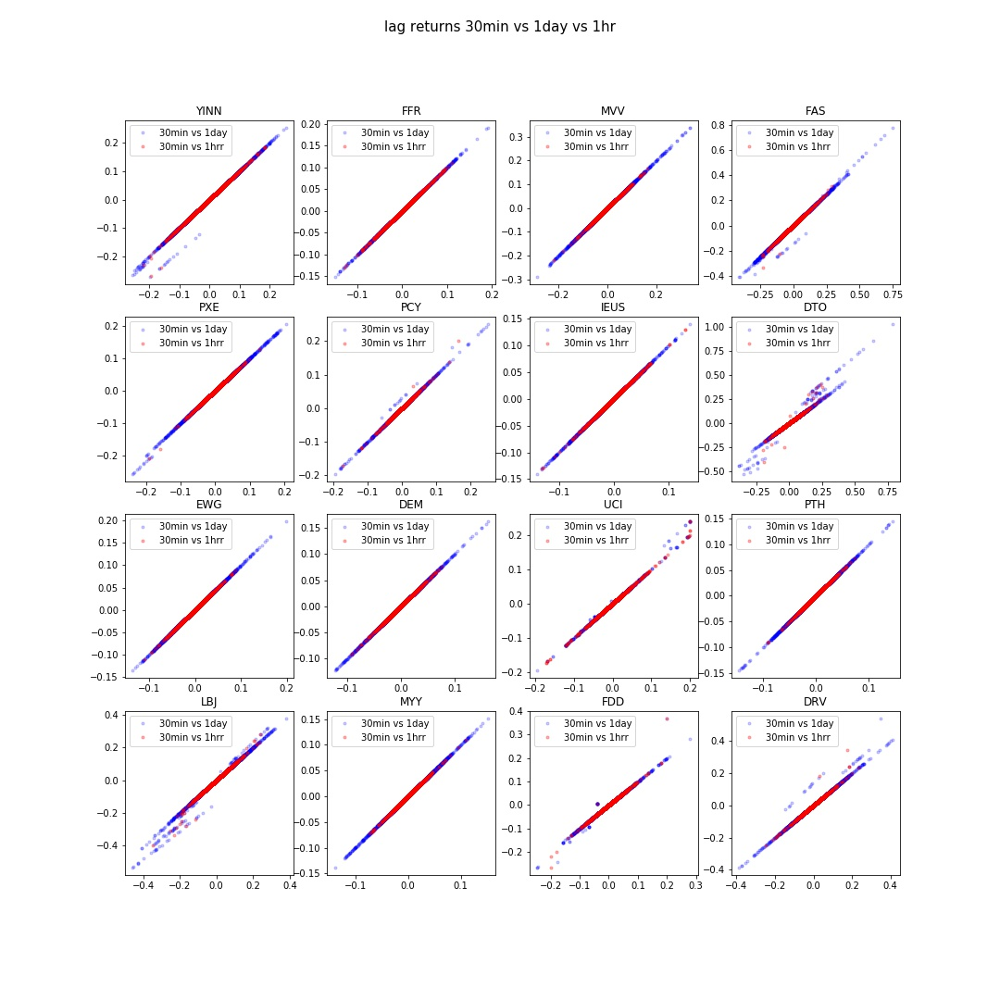

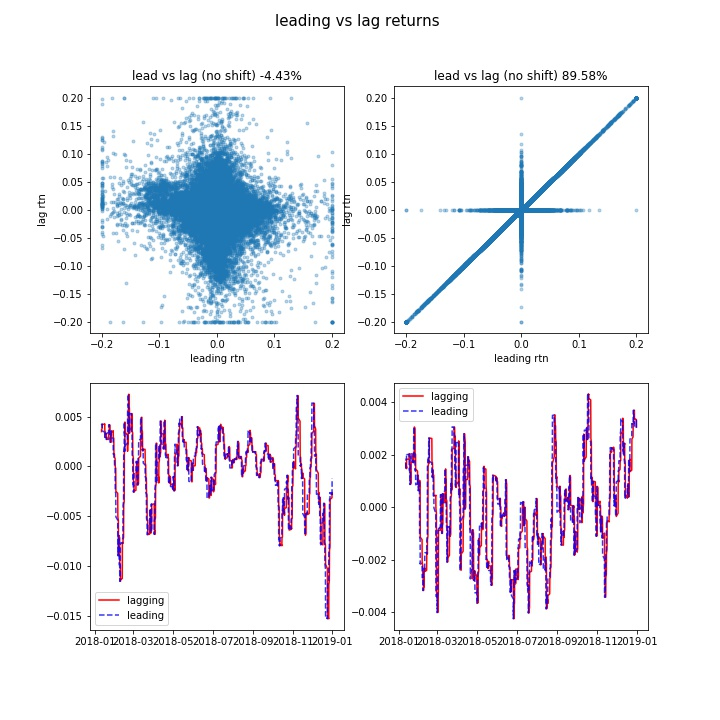

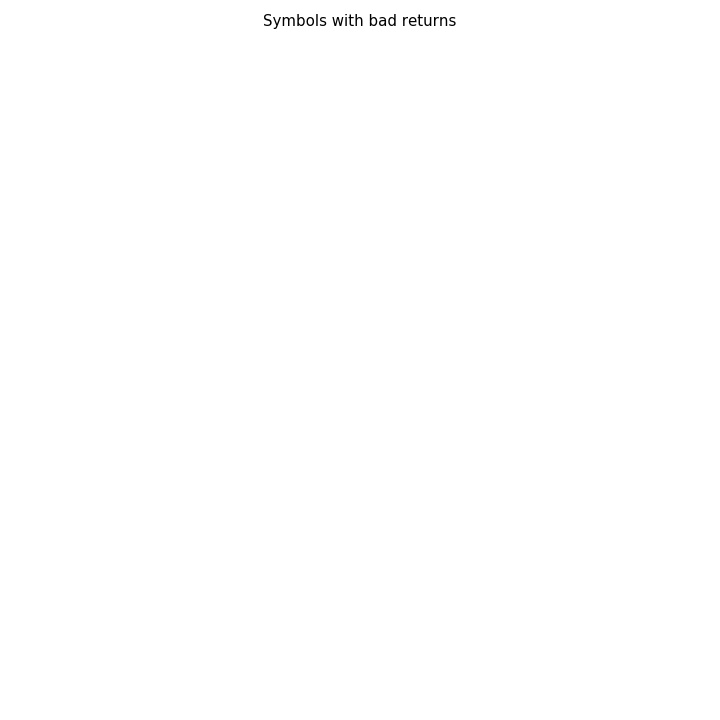

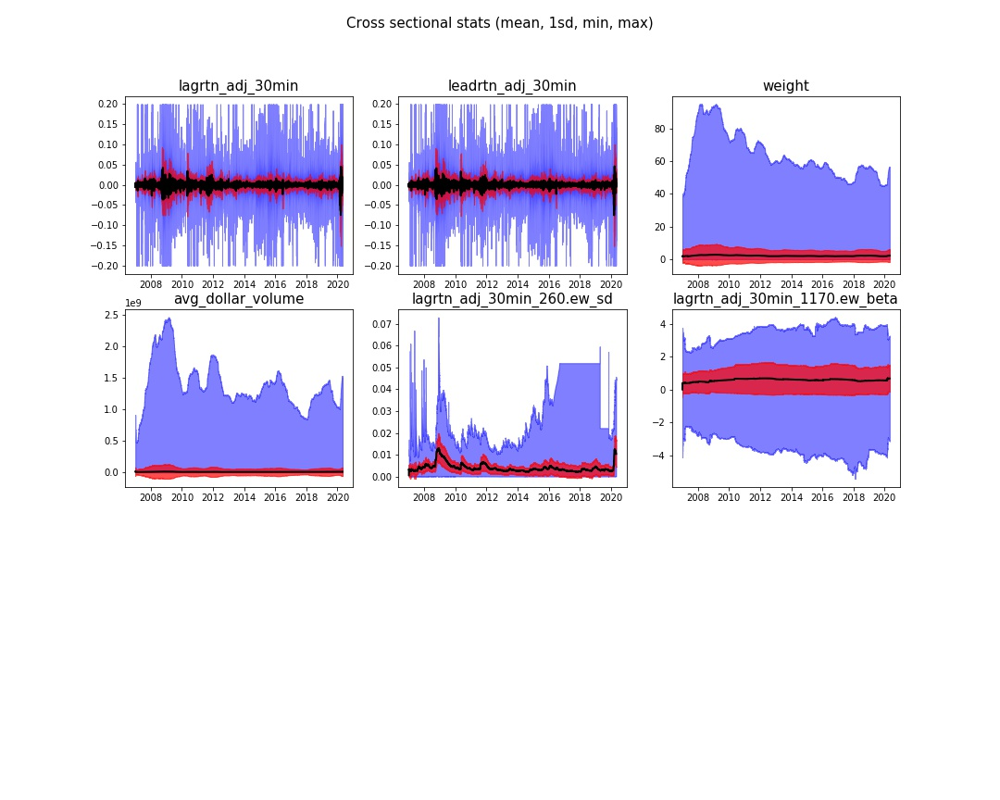

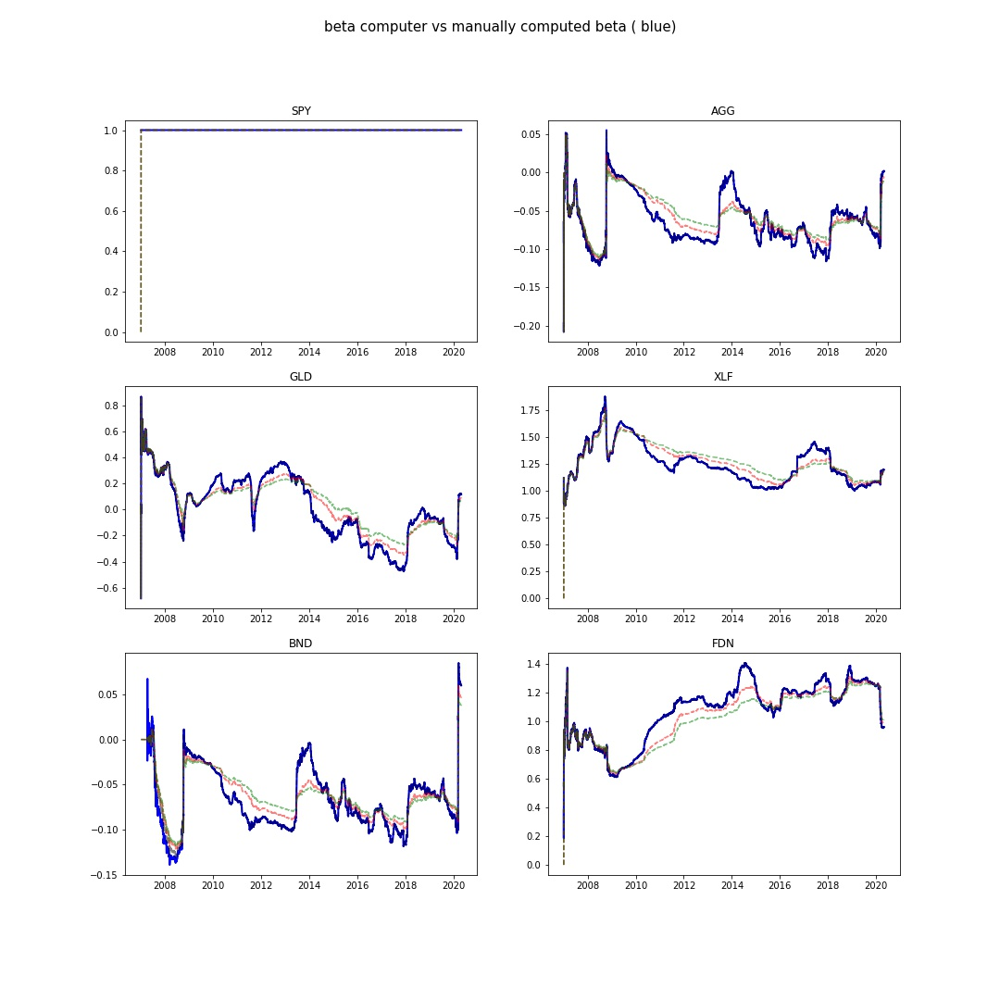

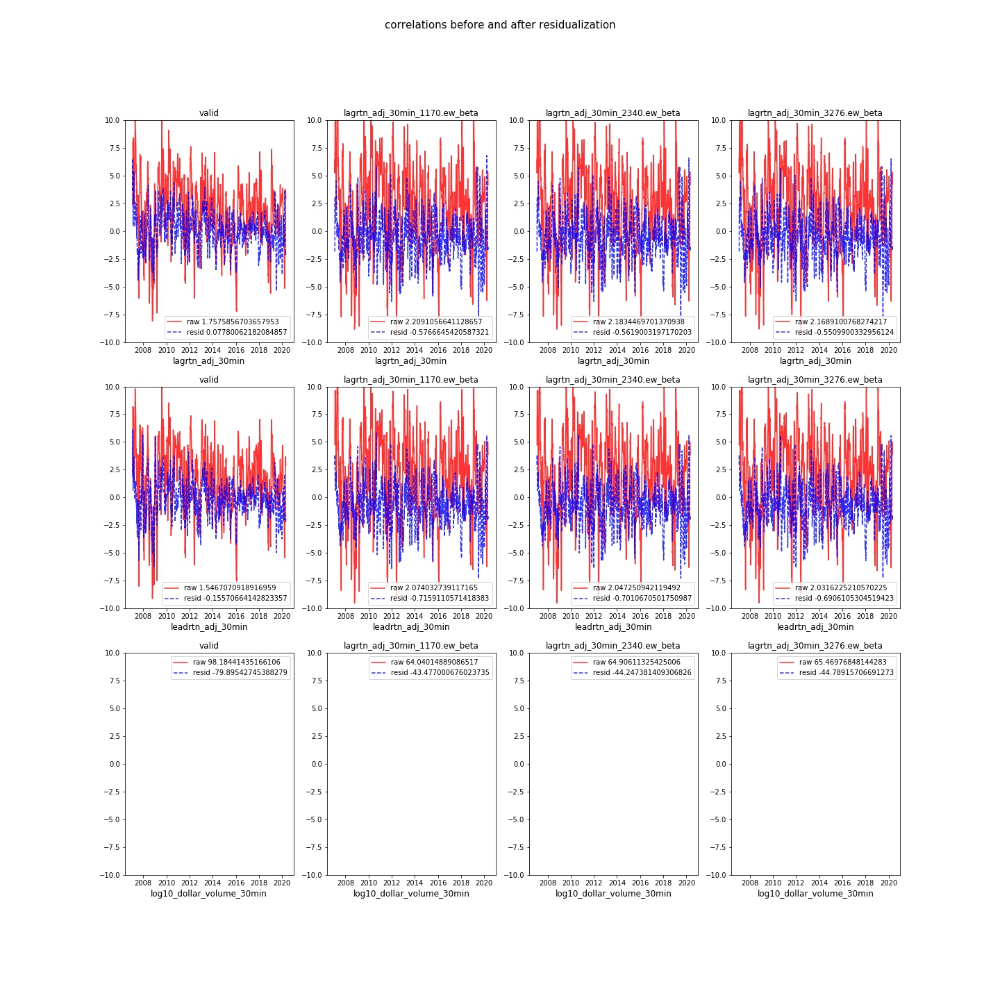

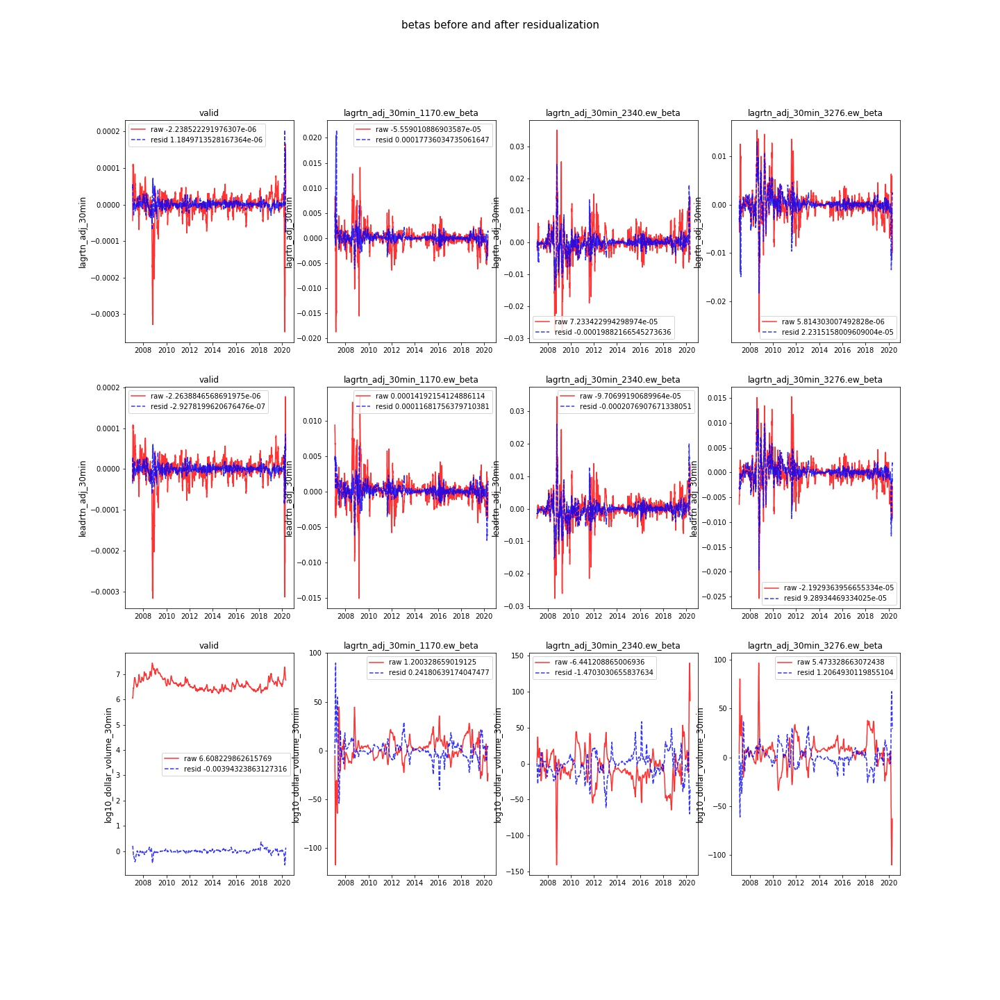

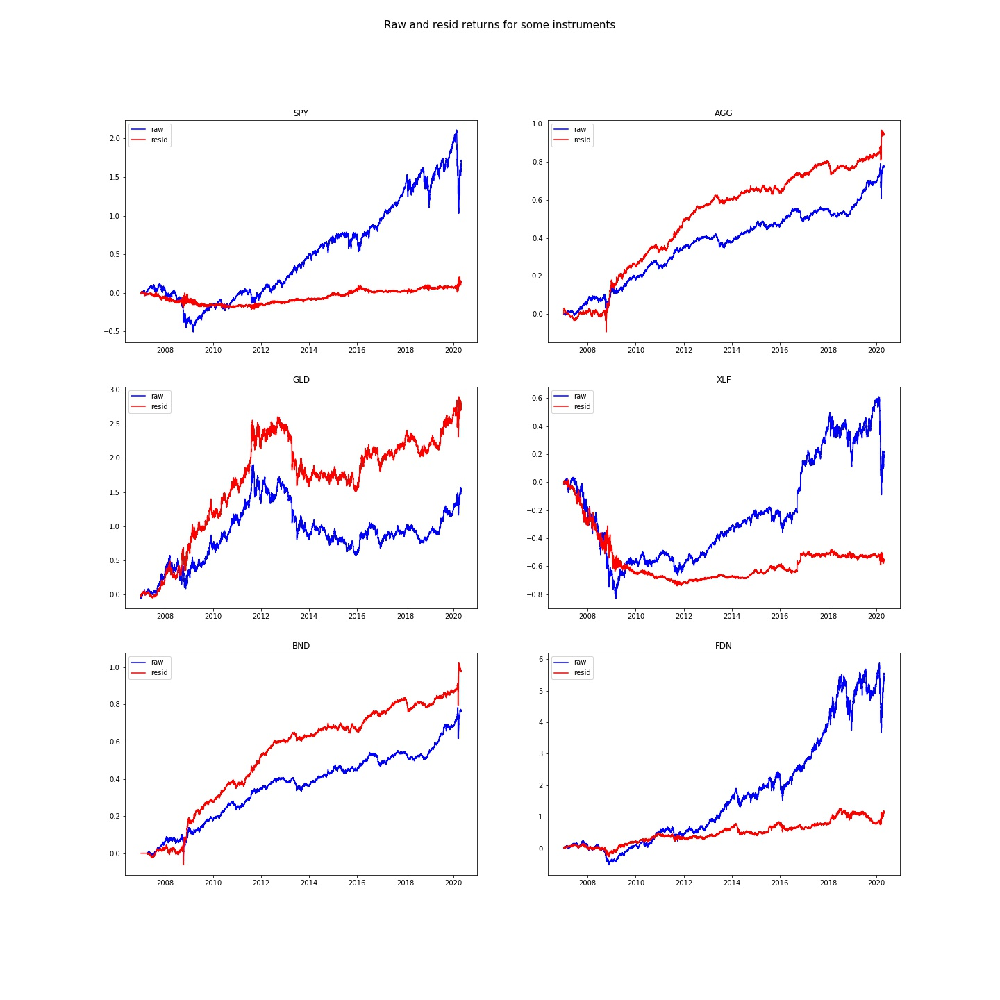

In [11]:
# compute log-returns, log-dollar-volume, betas, residual returns and clean up the data
#########################
%inline
from research.etf_technical import compute_returns_apr2020 as etfrc; reload( etfrc )

# hyperparams related to computing returns and residuals
hps.returns_hps = mx.HPSet(
    resid_halflife=13,
    beta_halflifes=[13 * 90, 13 * 180, 13 * 252],
    dollar_volume_window=13*180,
    emv_halflifes=[20 * 13, 60 * 13, 252 * 13],
    volscale=False,
)

rtn_computer = etfrc.compute_returns_betas_and_residuals( 
    start=hps.start, 
    end=None, 
    emv_halflifes=hps.returns_hps.emv_halflifes, 
    dollar_volume_window=hps.returns_hps.dollar_volume_window, 
    resid_halflife=hps.returns_hps.resid_halflife,
    beta_halflifes=hps.returns_hps.beta_halflifes, 
    volscale=hps.returns_hps.volscale,
    plots=True
) 
rtn_computer.data = concater
disp( 'expected compute_returns_betas_and_residuals_da29d26d3 got', rtn_computer.hash(), h=4, color='teal' )
da = rtn_computer(  )

for fig in rtn_computer.output_meta:
    disp( fig )


/home/fj/cloud/code/madmax/experiment/hpset.py:17: UserWarning: converting dict tv={1: 1, 6: 0.1, 13: 0.001}  to OrderedDict - use HPSet instead 
  warnings.warn( f'converting dict {k}={v}  to OrderedDict - use HPSet instead ' )


,n,finite_frac,tilt,pmSR,ic,r2,tstat,ac_1,ac_6,ac_13
name,,,,,,,,,,
"[reshaped, main]",26240578,0.941827,0.117985,6.646178,0.534420,0.285604,3143.538086,0.137752,0.021205,0.000233
"[reshaped, error]",26240578,0.941827,0.454829,2.384736,0.755809,0.571247,5739.011230,0.012013,-0.005941,-0.045734


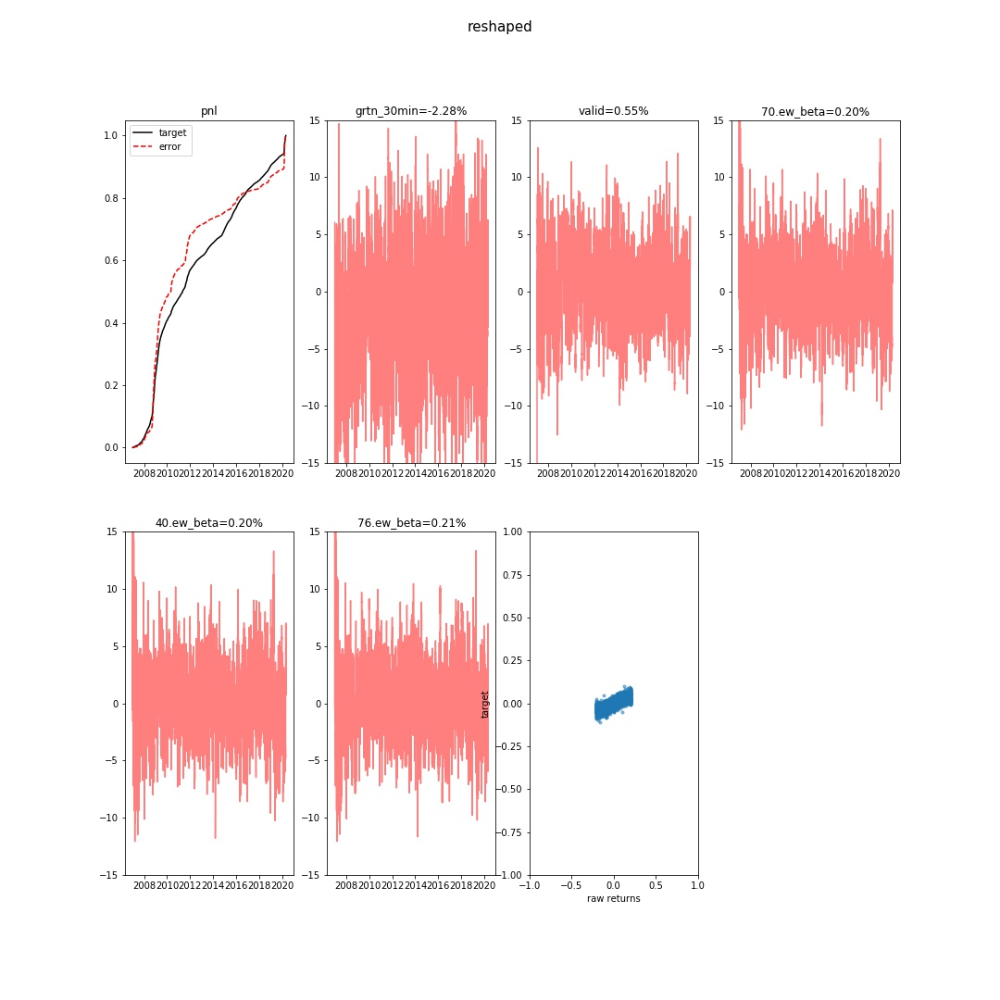

,n,finite_frac,tilt,pmSR,ic,r2,tstat,ac_1,ac_6,ac_13
name,,,,,,,,,,
[main],26240578,0.941827,0.362728,3.279792,1.0,1.0,33822208.0,-0.012171,-0.006055,-0.033931
[error],26240578,0.941827,3751.600647,3.279725,1.0,1.0,15874427.0,-0.012172,-0.006055,-0.033932


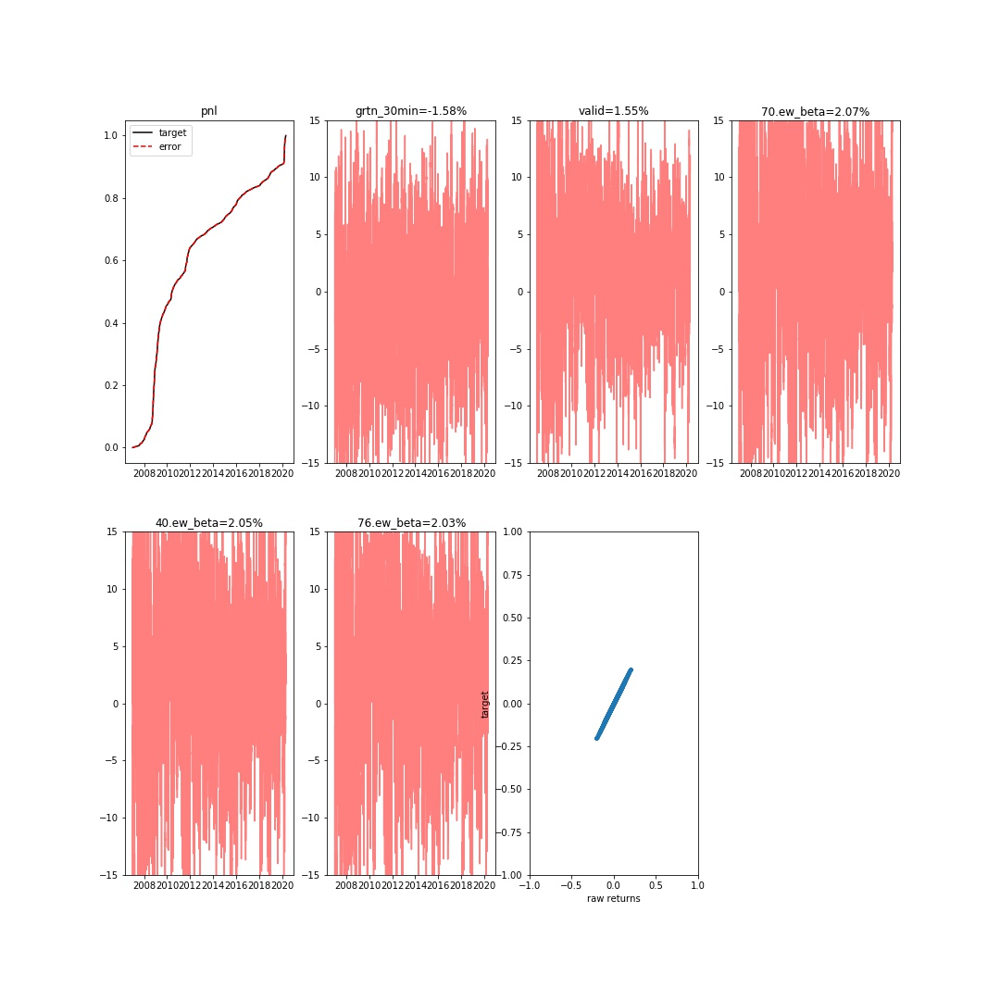

,n,finite_frac,tilt,pmSR,ic,r2,tstat,ac_1,ac_6,ac_13
name,,,,,,,,,,
[main],26240578,0.941827,0.010766,3.287497,0.989797,0.979698,34536.308594,-0.031150,-0.019888,-0.042889
[error],26240578,0.941827,17.305328,1.475057,0.174821,0.030562,882.047974,0.964263,0.740024,0.480738


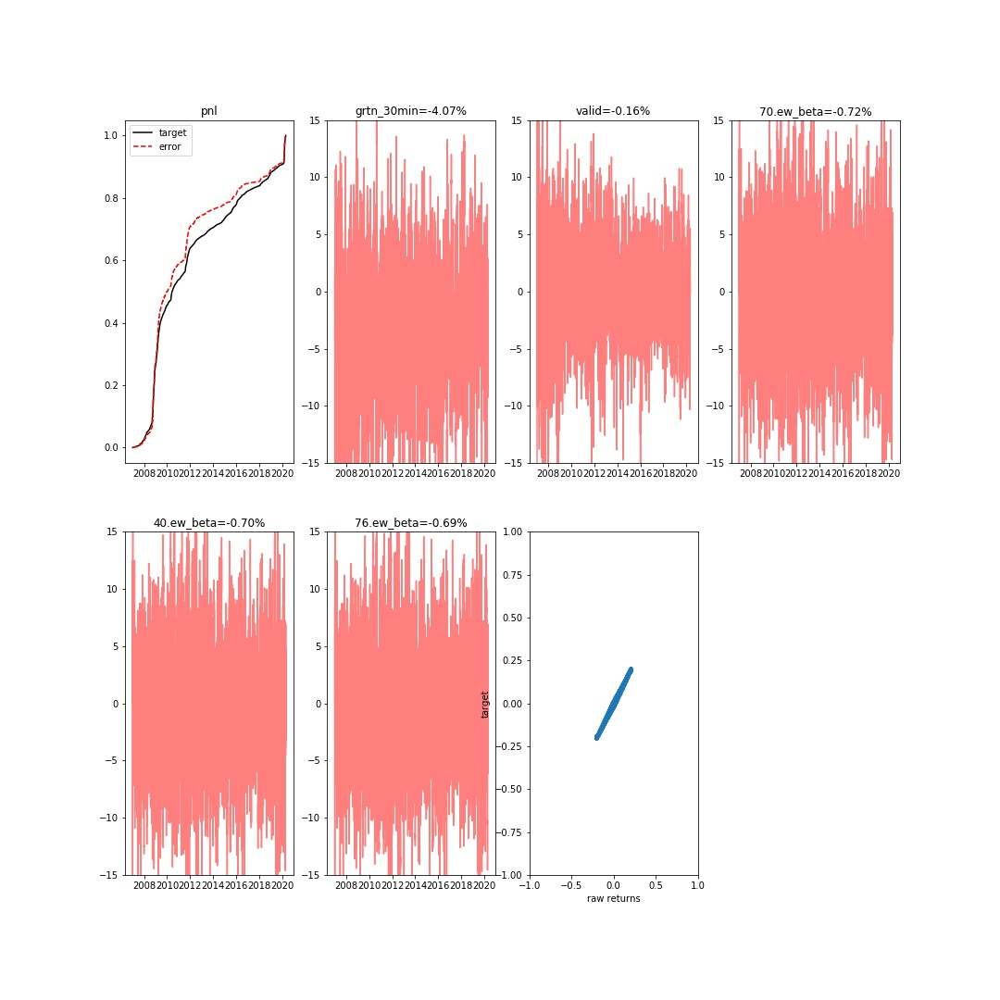

In [12]:
# Rehsape the returns
############################################
%inline
mx = mx.reload()
mxtr = mxtr.reload()
mx.Config.start()

disp( mx.tensorboard.start_server() )
disp( mx.tensorboard.start( clear=True ) )

hps.target_reshape = mx.HPSet(
    facrtn_penalty=1e3,
    facld_penalty=1e3,
    kappa=1,
    tv={1:1, 6:1e-1, 13:1e-3},    
    facld_features = ['valid', 'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min_2340.ew_beta','lagrtn_adj_30min_3276.ew_beta'],
    facrtn_feature = ['mkt_lagrtn_30min'],
    leading_return='leadrtn_adj_30min',
    weight='weight',
)


def _roll_corr( X, Y, win=5 * 13 ):
    XY = (X * Y).mean( axis=1 )
    Xs = (X.sq()).mean( axis=1 ).sqrt()
    Ys = (Y.sq()).mean( axis=1 ).sqrt()
    XYc = 100 * (XY / (Xs + 1e-13) / (Ys + 1e-13))
    # apply a smoothing filter to the correlations
    return XYc.to_series().rolling( win, min_periods=1 ).mean(), XYc.mean().item()

def regression_results( X_da, Y_da, W_da, facrtn_da, facld_da, name=[] ):
    '''run a regression measuing factor correlations and exposures'''
    reg = mx.Regression( autocorr=[1, 6, 13], dk_lags=None )
    regs = []
    num_figs = 2 + facrtn_da.shape[-1] + facld_da.shape[-1]
    num_rows = 2
    num_cols = int( ceil(num_figs / num_rows ) )
    #--- plain regressions ---
    fig = figure( figsize=(15, 15  ) )
    rm = reg.regress( x=X_da, y=Y_da, w=W_da )    
    rm['name'] = name + ['main']
    rm.pop( 'hitRate' )
    pnl = rm.pop( 'pnl' )
    pnl = pnl.cumsum() / pnl.sum()
    regs.append( rm )
    ax = subplot( num_rows, num_cols, 1 )
    ax.plot( pnl, '-k', label='target' )
    #--- regression of the error of the target variable---
    try:
        # the error of the target
        ols = sm.OLS( exog=X_da.values.reshape(-1), endog=Y_da.values.reshape(-1),  missing='drop').fit()
        Yerr_da = xa.DataArray( Y_da.values - ols.params[0]*X_da.values, dims=Y_da.dims, coords=Y_da.coords )
        rrm = reg.regress( x=Yerr_da, y=Y_da, w=W_da )    
        rrm['name'] = name + ['error']
        rrm.pop( 'hitRate' )
        rpnl = rrm.pop( 'pnl' )
        rpnl = rpnl.cumsum() / rpnl.sum()
        regs.append( rrm )    
        ax.plot( rpnl, '--r', label='error' )
    except Error as e:
        print( 'regression on error term failed ' )
    ax.set_title( "pnl" )    
    ax.legend()    
    # rolling correlation with the factor returns
    for i, fc in enumerate( facrtn_da.features.values ):        
        frc, frm = _roll_corr( X_da, facrtn_da.loc[:,:,fc] )
        ax = subplot( num_rows, num_cols, 1 + i + 1 )
        ax.plot( frc.time_index, frc.values, '-r', alpha=0.5 )
        ax.set_title( f'{fc[-10:]}={frm:0.2f}%')
        ax.set_ylim([-15,15])
    # rolling correlation with the factor 
    for j, fc in enumerate( facld_da.features.values ):        
        frc, frm = _roll_corr( X_da, facld_da.loc[:,:,fc] )
        ax = subplot( num_rows, num_cols, 1 + i + 1 + j + 1)
        ax.plot( frc.time_index, frc.values, '-r', alpha=0.5 )
        ax.set_title( f'{fc[-10:]}={frm:0.2f}%')
        ax.set_ylim( [-15,15] )
    # scatter plot of reshaped versus original
    ax = subplot( num_rows, num_cols, 1 + i + 1 + j + 1 +1 )
    ys = Y_da.values.reshape(-1)
    xs = X_da.values.reshape(-1)
    mask = rand( len( ys ) ) < 1 / 2
    ax.plot( ys[mask], xs[mask], '.', alpha=0.5 )
    ax.set_xlabel( 'raw returns' )
    ax.set_ylabel( 'target' )
    ax.set_xlim( [-1,1] )
    ax.set_ylim( [-1,1] )    
    fig.suptitle( '_'.join( name ), fontsize=15 )
    return dict( regs=pd.DataFrame(regs).set_index('name'), fig=mx.fig2format( fig ) )     

@mx.operatorize( consumes_features=False, produces_features=True, produces_meta=True, memoize=True )
def ReshapeTarget( data, start, hps ):    
    ''' do target reshaping'''        
    Y_da = data.loc[start:,:, hps.leading_return]
    W_da = data.loc[start:,:, hps.weight ]
    facrtn_da = data.loc[start:,['SPY'], hps.facrtn_feature]
    facld_da = data.loc[start:,:,hps.facld_features ]
    target_shaper = mx.TargetShaper(
        facrtn_penalty=hps.facrtn_penalty,
        facld_penalty=hps.facld_penalty,
        facld_residualize=False,
        obj='util',
        adapted=True,
        kappa=hps.kappa,
        tv=hps.tv,
        lr=1e-2,
        rel_tol=1e-7,
        max_its=1000,
        eps=1e-12,
        facrtn_winlen=None,
        facld_winlen=None,
    ).to( device, dtype )
    target_shaper.verbose = True    
    # do the reshaping ---
    X = target_shaper( 
        Y=Y_da.to_tensor( dtype=dtype, device=device ).unsqueeze(-1),
        W=W_da.to_tensor( dtype=dtype, device=device ).unsqueeze(-1),
        facrtns=facrtn_da.to_tensor( dtype=dtype, device=device ),
        faclds=facld_da.to_tensor( dtype=dtype, device=device ),
    )    
    X_da = X.squeeze(-1).to_dataarray( Y_da ) 
    reshaped_feature = f'{hps.leading_return}_reshaped'    
    data  = data.assign_features( **{reshaped_feature:X_da } )
    regres = regression_results( X_da=X_da, Y_da=Y_da, W_da=W_da, facrtn_da=facrtn_da, facld_da=facld_da, name=['reshaped'] )
    return data, reshaped_feature, regres

target_reshaper = ReshapeTarget(
    start=hps.start,
    hps=hps.target_reshape,
)
target_reshaper.data = rtn_computer
disp( 'expected ReshapeTarget_1d28e60c5 got, ', target_reshaper.hash())

da = target_reshaper()
disp( 'reshaped returns', h=2 )
disp( target_reshaper.output_meta['regs'] )
disp( target_reshaper.output_meta['fig'] )


@mx.operatorize( memoize=True, consumes_features=False, produces_features=False, produces_meta=True )
def raw_and_resid_regressions( data, hps ):
    da = data
    raw_regs = regression_results( 
        X_da=da.loc[hps.start:,:,'leadrtn_adj_30min'],
        Y_da=da.loc[hps.start:,:,'leadrtn_adj_30min'],
        W_da=da.loc[hps.start:,:,'weight'],
        facrtn_da = data.loc[hps.start:,['SPY'], hps.target_reshape.facrtn_feature],
        facld_da = data.loc[hps.start:,:,hps.target_reshape.facld_features ],
    )
    resid_regs = regression_results( 
        X_da=da.loc[hps.start:,:,'leadrtn_adj_30min_resid'],
        Y_da=da.loc[hps.start:,:,'leadrtn_adj_30min'],
        W_da=da.loc[hps.start:,:,'weight'],
        facrtn_da = data.loc[hps.start:,['SPY'], hps.target_reshape.facrtn_feature],
        facld_da = data.loc[hps.start:,:,hps.target_reshape.facld_features ],
    )
    return data, (raw_regs, resid_regs)

with mx.timer('running raw and residaul regreressions'):
    rr = raw_and_resid_regressions(  hps=hps )
    rr.data = target_reshaper
    rr()
    raw_regs, resid_regs = rr.output_meta
    disp( 'raw returns', h=3 )
    disp( raw_regs['regs'] )
    disp( raw_regs['fig'] )
    disp( 'resid returns', h=3 )
    disp( resid_regs['regs'] )
    disp( resid_regs['fig'] )


In [13]:
# one last stage of feature cleanup - that failed earlier because of memory blowouts

@mx.operatorize( memoize=True, consumes_features=False, produces_features=False )
def FinalStageOfFeatureCreation( da, ema_halflifes=[5*13, 20*13, 180*13, 252*13] ):    
    da = da.drop_mx( ['open_adj_30min', 'close_adj_30min', 'high_adj_30min', 'low_adj_30min', 'volume_adj_30min',
                      'dollar_volume_adj_30min', 'market', 'after_market', 'pre_market'] )
    ema = mx.transforms.exponential( sid='symbol', halflifes=ema_halflifes ).mean( weight='weight' )
    da = ema( da, features=['log10_dollar_volume_30min', 'lagrtn_adj_30min', 'mkt_lagrtn_30min','log10_dollar_volume_30min_resid', 'lagrtn_adj_30min_resid', 'atr_30min',  ] )    
    da = da.assign_features(
        log_open_unadj_30min=da.loc[:,:,'open_unadj_30min'].log(),
        log_close_unadj_30min=da.loc[:,:,'close_unadj_30min'].log()
    )
    return da
    
feature_builder = FinalStageOfFeatureCreation()
feature_builder.data = target_reshaper
disp( 'expected FinalStageOfFeatureCreation_8ba339bb2  got, ', feature_builder.hash())
da = feature_builder()

In [14]:
# the feautres built up to now ...
################################################
hps.feature_set = mx.HPSet(
    prices=[
        'open_unadj_30min', 'close_unadj_30min', 'log_open_unadj_30min', 'log_close_unadj_30min'
        # 'high_unadj_30min', 'low_unadj_30min', 
    ],
    volume=[
        'volume_unadj_30min', 'dollar_volume_unadj_30min',   #'avg_dollar_volume',      
    ],
    log_volume=[
        'log10_dollar_volume_30min', 
        'log10_dollar_volume_30min_65.ew_mean', 'log10_dollar_volume_30min_260.ew_mean',
        'log10_dollar_volume_30min_2340.ew_mean', 'log10_dollar_volume_30min_3276.ew_mean',
    ],
    resid_volume=[
        'log10_dollar_volume_30min_resid',
        'log10_dollar_volume_30min_resid_65.ew_mean', 'log10_dollar_volume_30min_resid_260.ew_mean',
        'log10_dollar_volume_30min_resid_2340.ew_mean', 'log10_dollar_volume_30min_resid_3276.ew_mean',
    ],
    volume_sd=[
        'log10_dollar_volume_30min_260.ew_sd', 'log10_dollar_volume_30min_780.ew_sd', 'log10_dollar_volume_30min_3276.ew_sd',
        'log10_dollar_volume_30min_resid_260.ew_sd', 'log10_dollar_volume_30min_resid_780.ew_sd', 'log10_dollar_volume_30min_resid_3276.ew_sd',
    ],
    delta_log_volume = [
        'delta_log10_dollar_volume_30min', 'delta_log10_dollar_volume_30min_260.ew_sd', 
        'delta_log10_dollar_volume_30min_780.ew_sd', 'delta_log10_dollar_volume_30min_3276.ew_sd',        
    ],
    calendar=[
        'timeofday', 'cos1_timeofday', 'cos2_timeofday', 'cos4_timeofday',
        'dayofweek', 'cos1_dayofweek', 'cos2_dayofweek',
        'weekofmonth', 'cos1_weekofmonth', 'cos2_weekofmonth',
        'monthofquarter', 'cos1_monthofquarter', 'cos2_monthofquarter',
        'quarterofyear', 'cos1_quarterofyear', 'cos2_quarterofyear',
    ],
    lagging=[
        'lagrtn_adj_30min', 'lagrtn_adj_1hr', 'lagrtn_adj_1day',
        'lagrtn_adj_30min_65.ew_mean', 'lagrtn_adj_30min_260.ew_mean',
        'lagrtn_adj_30min_2340.ew_mean', 'lagrtn_adj_30min_3276.ew_mean',
         #'delta_rtn_30min','lagrtn_adj_1hr', 'lagrtn_adj_1day',
    ],
    mkt=[
        'mkt_lagrtn_30min', 'mkt_lagrtn_30min_65.ew_mean',
        'mkt_lagrtn_30min_260.ew_mean', 'mkt_lagrtn_30min_2340.ew_mean', 'mkt_lagrtn_30min_3276.ew_mean',        
    ],
    resid_lagging=[
        'lagrtn_adj_30min_resid', 'lagrtn_adj_30min_resid_65.ew_mean', 'lagrtn_adj_30min_resid_260.ew_mean',
        'lagrtn_adj_30min_resid_2340.ew_mean', 'lagrtn_adj_30min_resid_3276.ew_mean'
    ],
    vol=[
        'lagrtn_adj_30min_260.ew_sd', 'lagrtn_adj_30min_780.ew_sd', 'lagrtn_adj_30min_3276.ew_sd',        
        'atr_30min', 'atr_30min_65.ew_mean', 'atr_30min_260.ew_mean', 'atr_30min_2340.ew_mean', 'atr_30min_3276.ew_mean'
    ],
    resid_vol=[
        'lagrtn_adj_30min_resid_260.ew_sd', 'lagrtn_adj_30min_resid_780.ew_sd', 'lagrtn_adj_30min_resid_3276.ew_sd',
    ],
    mkt_vol=[
        'mkt_lagrtn_30min_260.ew_sd', 'mkt_lagrtn_30min_780.ew_sd', 'mkt_lagrtn_30min_3276.ew_sd',
    ],
    betas=[
        'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min_2340.ew_beta', 'lagrtn_adj_30min_3276.ew_beta',
    ],
)
hps.leading_rtns =[
    'leadrtn_adj_30min', 'leadrtn_adj_30min_resid', 'leadrtn_adj_30min_reshaped',
    'leadrtn_adj_1hr', 'leadrtn_adj_1day',  
    'mkt_leadrtn_30min', 'mkt_leadrtn_1day',    
]
hps.weights =  ['valid', 'weight', ]

In [ ]:
##### Profile the various sub-feature sets computed (don't run this too often - the profiler has fucked up checkpoints)
###########################################################################################
%inline
@mx.operatorize( memoize=True, produces_features=False )
def FeatureCorrelations( data, features, start, frac=0.5 ):
    '''computer feature set correlations'''
    data = data.loc[start:, :, features]
    if frac:
        ix = pd.Series( range( len( data ) ) ).sample( frac=frac, random_state=1 )
        data = data[ix.values]
    return data.corr()


def process_one_feature_set( data=feature_builder, fs_features=None, leading=hps.leading_rtns ):
    '''profile one feature set '''
    from madmax.api import mx
    with mx.timer( 'computing feautre coorelations' ):
        fc = FeatureCorrelations( start='20150101' )
        fc.data = data
        fc.features = fs_features + leading
        corr_df = fc()
    with mx.timer( 'running profile' ):
        #  -- profile the features
        profiler = mx.FeatureProfiler(
            returns=['leadrtn_adj_30min', 'leadrtn_adj_30min_resid', 'leadrtn_adj_30min_reshaped'],
            exposures=['valid', 'lagrtn_adj_30min_1170.ew_beta', 'mkt_lagrtn_30min'],
            transforms=None, weight='weight', winsorize=0.05, xs=None, start='20150101',
            lags=[1, 3, 5], autocorr=[1, 2, 13, 26]
        ).set( verbose=False, memoize=True )
        profiler.data = data
        profiler.features = fs_features
        profiler.run()
    return corr_df, profiler

for fs in hps.feature_set.keys():    
    fs_features = getattr( hps.feature_set, fs )
    disp( 'processing ', fs_features, h=2 )
    corr_df, profiler = process_one_feature_set( fs_features=fs_features ) 
    mx.disp( corr_df.loc[fs_features], corr=True )    
    profiler.display()     
    
    

/home/fj/cloud/code/madmax/experiment/hpset.py:17: UserWarning: converting dict transformer={'pre_normalize': True, 'quadratic': True, 'post_normalize': True}  to OrderedDict - use HPSet instead 
  warnings.warn( f'converting dict {k}={v}  to OrderedDict - use HPSet instead ' )


,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,18050970,0.881986,0.004079,1.346482,0.018463,3.408790e-04,73.115540,7.905241,0.314998,0.186654,0.215357,0.204344
leadrtn_adj_1hr,NaN,18050970,0.881955,0.004079,1.045943,0.014550,2.117157e-04,57.733398,6.132952,0.314998,0.186654,0.215357,0.204344
leadrtn_adj_30min,1.0,18050970,0.881957,-0.048660,0.135427,0.001544,2.384186e-06,6.229001,0.746536,0.328970,0.188217,0.219922,0.204069
leadrtn_adj_1hr,1.0,18050970,0.881926,-0.048660,0.145325,0.000488,2.384186e-07,0.497603,0.062025,0.328970,0.188217,0.219922,0.204069
leadrtn_adj_30min,3.0,18050970,0.881899,-0.051618,0.125915,0.000345,-1.192093e-07,0.075252,0.011501,0.322024,0.183945,0.218638,0.203334
leadrtn_adj_1hr,3.0,18050970,0.881868,-0.051618,0.269973,-0.000772,5.960464e-07,-2.874197,-0.363824,0.322024,0.183945,0.218638,0.203334
leadrtn_adj_30min,5.0,18050970,0.881841,-0.054618,0.179832,-0.002405,5.781651e-06,-9.272698,-1.036172,0.318379,0.186765,0.218860,0.205387
leadrtn_adj_1hr,5.0,18050970,0.881810,-0.054618,0.248365,-0.002478,6.139278e-06,-9.543101,-0.891322,0.318379,0.186765,0.218860,0.205387


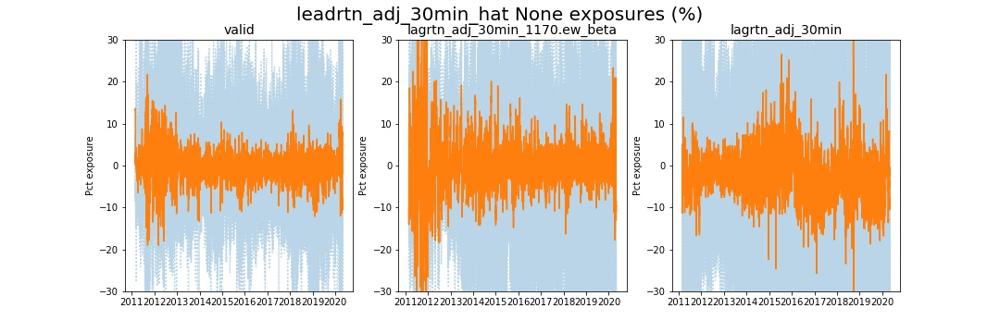

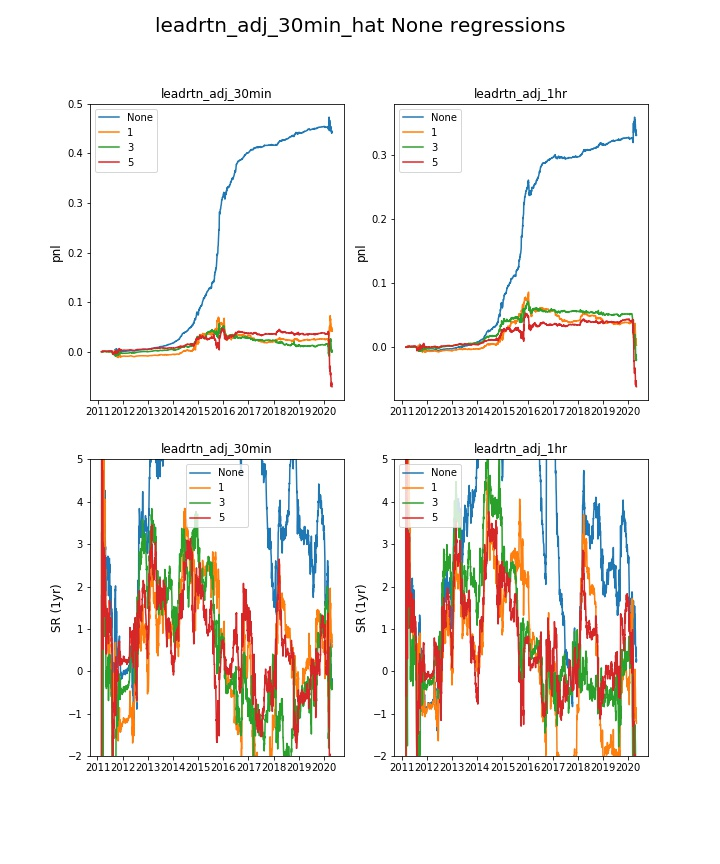

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,18050970,0.881986,-0.076172,1.450795,0.016158,2.610683e-04,63.533573,11.015782,0.476321,0.384109,0.363245,0.350496
leadrtn_adj_1hr,NaN,18050970,0.881955,-0.076172,1.126049,0.012331,1.520514e-04,49.047836,7.278202,0.476321,0.384109,0.363245,0.350496
leadrtn_adj_30min,1.0,18050970,0.881957,-0.185590,0.173956,0.001485,2.205372e-06,5.966966,0.963601,0.490603,0.389721,0.366464,0.352838
leadrtn_adj_1hr,1.0,18050970,0.881926,-0.185590,0.145388,-0.000244,5.960464e-08,-1.742739,-0.250953,0.490603,0.389721,0.366464,0.352838
leadrtn_adj_30min,3.0,18050970,0.881899,-0.194766,0.122511,0.000345,-1.192093e-07,0.794417,0.156092,0.491264,0.391038,0.366845,0.353369
leadrtn_adj_1hr,3.0,18050970,0.881868,-0.194766,0.255400,-0.000345,-1.192093e-07,-0.942288,-0.154448,0.491264,0.391038,0.366845,0.353369
leadrtn_adj_30min,5.0,18050970,0.881841,-0.201108,0.181761,-0.001359,1.847744e-06,-5.464174,-0.828813,0.491796,0.391394,0.366847,0.354493
leadrtn_adj_1hr,5.0,18050970,0.881810,-0.201108,0.230401,-0.001891,3.576279e-06,-6.748982,-0.863217,0.491796,0.391394,0.366847,0.354493


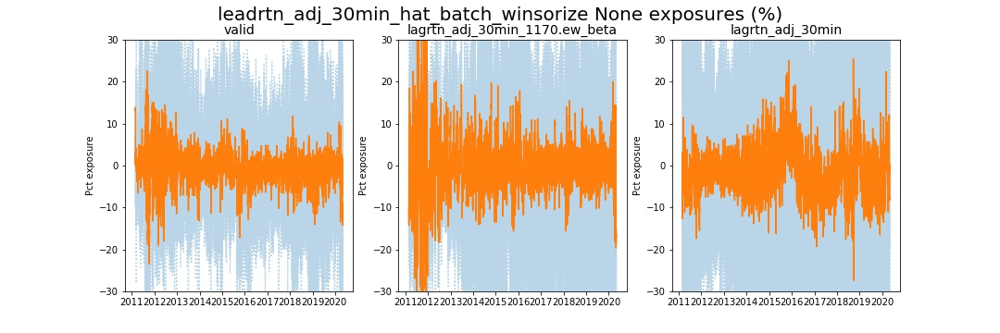

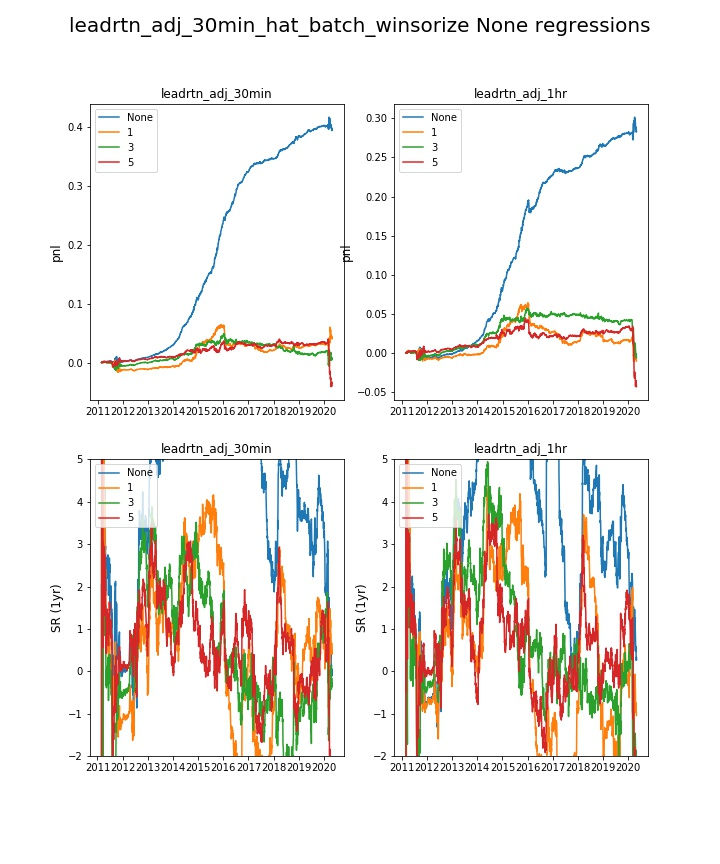

AssertionError: 

In [86]:
# online learning model - using online RNN
###############################################
%inline
mx = mx.reload()
mxtr = mxtr.reload()
from madmax.pytorch.modules import online_rnn as mxol; reload( mxol )
mx.Config.start()

disp( mx.tensorboard.start_server() )
disp( mx.tensorboard.start( clear=True ) )
  
hps.online = mx.HPSet(
    features=(
      ['open_unadj_30min', 'log_open_unadj_30min'] 
      + hps.feature_set.lagging + hps.feature_set.resid_lagging 
      + hps.feature_set.vol + hps.feature_set.resid_vol 
      + hps.feature_set.mkt_vol + hps.feature_set.betas
    ),
    symbol=None,
    target='leadrtn_adj_30min',
    target_shift=None, # advance the target
    lookahead=2,
    ridge=1e-4,
    hl_1 = 50,
    hl_2 = 1000,
    lr = 100,
    kappa=1, # util penalty
    rnn_tv=None, #{1:1, 2:1, 13:1e-1},
    ortho=2,
    ortho_hl=13,
    # orthogonalize out short term mean reversion
    ortho_features = ['valid', 'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min_2340.ew_beta', 'lagrtn_adj_30min_3276.ew_beta', 'lagrtn_adj_30min', 'lagrtn_adj_1day'],
    weight='valid',
    algo='mbprox', #'mbprox',    
    # stuff related to sid weighting
    use_omega=True,
    omega_lr = 5000,
    omega_ridge = 1,
    omega_shift = None,
    pre_winsorize=0.01,
    batch_demean=False,
    batch_normalize=False,
    transformer=dict( pre_normalize=True, quadratic=True, post_normalize=True ),
    start='20110101',
    end='20210101',    
)

@mx.operatorize( memoize=False, consumes_features=False, produces_features=True, produces_meta=True )
def OnlineRunner( da, hps, tensorboard=True, verbose=True ):
    ''' run one configuration end to end''' 
    logger = mx.Logger( 'OnlineRunner' )
    da_use = da.loc[hps.start:hps.end]
    # make sure you don't squeeze out this dimension !
    if hps.symbol:
        da_use = da_use.sel( symbol=mx.make_iterable(hps.symbol ) )            
    features = list( hps.features )
    output_features = []

    if hps.pre_winsorize:
        with logger.timer( '# pre-winsorize teh input features'):
            wins = mx.transforms.batch( sid='symbol' ).winsorize( quantiles=0.05 )
            da_use = wins( da_use, features=features )
            features = wins.output_features
        
    X = da_use.loc[:, :, features ]
    Y = da_use.loc[:, :, [hps.target]]
    # advance the target  and add thsi to the lookahead
    if hps.target_shift:
        Y = Y.lag( -hps.target_shift )
        hps.lookahead += hps.target_shift
    W = da_use.loc[:, :, [hps.weight]]
    Z = da_use.loc[:,:, hps.ortho_features ]
    
    # demean X
    if hps.batch_demean:
        X = ( X - X.mean( dim=['time','symbol']) )
    if hps.batch_normalize:
        X = X / ( X.sq().mean( dim=['time','symbol']).sqrt() + 1e-13 )        
       
    tr.cuda.empty_cache()    
    Xt = X.fillna(0).to_tensor( dtype=dtype, device=device )
    Yt = Y.fillna(0).to_tensor( dtype=dtype, device=device )
    Wt = W.fillna(0).to_tensor( dtype=dtype, device=device )
    Zt = Z.fillna(0).to_tensor( dtype=dtype, device=device )
    
    with logger.timer(" the linear rnn learner"):
        # this round about shit is because cloudpickl in the memoization fucks up nan checks
        if hps.transformer:
            tfs = []
            if hps.transformer['pre_normalize']:
                tfs.append( mxtr.OnlineNorm( demean=True, normalize=True ) )
            if hps.transformer['quadratic']:
                tfs.append( mxtr.Transformer( transform='quadratic')  )
            if hps.transformer['post_normalize']:
                tfs.append( mxtr.OnlineNorm( demean=True, normalize=True ) )
            transformer = tr.nn.Sequential( *tfs )
        else:
            transformer = None
        linear_rnn = mxol.OnlineRNN(
            lookahead=hps.lookahead, 
            ridge=hps.ridge, 
            kappa=hps.kappa, 
            algo=hps.algo,
            halflife_1=hps.hl_1,
            halflife_2=hps.hl_2,
            lr=hps.lr,
            tv=hps.rnn_tv,
            ortho=hps.ortho,
            use_omega=hps.use_omega,
            omega_lr=hps.omega_lr,
            omega_ridge=hps.omega_ridge,
            omege_shift=hps.omega_shift,
            halflife_ortho=hps.ortho_hl,
            transformer=transformer,
            verbose=verbose, 
            patience=500 if tensorboard else None,
        )            
        Yht, meta, state = linear_rnn( X=Xt, Y=Yt, W=Wt, Z=Zt, )    
        del linear_rnn;    tr.cuda.empty_cache()        
        # convert resutls to dataarray
        output_feature = f'{hps.target}_hat'
        da_use = da_use.assign_features( **{output_feature: Yht.squeeze(-1).to_dataarray( Y.squeeze(axis=-1) )  } )
        output_features.append( output_feature )

    # drop some initial data for online priming
    da_use = da_use[500:]
    del Xt, Yt, Wt, Zt, Yht;    tr.cuda.empty_cache(); gc.collect()
    
    with logger.timer('  winsorizations'):
        wins = mx.transforms.batch( sid='symbol' ).winsorize( quantiles=0.05 )
        da_use = wins( da_use, features=output_features )    
        output_features += wins.output_features

    with logger.timer( 'profiling ' ): 
        profiler = mx.FeatureProfiler(
            returns=['leadrtn_adj_30min', 'leadrtn_adj_1hr' ],
            exposures=['valid', 'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min'],
            transforms=None, weight=hps.weight, winsorize=None, xs=None, 
            lags=[1, 3, 5], autocorr=[1, 2, 13, 26], remove_intercept=False,
        ).set(verbose=False, memoize=False)
        profiler.data = da_use
        profiler.features = output_features
        profiler.run()
    
    return da_use, output_features,  profiler.output_meta

#--- run a basic configuration ---
if True:
    hpso = hps.online
    runner = OnlineRunner( hps=hpso, verbose=True )
    runner.data = feature_builder
    disp( f'Running runner={runner.hash()} with hps={hpso.hash()}', h=2 )
    dfo = runner( )
    disp( hpso )
    for profile in runner.output_meta                    :
        main_fig = profile.pop( 'main_fig' )
        exp_fig = profile.pop( 'exp_fig' )
        reg_fig = profile.pop( 'reg_fig' )
        reg_df = profile.pop( 'regressions' )
        if not reg_df.empty:
            reg_df = reg_df.set_index( ['returns', 'lag'] )
        disp( profile.pop( 'feature' ), profile.pop( 'transform' ), h=3, hr=True )
        # disp( pd.DataFrame( profile, index=['value'] ) )
        disp( 'Regressions', reg_df, h=4 )
        # disp( main_fig )
        disp( exp_fig )
        disp( reg_fig )
    assert False


In [32]:
# --- hyperparameter grid --
hpgrid = []
for target in ['leadrtn_adj_30min']:
    for target_shift in [None]:
        for hl_2 in [ 10000, 1000 ]:
            for hl_1 in [100, 50]: 
                for lr in [1000, 100, 10]:
                    for ridge in [1e-3, 1e-6]:
                        for omega_lr in [1000, 100]:
                            hpso = hps.online.clone( target=target, target_shift=target_shift, ridge=ridge, lr=lr, hl_1=hl_1, hl_2=hl_2, omega_lr=omega_lr )
                            hpgrid.append( hpso )
    results = []
# random grid search
random_grid = random_sample( hpgrid, len(hpgrid) )                    
print( 'generated', len( random_grid ), 'grid' )
hpgrid_cache = os.path.join( mx.Config.uri, 'hpgrid_cache'  )
os.makedirs( hpgrid_cache, exist_ok=True )

disp( f'results are cached in {hpgrid_cache}/cache.pkl', h=3, color='purple' )

generated 48 grid


,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.006071,0.924493,0.021169,0.000448,63.474178,5.726516,0.425399,0.253403,0.266641,0.257029
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.006071,0.704138,0.016352,0.000267,48.703392,4.225258,0.425399,0.253403,0.266641,0.257029
leadrtn_adj_30min,1.0,10178014,0.888224,-0.228518,0.046079,0.001036,0.000001,3.081672,0.357264,0.433207,0.257886,0.270030,0.258482
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.228518,-0.196267,-0.004759,0.000023,-13.852910,-1.762358,0.433207,0.257886,0.270030,0.258482
leadrtn_adj_30min,3.0,10178014,0.888119,-0.248869,-0.182406,-0.004085,0.000017,-11.869257,-1.649554,0.435609,0.258088,0.271677,0.259944
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.248869,-0.257530,-0.005819,0.000034,-17.031382,-1.920333,0.435609,0.258088,0.271677,0.259944
leadrtn_adj_30min,5.0,10178014,0.888011,-0.263201,-0.248761,-0.006686,0.000045,-19.726202,-1.837100,0.433571,0.258310,0.272408,0.261228
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.263201,-0.275936,-0.007421,0.000055,-21.801767,-1.746913,0.433571,0.258310,0.272408,0.261228


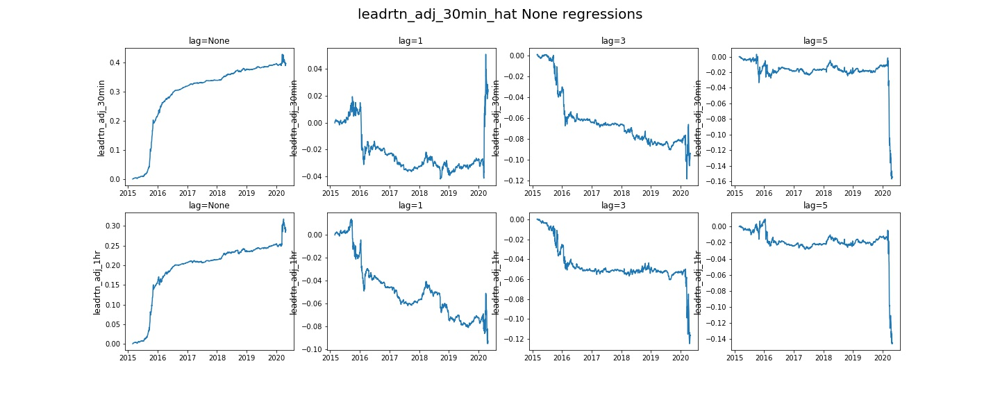

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.186124,0.862760,0.015186,2.306104e-04,45.498306,6.269065,0.458642,0.333938,0.321157,0.313236
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.186124,0.576971,0.010689,1.142621e-04,31.519733,3.798016,0.458642,0.333938,0.321157,0.313236
leadrtn_adj_30min,1.0,10178014,0.888224,-0.552247,-0.032413,-0.000646,4.172325e-07,-1.729361,-0.258458,0.467662,0.339279,0.325128,0.316289
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.552247,-0.226229,-0.004354,1.895428e-05,-12.723904,-2.000778,0.467662,0.339279,0.325128,0.316289
leadrtn_adj_30min,3.0,10178014,0.888119,-0.585293,-0.146120,-0.002686,7.212162e-06,-7.506819,-1.329425,0.468652,0.340202,0.325524,0.317111
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.585293,-0.227397,-0.004093,1.674891e-05,-11.764668,-1.691333,0.468652,0.340202,0.325524,0.317111
leadrtn_adj_30min,5.0,10178014,0.888011,-0.608809,-0.220695,-0.004664,2.175570e-05,-13.369888,-1.640631,0.468990,0.341035,0.326661,0.318049
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.608809,-0.265393,-0.005583,3.117323e-05,-16.094942,-1.662598,0.468990,0.341035,0.326661,0.318049


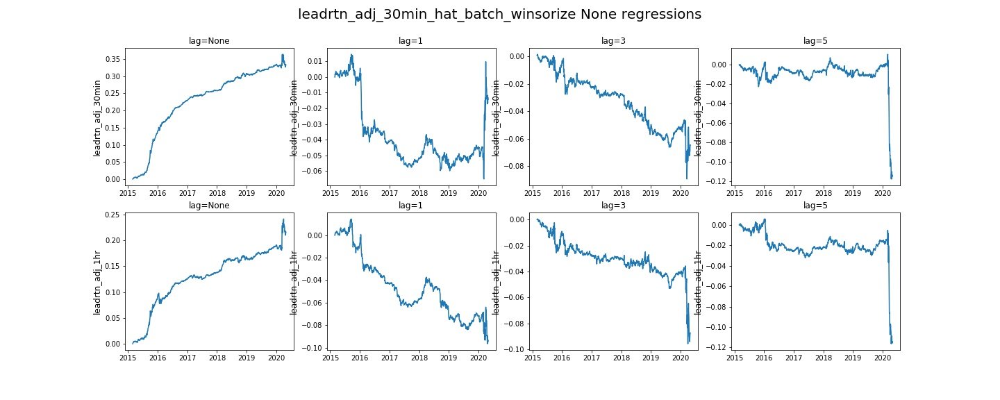

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.067785,0.780985,0.017801,0.000317,53.289143,5.163733,0.412254,0.189084,0.215518,0.204188
leadrtn_adj_1hr,NaN,10178014,0.888220,0.067785,0.579846,0.013657,0.000187,40.686417,3.557050,0.412254,0.189084,0.215518,0.204188
leadrtn_adj_30min,1.0,10178014,0.888224,-0.837746,0.052243,0.001221,0.000001,3.657437,0.382816,0.417710,0.192069,0.217527,0.204493
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.837746,-0.207799,-0.005033,0.000025,-15.027033,-1.810394,0.417710,0.192069,0.217527,0.204493
leadrtn_adj_30min,3.0,10178014,0.888119,-0.929471,-0.202943,-0.004522,0.000020,-13.019907,-1.830654,0.419716,0.192021,0.219311,0.206255
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.929471,-0.282416,-0.006315,0.000040,-18.624233,-2.102376,0.419716,0.192021,0.219311,0.206255
leadrtn_adj_30min,5.0,10178014,0.888011,-0.987841,-0.261633,-0.007279,0.000053,-21.488428,-1.967506,0.417968,0.192188,0.220078,0.207674
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.987841,-0.332943,-0.009226,0.000085,-27.335934,-2.127640,0.417968,0.192188,0.220078,0.207674


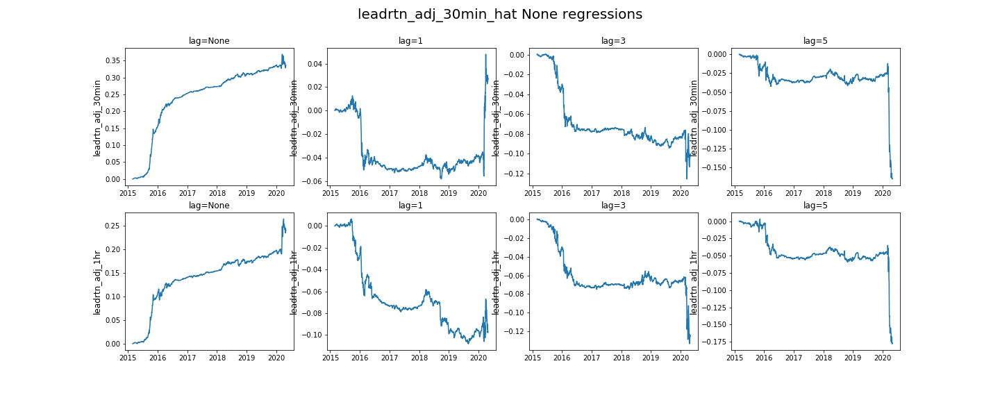

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.712529,0.759163,0.013648,1.862645e-04,40.752819,5.495476,0.421590,0.239402,0.252177,0.244484
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.712529,0.494613,0.009452,8.934736e-05,27.935768,3.427035,0.421590,0.239402,0.252177,0.244484
leadrtn_adj_30min,1.0,10178014,0.888224,-2.318708,-0.005876,-0.000345,-1.192093e-07,-0.333764,-0.048600,0.427328,0.243222,0.255292,0.246437
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.318708,-0.224742,-0.004475,2.002716e-05,-13.201057,-1.858268,0.427328,0.243222,0.255292,0.246437
leadrtn_adj_30min,3.0,10178014,0.888119,-2.477629,-0.141374,-0.002751,7.569790e-06,-7.543910,-1.263102,0.428479,0.243507,0.255773,0.247337
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.477629,-0.227986,-0.004271,1.823902e-05,-12.389212,-1.678430,0.428479,0.243507,0.255773,0.247337
leadrtn_adj_30min,5.0,10178014,0.888011,-2.580480,-0.227276,-0.004809,2.312660e-05,-13.878851,-1.672329,0.428329,0.244165,0.256727,0.248334
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.580480,-0.314576,-0.006601,4.357100e-05,-19.382551,-2.001245,0.428329,0.244165,0.256727,0.248334


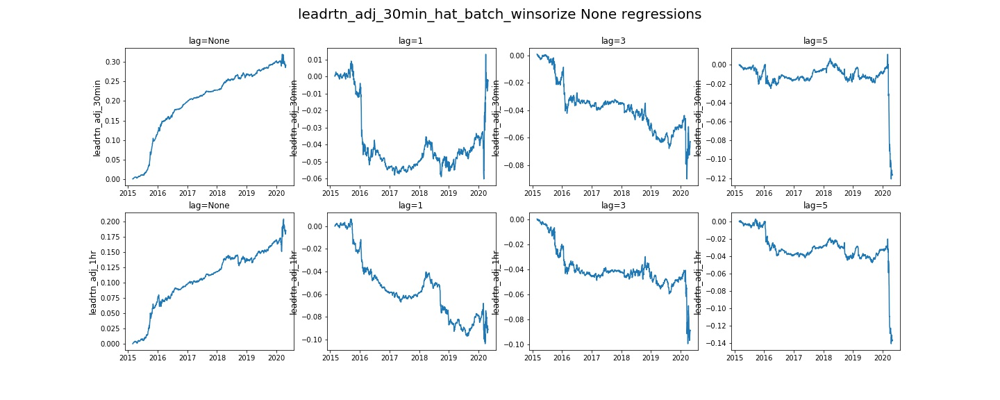

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.024236,0.786681,0.021040,4.426837e-04,63.100613,5.053592,0.425989,0.264124,0.268099,0.250315
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.024236,0.602701,0.016222,2.631545e-04,48.391907,3.545335,0.425989,0.264124,0.268099,0.250315
leadrtn_adj_30min,1.0,10178014,0.888224,-0.257103,0.032292,0.000846,7.152557e-07,2.531637,0.240762,0.434128,0.268947,0.271696,0.252139
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.257103,-0.198758,-0.005519,3.045797e-05,-16.211657,-1.737206,0.434128,0.268947,0.271696,0.252139
leadrtn_adj_30min,3.0,10178014,0.888119,-0.277833,-0.193725,-0.004877,2.378225e-05,-14.401805,-1.783927,0.436795,0.269102,0.273675,0.253601
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.277833,-0.303172,-0.007824,6.121397e-05,-23.102030,-2.237313,0.436795,0.269102,0.273675,0.253601
leadrtn_adj_30min,5.0,10178014,0.888011,-0.292746,-0.287954,-0.009203,8.469820e-05,-27.399784,-2.094383,0.434242,0.269076,0.274046,0.255010
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.292746,-0.325562,-0.010464,1.094937e-04,-31.078144,-1.996122,0.434242,0.269076,0.274046,0.255010


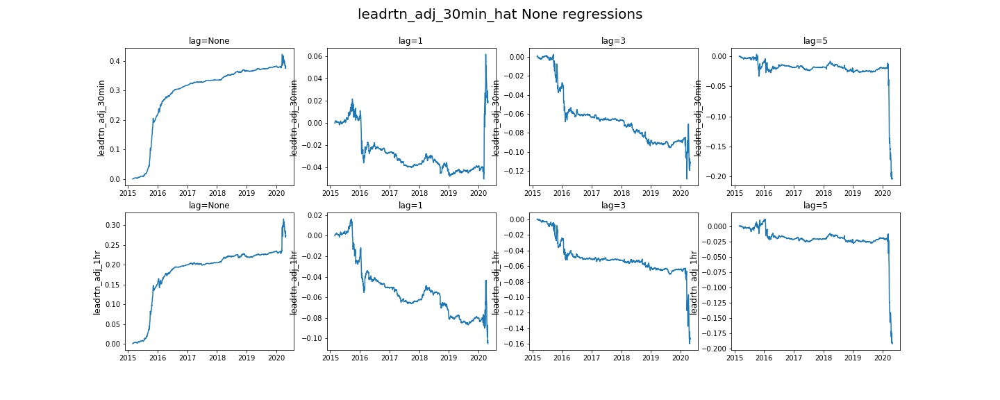

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.226664,0.879774,0.016483,0.000272,49.313274,6.440161,0.440284,0.321197,0.305830,0.293556
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.226664,0.590927,0.011593,0.000134,34.323837,3.650051,0.440284,0.321197,0.305830,0.293556
leadrtn_adj_30min,1.0,10178014,0.888224,-0.653536,-0.039912,-0.001036,0.000001,-2.280668,-0.305627,0.450329,0.327457,0.310541,0.297299
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.653536,-0.214995,-0.004401,0.000019,-12.786997,-1.929090,0.450329,0.327457,0.310541,0.297299
leadrtn_adj_30min,3.0,10178014,0.888119,-0.691328,-0.195563,-0.003638,0.000013,-10.569139,-1.770727,0.451388,0.328497,0.310980,0.298133
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.691328,-0.293088,-0.005443,0.000030,-15.838790,-2.196185,0.451388,0.328497,0.310980,0.298133
leadrtn_adj_30min,5.0,10178014,0.888011,-0.718849,-0.258513,-0.005824,0.000034,-17.017048,-1.896287,0.451802,0.329504,0.312279,0.299173
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.718849,-0.306679,-0.006871,0.000047,-20.089710,-1.874940,0.451802,0.329504,0.312279,0.299173


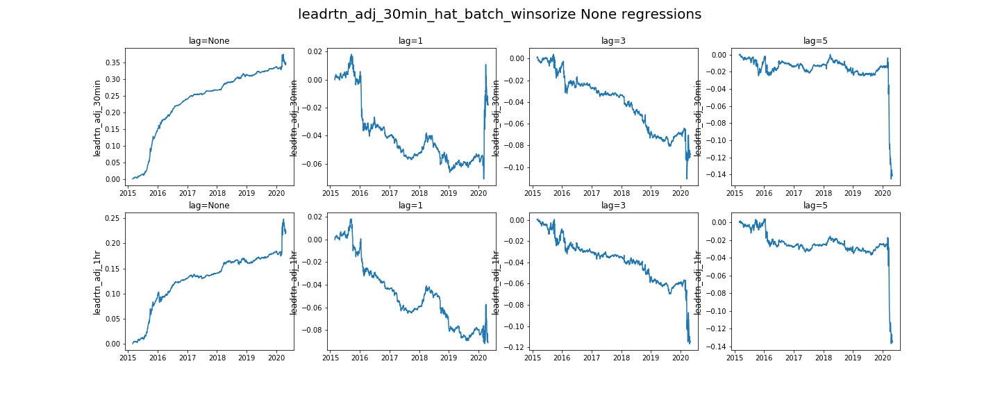

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.007685,0.582488,0.016052,0.000258,48.037933,2.794627,0.334658,0.258619,0.245037,0.234644
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.007685,0.473974,0.013141,0.000173,39.051792,2.316570,0.334658,0.258619,0.245037,0.234644
leadrtn_adj_30min,1.0,10178014,0.888224,-0.043604,0.035826,0.001092,0.000001,2.897203,0.281727,0.342592,0.262236,0.247865,0.236353
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.043604,-0.135753,-0.004004,0.000016,-11.745609,-1.150499,0.342592,0.262236,0.247865,0.236353
leadrtn_adj_30min,3.0,10178014,0.888119,-0.046620,-0.133468,-0.003478,0.000012,-10.171876,-1.120439,0.343695,0.262915,0.248672,0.236907
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.046620,-0.298046,-0.007888,0.000062,-23.349724,-1.872745,0.343695,0.262915,0.248672,0.236907
leadrtn_adj_30min,5.0,10178014,0.888011,-0.049032,-0.343803,-0.011698,0.000137,-34.885941,-2.205994,0.341176,0.262423,0.249498,0.236570
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.049032,-0.350800,-0.011825,0.000140,-35.181667,-1.881387,0.341176,0.262423,0.249498,0.236570


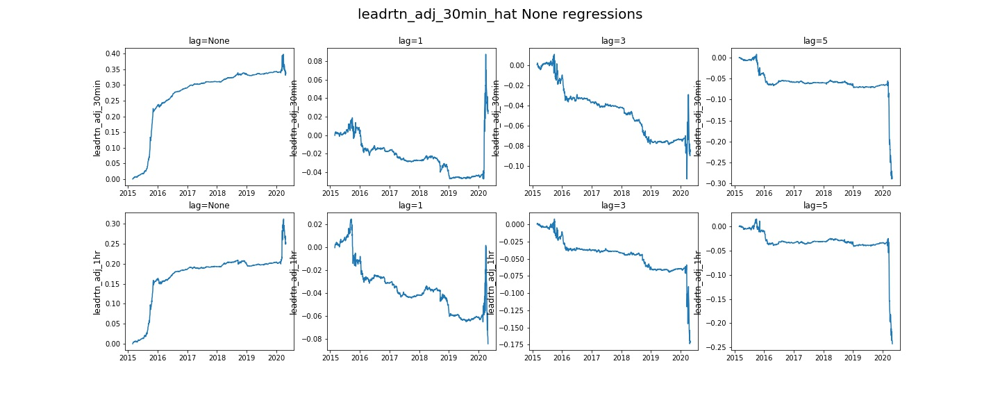

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.057328,0.721524,0.013862,1.921654e-04,41.353035,5.337177,0.506526,0.435849,0.399164,0.383702
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.057328,0.504017,0.010034,1.006722e-04,29.601311,3.003425,0.506526,0.435849,0.399164,0.383702
leadrtn_adj_30min,1.0,10178014,0.888224,-0.157963,-0.038847,-0.000913,8.344650e-07,-2.228550,-0.303839,0.521518,0.442882,0.404703,0.388820
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.157963,-0.173293,-0.003613,1.305342e-05,-10.535995,-1.496927,0.521518,0.442882,0.404703,0.388820
leadrtn_adj_30min,3.0,10178014,0.888119,-0.167117,-0.228151,-0.004158,1.728535e-05,-12.069455,-2.008292,0.522027,0.445128,0.405188,0.389417
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.167117,-0.347907,-0.006348,4.029274e-05,-18.401848,-2.430434,0.522027,0.445128,0.405188,0.389417
leadrtn_adj_30min,5.0,10178014,0.888011,-0.173670,-0.307193,-0.007042,4.959106e-05,-20.829611,-2.236416,0.522919,0.446032,0.406562,0.389839
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.173670,-0.327790,-0.007584,5.751848e-05,-22.071730,-1.933150,0.522919,0.446032,0.406562,0.389839


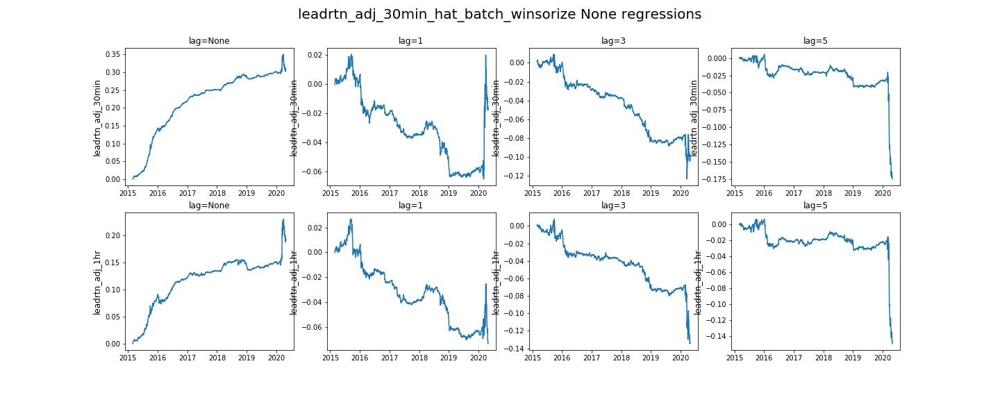

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.010305,0.917127,0.021185,0.000449,63.521496,5.717100,0.426321,0.261990,0.266325,0.254349
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.010305,0.671161,0.015676,0.000246,46.671169,4.050202,0.426321,0.261990,0.266325,0.254349
leadrtn_adj_30min,1.0,10178014,0.888224,-0.234039,0.005046,0.000000,0.000000,0.343508,0.040260,0.435059,0.267012,0.269908,0.256055
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.234039,-0.225272,-0.005486,0.000030,-16.065512,-1.973805,0.435059,0.267012,0.269908,0.256055
leadrtn_adj_30min,3.0,10178014,0.888119,-0.254468,-0.196469,-0.004381,0.000019,-12.750082,-1.768816,0.437868,0.267351,0.271867,0.257632
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.254468,-0.279898,-0.006338,0.000040,-18.485516,-2.092492,0.437868,0.267351,0.271867,0.257632
leadrtn_adj_30min,5.0,10178014,0.888011,-0.269299,-0.261992,-0.007021,0.000049,-20.668278,-1.930776,0.435295,0.267382,0.272550,0.259023
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.269299,-0.292324,-0.007862,0.000062,-23.047110,-1.849403,0.435295,0.267382,0.272550,0.259023


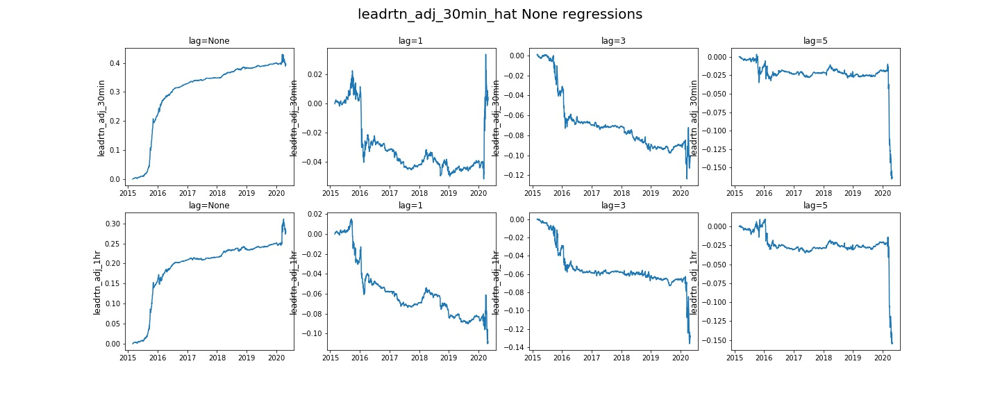

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.206956,0.877514,0.015654,0.000245,46.877872,6.414108,0.451525,0.337596,0.321445,0.312824
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.206956,0.575806,0.010764,0.000116,31.771259,3.822577,0.451525,0.337596,0.321445,0.312824
leadrtn_adj_30min,1.0,10178014,0.888224,-0.594028,-0.053370,-0.001171,0.000001,-2.888925,-0.433752,0.461618,0.343515,0.325804,0.316267
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.594028,-0.229616,-0.004488,0.000020,-13.032822,-2.041077,0.461618,0.343515,0.325804,0.316267
leadrtn_adj_30min,3.0,10178014,0.888119,-0.628545,-0.166417,-0.003098,0.000010,-8.575604,-1.502013,0.462692,0.344543,0.326231,0.317076
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.628545,-0.257955,-0.004626,0.000021,-13.323649,-1.927848,0.462692,0.344543,0.326231,0.317076
leadrtn_adj_30min,5.0,10178014,0.888011,-0.654172,-0.232679,-0.004877,0.000024,-14.144549,-1.719972,0.462992,0.345423,0.327438,0.318065
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.654172,-0.273639,-0.005767,0.000033,-16.613171,-1.708537,0.462992,0.345423,0.327438,0.318065


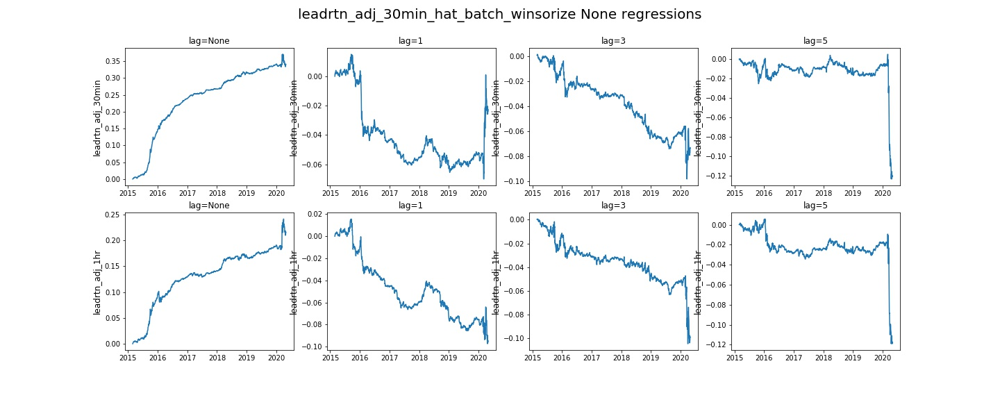

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.047150,0.774377,0.017683,0.000313,52.924568,5.105593,0.410654,0.182943,0.212001,0.201527
leadrtn_adj_1hr,NaN,10178014,0.888220,0.047150,0.581819,0.013735,0.000189,40.939800,3.568646,0.410654,0.182943,0.212001,0.201527
leadrtn_adj_30min,1.0,10178014,0.888224,-0.900405,0.062173,0.001465,0.000002,4.359860,0.452423,0.415802,0.185757,0.213948,0.201809
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.900405,-0.199298,-0.004852,0.000024,-14.447412,-1.740725,0.415802,0.185757,0.213948,0.201809
leadrtn_adj_30min,3.0,10178014,0.888119,-0.996065,-0.196647,-0.004388,0.000019,-12.645367,-1.782767,0.417707,0.185682,0.215638,0.203479
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.996065,-0.274905,-0.006167,0.000038,-18.191557,-2.048682,0.417707,0.185682,0.215638,0.203479
leadrtn_adj_30min,5.0,10178014,0.888011,-1.056206,-0.258092,-0.007251,0.000053,-21.305548,-1.952255,0.416049,0.185863,0.216378,0.204825
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.056206,-0.327103,-0.009119,0.000083,-26.989624,-2.103339,0.416049,0.185863,0.216378,0.204825


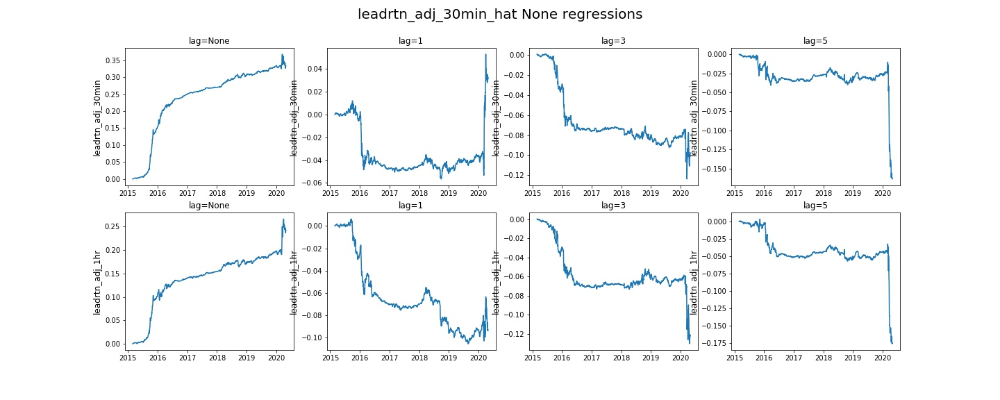

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.744464,0.753497,0.013516,1.826882e-04,40.320602,5.441545,0.420507,0.233532,0.247832,0.240158
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.744464,0.491631,0.009335,8.714199e-05,27.663074,3.415390,0.420507,0.233532,0.247832,0.240158
leadrtn_adj_30min,1.0,10178014,0.888224,-2.406706,-0.003671,-0.000345,-1.192093e-07,-0.207615,-0.030404,0.426019,0.237225,0.250874,0.242041
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.406706,-0.222393,-0.004435,1.966953e-05,-13.005988,-1.830332,0.426019,0.237225,0.250874,0.242041
leadrtn_adj_30min,3.0,10178014,0.888119,-2.572009,-0.139672,-0.002697,7.271767e-06,-7.414202,-1.251834,0.427116,0.237473,0.251311,0.242885
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.572009,-0.222554,-0.004122,1.698732e-05,-12.036455,-1.644736,0.427116,0.237473,0.251311,0.242885
leadrtn_adj_30min,5.0,10178014,0.888011,-2.676526,-0.225973,-0.004772,2.276897e-05,-13.723088,-1.671511,0.426982,0.238080,0.252249,0.243841
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.676526,-0.311669,-0.006524,4.255772e-05,-19.109581,-2.000154,0.426982,0.238080,0.252249,0.243841


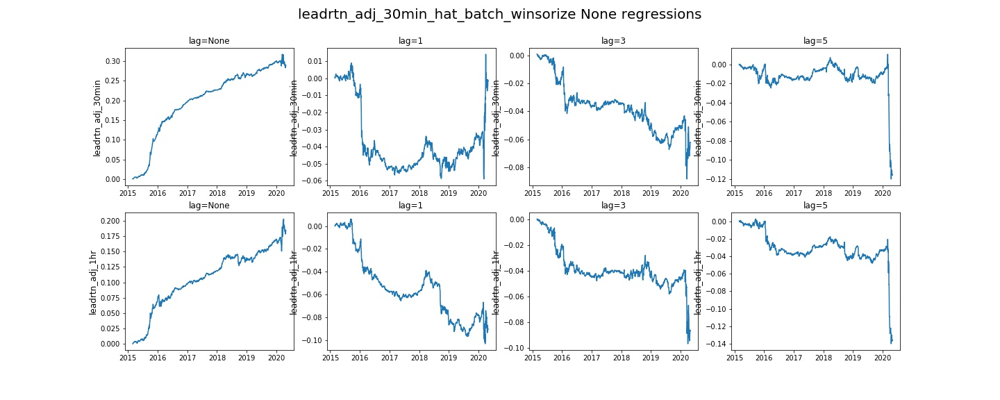

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.021285,0.775301,0.020563,0.000423,61.661400,5.048570,0.427761,0.265020,0.267523,0.253514
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.021285,0.613247,0.016377,0.000268,48.831253,3.601312,0.427761,0.265020,0.267523,0.253514
leadrtn_adj_30min,1.0,10178014,0.888224,-0.257359,0.059577,0.001726,0.000003,4.601614,0.430274,0.435426,0.269698,0.270965,0.255395
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.257359,-0.184880,-0.005051,0.000026,-14.896503,-1.639926,0.435426,0.269698,0.270965,0.255395
leadrtn_adj_30min,3.0,10178014,0.888119,-0.278812,-0.181921,-0.004561,0.000021,-13.384855,-1.672845,0.437720,0.269863,0.272654,0.256654
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.278812,-0.287803,-0.007405,0.000055,-21.794043,-2.097347,0.437720,0.269863,0.272654,0.256654
leadrtn_adj_30min,5.0,10178014,0.888011,-0.293717,-0.283485,-0.009086,0.000083,-27.059608,-2.059687,0.435558,0.269965,0.273077,0.257823
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.293717,-0.318702,-0.010251,0.000105,-30.389845,-1.946437,0.435558,0.269965,0.273077,0.257823


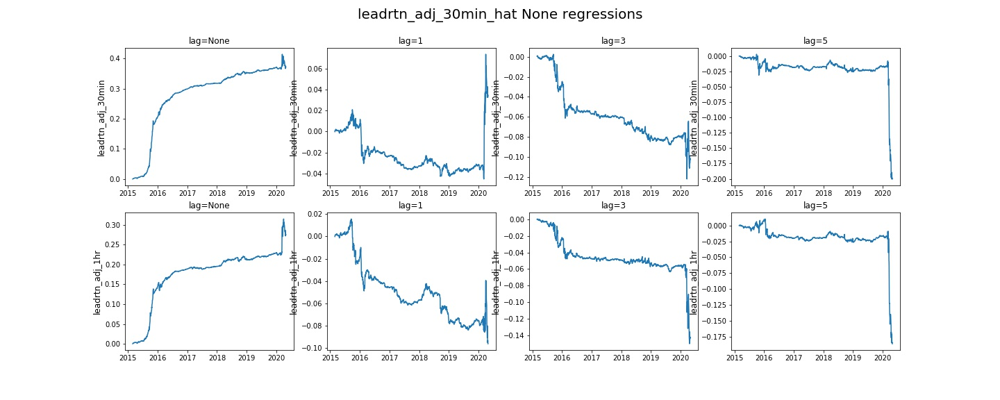

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.212004,0.864853,0.015952,2.544522e-04,47.825859,6.278251,0.448003,0.318526,0.305118,0.293541
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.212004,0.591715,0.011464,1.314282e-04,33.938427,3.646240,0.448003,0.318526,0.305118,0.293541
leadrtn_adj_30min,1.0,10178014,0.888224,-0.616488,-0.021206,-0.000345,1.192093e-07,-1.195046,-0.162185,0.457182,0.324337,0.309458,0.296965
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.616488,-0.210635,-0.004229,1.788139e-05,-12.428123,-1.879778,0.457182,0.324337,0.309458,0.296965
leadrtn_adj_30min,3.0,10178014,0.888119,-0.652947,-0.176219,-0.003266,1.066923e-05,-9.501402,-1.609085,0.458162,0.325299,0.309952,0.297826
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.652947,-0.268900,-0.005003,2.503395e-05,-14.518270,-1.996719,0.458162,0.325299,0.309952,0.297826
leadrtn_adj_30min,5.0,10178014,0.888011,-0.678693,-0.251521,-0.005605,3.141165e-05,-16.480875,-1.843050,0.458614,0.326282,0.311131,0.298741
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.678693,-0.299378,-0.006717,4.512072e-05,-19.572664,-1.824670,0.458614,0.326282,0.311131,0.298741


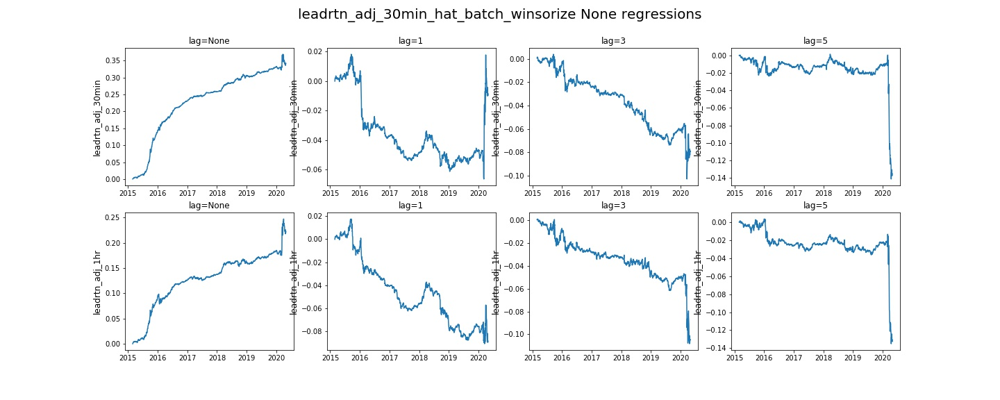

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.009943,0.569668,0.018707,0.000350,55.985302,3.604192,0.454511,0.357185,0.334369,0.315616
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.009943,0.480797,0.015654,0.000245,46.670227,2.928360,0.454511,0.357185,0.334369,0.315616
leadrtn_adj_30min,1.0,10178014,0.888224,-0.066122,0.055479,0.001998,0.000004,5.288021,0.449270,0.465604,0.363205,0.339187,0.318721
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.066122,-0.136069,-0.004772,0.000023,-13.891677,-1.232436,0.465604,0.363205,0.339187,0.318721
leadrtn_adj_30min,3.0,10178014,0.888119,-0.070774,-0.136875,-0.004193,0.000018,-12.287950,-1.245757,0.468091,0.364317,0.340580,0.319875
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.070774,-0.284906,-0.008883,0.000079,-26.232374,-2.187256,0.468091,0.364317,0.340580,0.319875
leadrtn_adj_30min,5.0,10178014,0.888011,-0.074411,-0.315629,-0.012789,0.000164,-38.095531,-2.389670,0.465350,0.364177,0.341121,0.319647
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.074411,-0.316270,-0.012752,0.000163,-37.867733,-1.957228,0.465350,0.364177,0.341121,0.319647


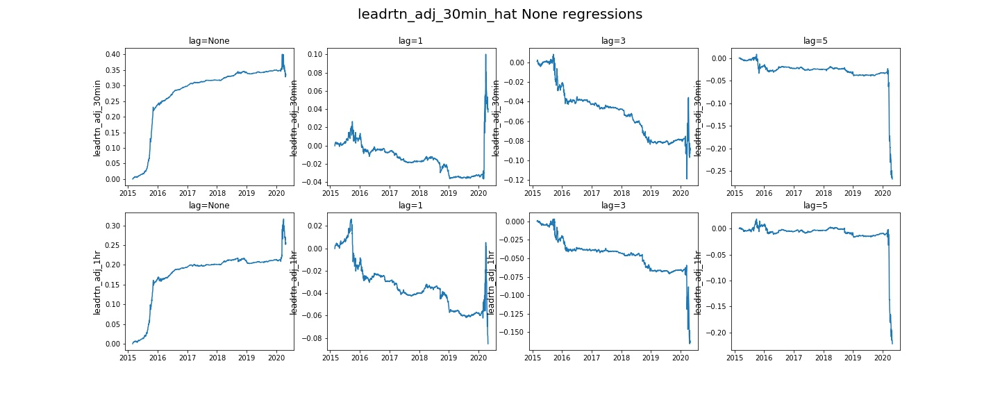

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.059572,0.761636,0.014871,2.211332e-04,44.376953,5.615901,0.500839,0.427347,0.388784,0.372097
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.059572,0.539544,0.010844,1.176000e-04,32.050259,3.249679,0.500839,0.427347,0.388784,0.372097
leadrtn_adj_30min,1.0,10178014,0.888224,-0.173336,-0.038477,-0.000846,7.152557e-07,-2.221312,-0.306732,0.516109,0.435164,0.394807,0.377478
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.173336,-0.152112,-0.003183,1.013279e-05,-9.300969,-1.328374,0.516109,0.435164,0.394807,0.377478
leadrtn_adj_30min,3.0,10178014,0.888119,-0.183179,-0.222357,-0.004107,1.686811e-05,-11.948724,-1.971261,0.516756,0.437359,0.395205,0.378170
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.183179,-0.321810,-0.005950,3.540516e-05,-17.244995,-2.278348,0.516756,0.437359,0.395205,0.378170
leadrtn_adj_30min,5.0,10178014,0.888011,-0.190215,-0.291241,-0.006704,4.494190e-05,-19.848516,-2.147471,0.517645,0.438208,0.396570,0.378394
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.190215,-0.296984,-0.006918,4.786253e-05,-20.073845,-1.791042,0.517645,0.438208,0.396570,0.378394


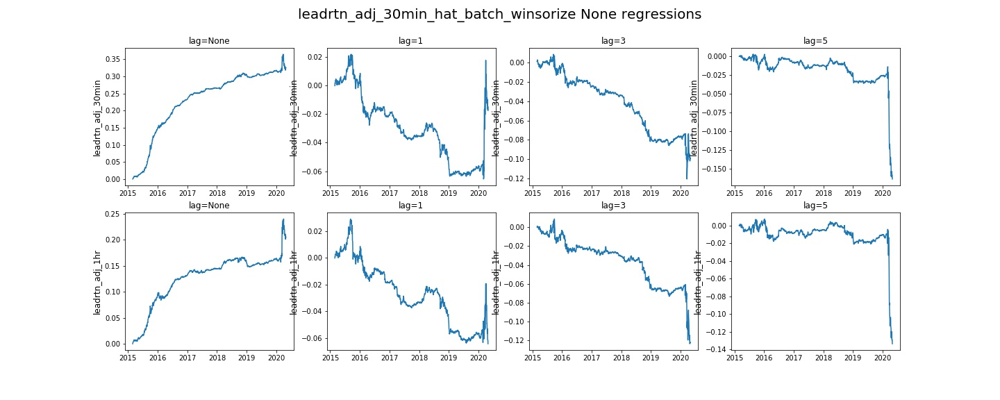

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.013013,0.485710,0.018875,0.000356,56.479153,3.413864,0.457080,0.357506,0.329662,0.308332
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.013013,0.460010,0.017597,0.000310,52.556686,2.819633,0.457080,0.357506,0.329662,0.308332
leadrtn_adj_30min,1.0,10178014,0.888224,-0.063813,0.108170,0.004078,0.000017,12.007522,0.785384,0.467565,0.363269,0.334075,0.311127
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.063813,-0.077446,-0.003049,0.000009,-8.920923,-0.736374,0.467565,0.363269,0.334075,0.311127
leadrtn_adj_30min,3.0,10178014,0.888119,-0.067916,-0.127687,-0.004428,0.000020,-13.017359,-1.236811,0.470059,0.364668,0.335671,0.312284
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.067916,-0.287760,-0.010146,0.000103,-30.059120,-2.245374,0.470059,0.364668,0.335671,0.312284
leadrtn_adj_30min,5.0,10178014,0.888011,-0.070883,-0.316892,-0.015657,0.000245,-46.732433,-2.410921,0.467776,0.364663,0.336357,0.312208
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.070883,-0.331132,-0.016106,0.000259,-48.032696,-2.002558,0.467776,0.364663,0.336357,0.312208


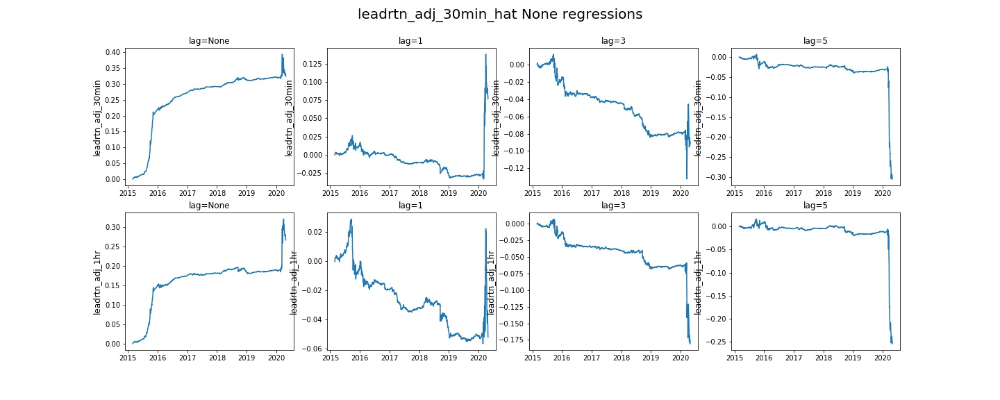

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.053774,0.762723,0.015644,2.447367e-04,46.651108,5.592308,0.507026,0.426233,0.384892,0.362652
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.053774,0.579424,0.012173,1.481771e-04,36.068985,3.188766,0.507026,0.426233,0.384892,0.362652
leadrtn_adj_30min,1.0,10178014,0.888224,-0.158059,0.015700,0.000345,1.192093e-07,0.932715,0.112210,0.521715,0.433942,0.390679,0.367905
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.158059,-0.100457,-0.002100,4.410744e-06,-6.315962,-0.886111,0.521715,0.433942,0.390679,0.367905
leadrtn_adj_30min,3.0,10178014,0.888119,-0.167055,-0.208460,-0.004100,1.680851e-05,-11.857125,-1.893344,0.522317,0.435929,0.391147,0.368606
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.167055,-0.308046,-0.006020,3.623962e-05,-17.487463,-2.316181,0.522317,0.435929,0.391147,0.368606
leadrtn_adj_30min,5.0,10178014,0.888011,-0.173369,-0.262569,-0.006596,4.351139e-05,-19.372200,-1.986604,0.523175,0.436702,0.392357,0.368751
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.173369,-0.285851,-0.007029,4.941225e-05,-20.510412,-1.746721,0.523175,0.436702,0.392357,0.368751


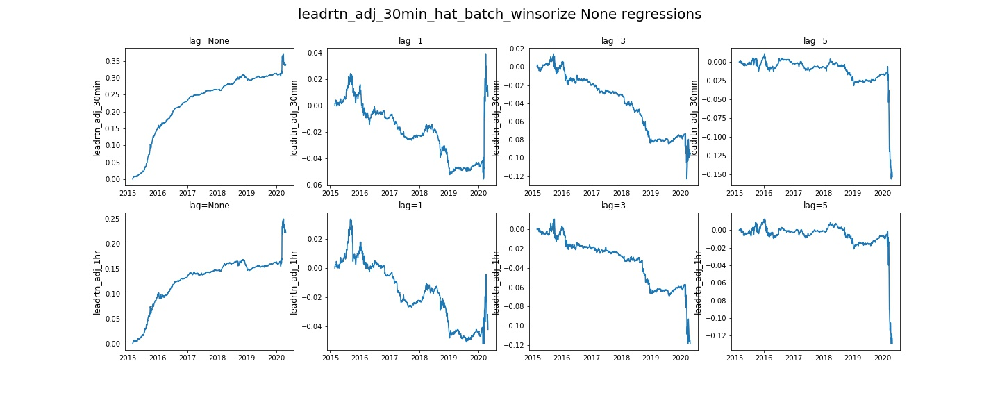

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.007857,0.933049,0.021455,4.603267e-04,64.332542,5.755449,0.425832,0.252717,0.267357,0.257086
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.007857,0.707376,0.016481,2.716184e-04,49.077225,4.226466,0.425832,0.252717,0.267357,0.257086
leadrtn_adj_30min,1.0,10178014,0.888224,-0.234864,0.039660,0.000977,9.536743e-07,2.665915,0.309452,0.433841,0.257203,0.270809,0.258532
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.234864,-0.197579,-0.004734,2.241135e-05,-13.996401,-1.756988,0.433841,0.257203,0.270809,0.258532
leadrtn_adj_30min,3.0,10178014,0.888119,-0.255630,-0.185830,-0.004172,1.740456e-05,-12.112397,-1.682950,0.436340,0.257414,0.272505,0.260032
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.255630,-0.261449,-0.005895,3.474951e-05,-17.303181,-1.949133,0.436340,0.257414,0.272505,0.260032
leadrtn_adj_30min,5.0,10178014,0.888011,-0.270302,-0.250761,-0.006761,4.571676e-05,-19.861685,-1.853605,0.434167,0.257608,0.273278,0.261362
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.270302,-0.277514,-0.007481,5.596876e-05,-21.938412,-1.760673,0.434167,0.257608,0.273278,0.261362


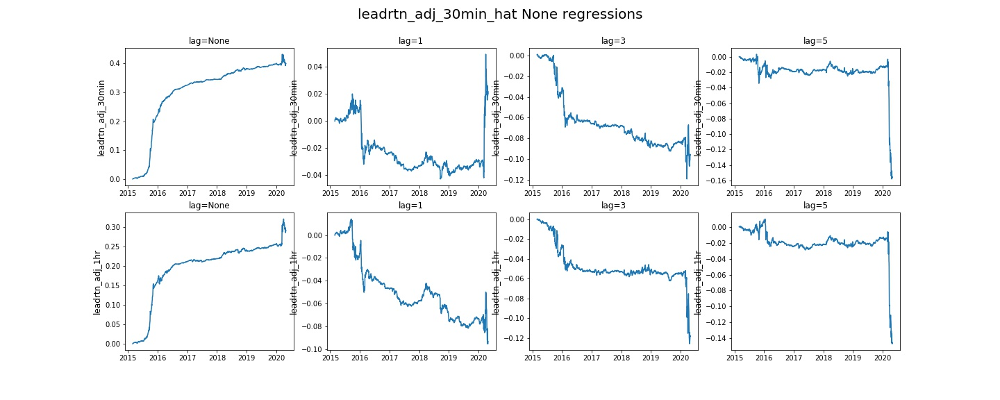

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.195053,0.870201,0.015358,2.358556e-04,46.010868,6.310188,0.459424,0.335501,0.322839,0.314677
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.195053,0.578781,0.010742,1.153946e-04,31.693872,3.789207,0.459424,0.335501,0.322839,0.314677
leadrtn_adj_30min,1.0,10178014,0.888224,-0.574818,-0.037922,-0.000772,5.960464e-07,-2.031912,-0.303380,0.468633,0.340861,0.326874,0.317791
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.574818,-0.228262,-0.004401,1.937151e-05,-12.869935,-2.012816,0.468633,0.340861,0.326874,0.317791
leadrtn_adj_30min,3.0,10178014,0.888119,-0.609052,-0.150427,-0.002751,7.569790e-06,-7.722668,-1.368111,0.469622,0.341817,0.327256,0.318597
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.609052,-0.232988,-0.004165,1.734495e-05,-12.042984,-1.729708,0.469622,0.341817,0.327256,0.318597
leadrtn_adj_30min,5.0,10178014,0.888011,-0.633528,-0.223929,-0.004709,2.217293e-05,-13.576474,-1.666210,0.469957,0.342659,0.328424,0.319547
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.633528,-0.268870,-0.005673,3.218651e-05,-16.325264,-1.681855,0.469957,0.342659,0.328424,0.319547


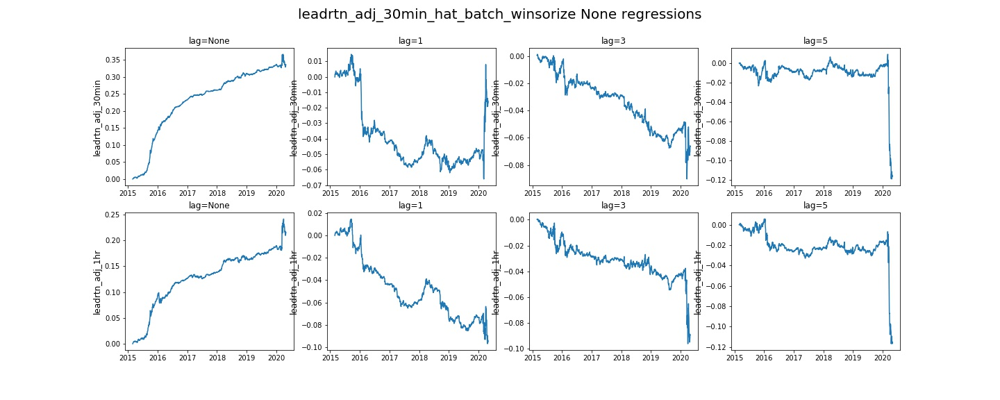

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.009426,0.908191,0.020879,4.359484e-04,62.600441,5.687746,0.434258,0.269978,0.273098,0.263384
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.009426,0.682791,0.015869,2.518296e-04,47.251686,4.095907,0.434258,0.269978,0.273098,0.263384
leadrtn_adj_30min,1.0,10178014,0.888224,-0.237249,0.030378,0.000598,3.576279e-07,2.045277,0.235892,0.442577,0.274798,0.276531,0.265148
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.237249,-0.210516,-0.005063,2.563000e-05,-14.895339,-1.854772,0.442577,0.274798,0.276531,0.265148
leadrtn_adj_30min,3.0,10178014,0.888119,-0.258389,-0.185268,-0.004129,1.704693e-05,-11.958521,-1.667079,0.445058,0.275120,0.278220,0.266497
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.258389,-0.266339,-0.005990,3.588200e-05,-17.570820,-1.963285,0.445058,0.275120,0.278220,0.266497
leadrtn_adj_30min,5.0,10178014,0.888011,-0.273301,-0.260019,-0.006974,4.863739e-05,-20.626907,-1.921327,0.442769,0.275214,0.278920,0.267674
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.273301,-0.287475,-0.007747,6.002188e-05,-22.727289,-1.816088,0.442769,0.275214,0.278920,0.267674


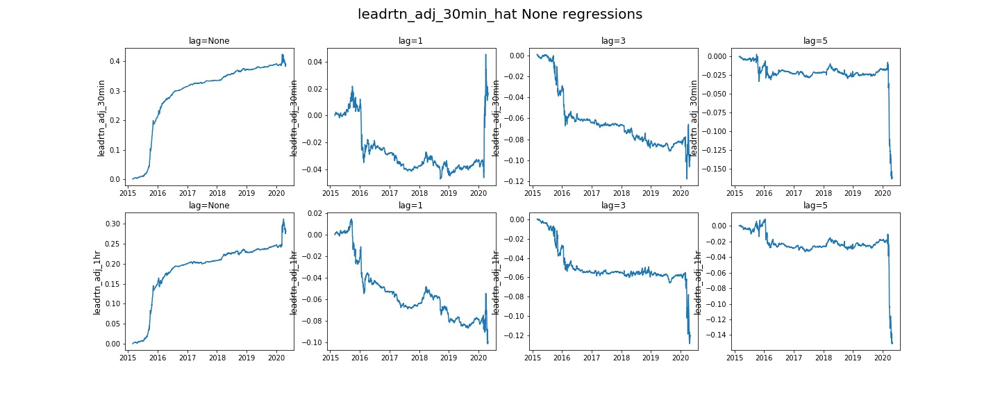

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.199856,0.873539,0.015392,2.369285e-04,46.094498,6.335220,0.462506,0.339872,0.325789,0.317556
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.199856,0.580373,0.010748,1.155138e-04,31.710752,3.796411,0.462506,0.339872,0.325789,0.317556
leadrtn_adj_30min,1.0,10178014,0.888224,-0.576991,-0.039385,-0.000810,6.556511e-07,-2.105805,-0.316620,0.471868,0.345313,0.329808,0.320702
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.576991,-0.226660,-0.004367,1.907349e-05,-12.738172,-1.994790,0.471868,0.345313,0.329808,0.320702
leadrtn_adj_30min,3.0,10178014,0.888119,-0.611162,-0.153915,-0.002826,7.987022e-06,-7.882152,-1.399968,0.472851,0.346296,0.330269,0.321510
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.611162,-0.238191,-0.004278,1.829863e-05,-12.280905,-1.758860,0.472851,0.346296,0.330269,0.321510
leadrtn_adj_30min,5.0,10178014,0.888011,-0.635704,-0.227136,-0.004778,2.282858e-05,-13.746729,-1.692023,0.473206,0.347161,0.331394,0.322425
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.635704,-0.269113,-0.005673,3.218651e-05,-16.311329,-1.684251,0.473206,0.347161,0.331394,0.322425


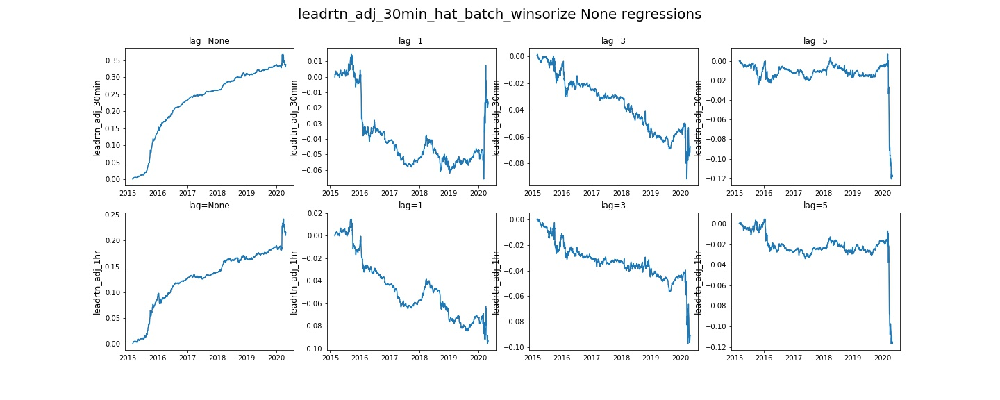

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.008602,0.462814,0.014855,0.000221,44.365185,2.365239,0.315946,0.245748,0.231080,0.215573
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.008602,0.408681,0.013175,0.000174,39.281338,1.929633,0.315946,0.245748,0.231080,0.215573
leadrtn_adj_30min,1.0,10178014,0.888224,-0.035262,0.069518,0.002251,0.000005,6.509991,0.481069,0.322019,0.248603,0.233100,0.216620
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.035262,-0.097261,-0.003257,0.000011,-9.507523,-0.823412,0.322019,0.248603,0.233100,0.216620
leadrtn_adj_30min,3.0,10178014,0.888119,-0.037320,-0.127591,-0.003751,0.000014,-11.145846,-1.097330,0.323010,0.249112,0.234052,0.217143
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.037320,-0.313209,-0.009471,0.000090,-28.163790,-1.854875,0.323010,0.249112,0.234052,0.217143
leadrtn_adj_30min,5.0,10178014,0.888011,-0.039019,-0.347173,-0.014001,0.000196,-41.849464,-2.118654,0.320654,0.248538,0.234639,0.216958
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.039019,-0.372682,-0.014933,0.000223,-44.579716,-1.875480,0.320654,0.248538,0.234639,0.216958


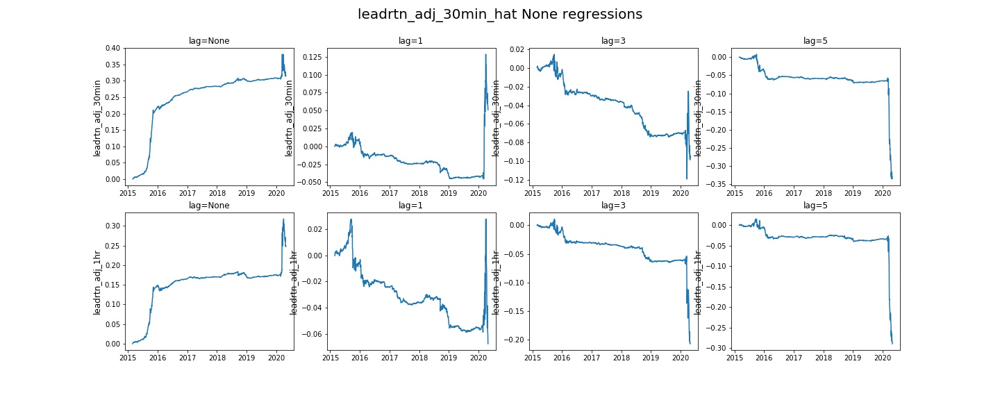

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.059380,0.727962,0.015091,2.277493e-04,44.973598,5.310349,0.503163,0.432401,0.394119,0.372499
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.059380,0.528146,0.011246,1.264811e-04,33.295628,2.835143,0.503163,0.432401,0.394119,0.372499
leadrtn_adj_30min,1.0,10178014,0.888224,-0.157090,-0.016471,-0.000488,-2.384186e-07,-0.995656,-0.114686,0.517815,0.439369,0.399777,0.377672
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.157090,-0.140817,-0.003010,9.059906e-06,-8.988955,-1.218278,0.517815,0.439369,0.399777,0.377672
leadrtn_adj_30min,3.0,10178014,0.888119,-0.165770,-0.242047,-0.004606,2.121925e-05,-13.770587,-2.153005,0.518378,0.441525,0.400152,0.378166
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.165770,-0.363262,-0.007118,5.066395e-05,-20.675896,-2.688038,0.518378,0.441525,0.400152,0.378166
leadrtn_adj_30min,5.0,10178014,0.888011,-0.172056,-0.294889,-0.007505,5.632639e-05,-22.252125,-2.235415,0.519247,0.442585,0.401606,0.378606
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.172056,-0.323778,-0.008116,6.586313e-05,-23.777775,-1.962327,0.519247,0.442585,0.401606,0.378606


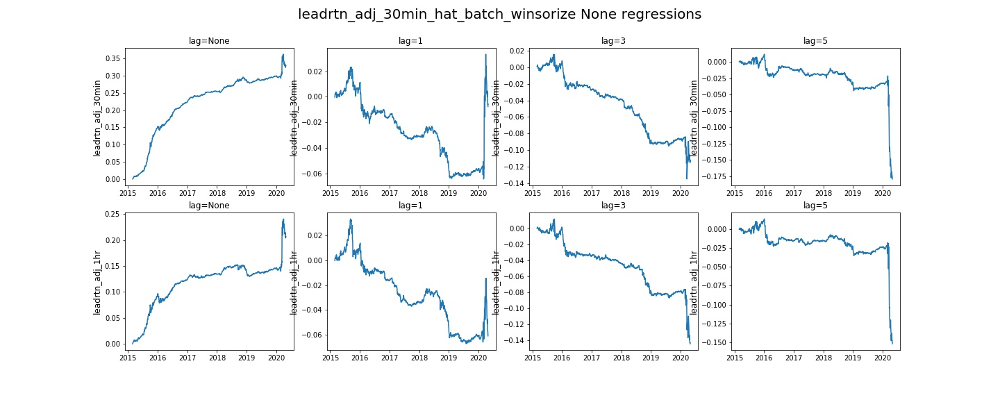

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.013860,0.725533,0.018260,0.000333,54.676579,4.863267,0.406990,0.182206,0.213320,0.199262
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.013860,0.564472,0.014593,0.000213,43.544403,3.331409,0.406990,0.182206,0.213320,0.199262
leadrtn_adj_30min,1.0,10178014,0.888224,-1.025136,0.074583,0.002156,0.000005,5.731329,0.512881,0.412156,0.185074,0.215367,0.199590
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.025136,-0.183945,-0.004919,0.000024,-14.544969,-1.597195,0.412156,0.185074,0.215367,0.199590
leadrtn_adj_30min,3.0,10178014,0.888119,-1.124262,-0.217080,-0.005276,0.000028,-15.308813,-2.002755,0.414108,0.184959,0.217183,0.201284
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.124262,-0.312833,-0.007713,0.000059,-22.794340,-2.302349,0.414108,0.184959,0.217183,0.201284
leadrtn_adj_30min,5.0,10178014,0.888011,-1.187544,-0.273650,-0.008683,0.000075,-25.730713,-2.045024,0.412367,0.185211,0.217864,0.202867
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.187544,-0.347256,-0.010951,0.000120,-32.652153,-2.175927,0.412367,0.185211,0.217864,0.202867


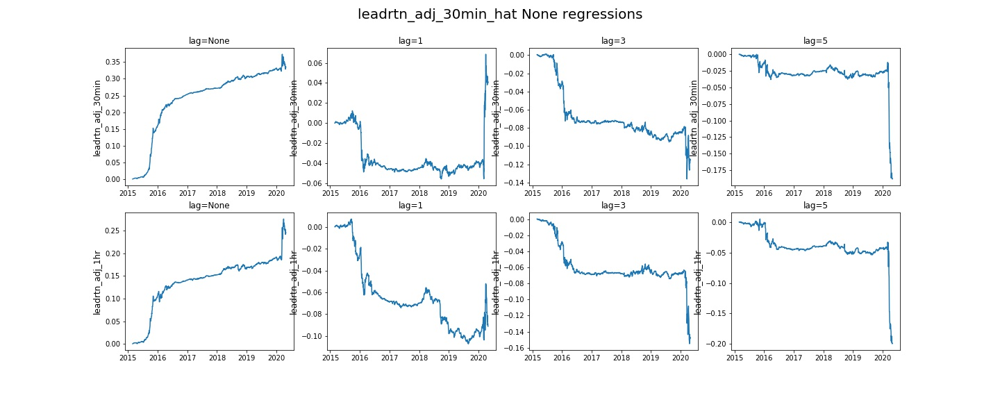

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.838854,0.761546,0.014084,1.983643e-04,42.062168,5.545890,0.413148,0.227370,0.242307,0.232342
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.838854,0.495285,0.009766,9.536743e-05,28.918427,3.244400,0.413148,0.227370,0.242307,0.232342
leadrtn_adj_30min,1.0,10178014,0.888224,-2.662815,-0.008411,-0.000598,-3.576279e-07,-0.492948,-0.065902,0.418725,0.231325,0.245563,0.234494
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.662815,-0.222362,-0.004613,2.127886e-05,-13.513209,-1.836825,0.418725,0.231325,0.245563,0.234494
leadrtn_adj_30min,3.0,10178014,0.888119,-2.840893,-0.173342,-0.003444,1.186132e-05,-9.611166,-1.561606,0.419895,0.231671,0.246064,0.235364
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.840893,-0.281447,-0.005454,2.974272e-05,-15.872564,-2.081004,0.419895,0.231671,0.246064,0.235364
leadrtn_adj_30min,5.0,10178014,0.888011,-2.956143,-0.259938,-0.005705,3.254414e-05,-16.796532,-1.862802,0.419821,0.232440,0.247092,0.236470
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.956143,-0.353433,-0.007843,6.151199e-05,-23.143389,-2.153517,0.419821,0.232440,0.247092,0.236470


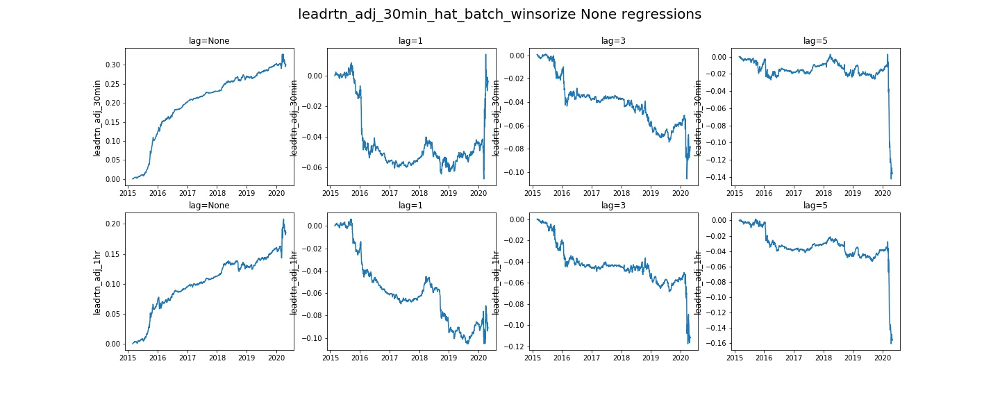

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.008049,0.502131,0.014622,0.000214,43.708515,2.078749,0.265165,0.202916,0.190227,0.179769
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.008049,0.452021,0.013204,0.000174,39.382294,1.801879,0.265165,0.202916,0.190227,0.179769
leadrtn_adj_30min,1.0,10178014,0.888224,-0.033105,0.087365,0.002572,0.000007,7.387938,0.587018,0.270718,0.205370,0.191951,0.180567
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.033105,-0.080976,-0.002441,0.000006,-7.097363,-0.731071,0.270718,0.205370,0.191951,0.180567
leadrtn_adj_30min,3.0,10178014,0.888119,-0.035146,-0.114767,-0.003030,0.000009,-8.943514,-0.977656,0.271569,0.206004,0.192693,0.180969
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.035146,-0.285773,-0.007639,0.000058,-22.796850,-1.541812,0.271569,0.206004,0.192693,0.180969
leadrtn_adj_30min,5.0,10178014,0.888011,-0.036671,-0.342162,-0.012606,0.000159,-37.644962,-1.807012,0.269894,0.205669,0.193380,0.180779
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.036671,-0.356593,-0.012935,0.000167,-38.619083,-1.595244,0.269894,0.205669,0.193380,0.180779


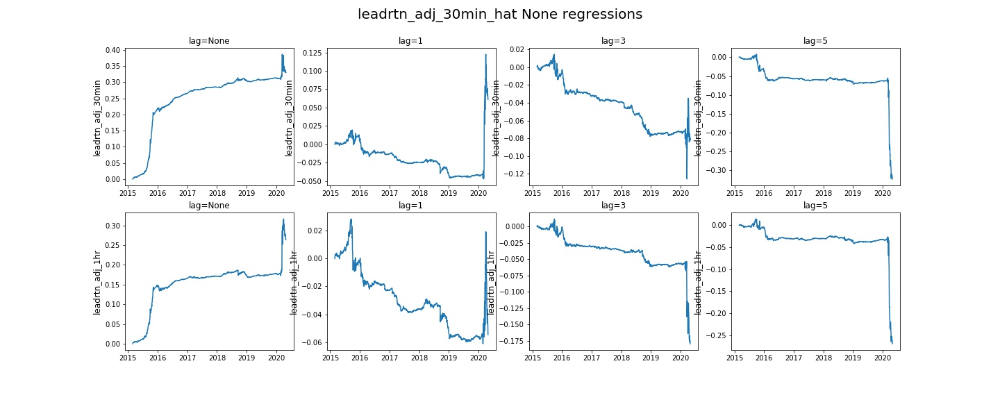

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.053193,0.728628,0.014780,0.000218,44.019875,5.307600,0.507441,0.428692,0.389430,0.368386
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.053193,0.543103,0.011289,0.000127,33.490791,2.944930,0.507441,0.428692,0.389430,0.368386
leadrtn_adj_30min,1.0,10178014,0.888224,-0.143000,0.006291,0.000000,0.000000,0.371823,0.044245,0.522120,0.435749,0.394879,0.373422
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.143000,-0.126916,-0.002697,0.000007,-7.944735,-1.118025,0.522120,0.435749,0.394879,0.373422
leadrtn_adj_30min,3.0,10178014,0.888119,-0.151186,-0.223607,-0.004278,0.000018,-12.603748,-2.018076,0.522707,0.437881,0.395352,0.373950
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.151186,-0.345291,-0.006713,0.000045,-19.438948,-2.576255,0.522707,0.437881,0.395352,0.373950
leadrtn_adj_30min,5.0,10178014,0.888011,-0.156998,-0.281777,-0.007012,0.000049,-20.726458,-2.113235,0.523543,0.438780,0.396658,0.374343
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.156998,-0.314262,-0.007697,0.000059,-22.498447,-1.892359,0.523543,0.438780,0.396658,0.374343


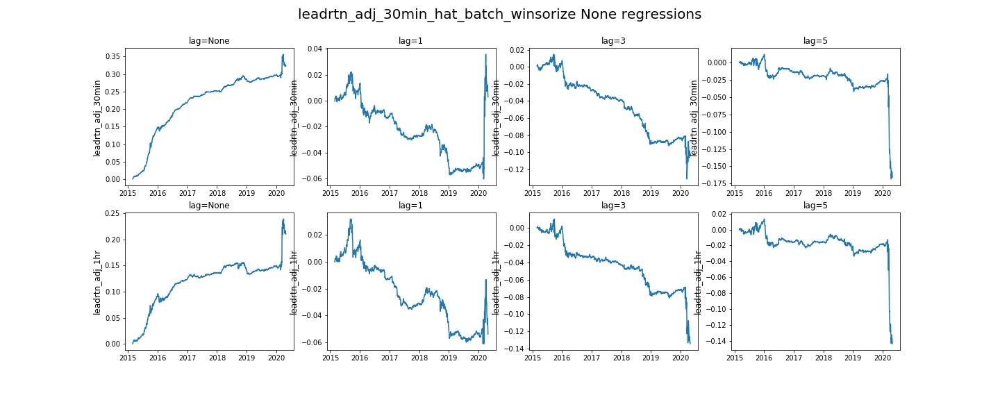

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.004284,0.623449,0.015976,0.000255,47.827213,2.951573,0.334543,0.262558,0.244817,0.237005
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.004284,0.504049,0.013029,0.000170,38.729752,2.489525,0.334543,0.262558,0.244817,0.237005
leadrtn_adj_30min,1.0,10178014,0.888224,-0.049057,0.039203,0.001171,0.000001,2.949985,0.316482,0.342821,0.266808,0.247870,0.239075
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.049057,-0.141902,-0.003814,0.000015,-11.493056,-1.243622,0.342821,0.266808,0.247870,0.239075
leadrtn_adj_30min,3.0,10178014,0.888119,-0.052974,-0.122922,-0.003107,0.000010,-8.851117,-1.044420,0.343848,0.267607,0.248672,0.239666
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.052974,-0.281942,-0.007059,0.000050,-20.814997,-1.820000,0.343848,0.267607,0.248672,0.239666
leadrtn_adj_30min,5.0,10178014,0.888011,-0.055885,-0.336280,-0.010798,0.000117,-32.226707,-2.154850,0.342009,0.267448,0.249395,0.239444
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.055885,-0.345877,-0.010962,0.000120,-32.508354,-1.841917,0.342009,0.267448,0.249395,0.239444


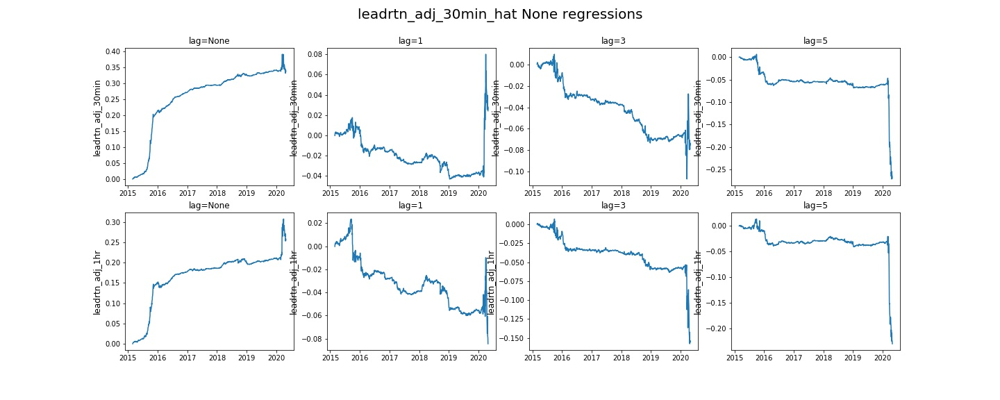

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.046513,0.724570,0.013426,0.000180,40.083466,5.473348,0.499941,0.431019,0.390755,0.377270
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.046513,0.522209,0.010001,0.000100,29.465820,3.319333,0.499941,0.431019,0.390755,0.377270
leadrtn_adj_30min,1.0,10178014,0.888224,-0.151399,-0.018544,-0.000000,0.000000,-1.018385,-0.151063,0.513863,0.438293,0.395887,0.382082
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.151399,-0.163502,-0.003183,0.000010,-9.531099,-1.429497,0.513863,0.438293,0.395887,0.382082
leadrtn_adj_30min,3.0,10178014,0.888119,-0.161004,-0.191023,-0.003435,0.000012,-9.845462,-1.682714,0.514586,0.440333,0.396553,0.382905
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.161004,-0.311409,-0.005481,0.000030,-15.998631,-2.208562,0.514586,0.440333,0.396553,0.382905
leadrtn_adj_30min,5.0,10178014,0.888011,-0.167680,-0.291877,-0.006404,0.000041,-18.964367,-2.092135,0.515433,0.441235,0.397723,0.383321
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.167680,-0.308101,-0.006875,0.000047,-19.960186,-1.822614,0.515433,0.441235,0.397723,0.383321


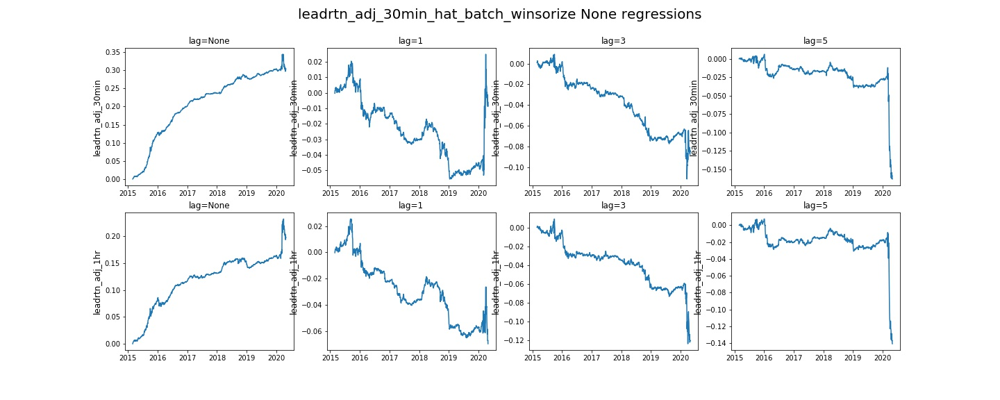

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.007513,0.899890,0.020609,4.247427e-04,61.779720,5.661916,0.433702,0.270250,0.272268,0.263167
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.007513,0.679743,0.015762,2.484322e-04,46.899658,4.096069,0.433702,0.270250,0.272268,0.263167
leadrtn_adj_30min,1.0,10178014,0.888224,-0.230638,0.036514,0.000810,6.556511e-07,2.445162,0.281816,0.441804,0.275050,0.275632,0.264917
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.230638,-0.208878,-0.005003,2.503395e-05,-14.722042,-1.857556,0.441804,0.275050,0.275632,0.264917
leadrtn_adj_30min,3.0,10178014,0.888119,-0.251335,-0.182012,-0.004063,1.651049e-05,-11.730801,-1.636487,0.444183,0.275355,0.277273,0.266236
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.251335,-0.262398,-0.005920,3.504753e-05,-17.295828,-1.935293,0.444183,0.275355,0.277273,0.266236
leadrtn_adj_30min,5.0,10178014,0.888011,-0.265896,-0.257647,-0.006905,4.768372e-05,-20.459774,-1.901579,0.442042,0.275484,0.277936,0.267375
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.265896,-0.285284,-0.007713,5.948544e-05,-22.541430,-1.798906,0.442042,0.275484,0.277936,0.267375


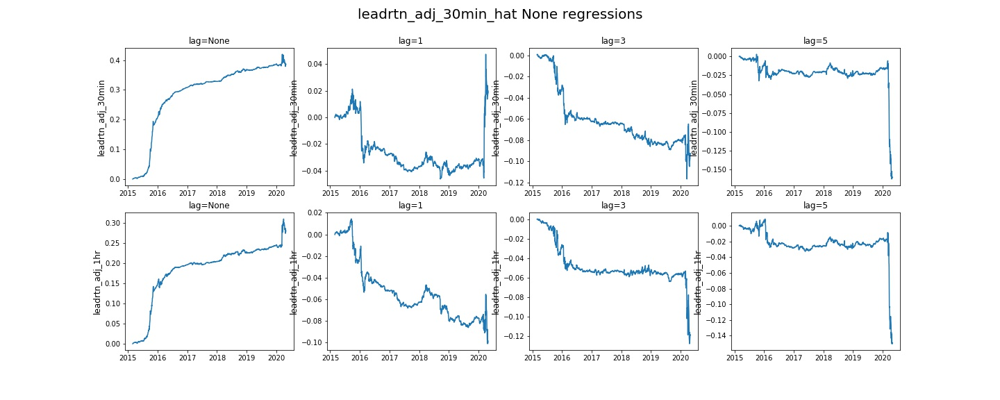

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.191115,0.866564,0.015231,2.319813e-04,45.610874,6.296932,0.461901,0.338530,0.324232,0.316241
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.191115,0.578270,0.010687,1.142025e-04,31.533182,3.804972,0.461901,0.338530,0.324232,0.316241
leadrtn_adj_30min,1.0,10178014,0.888224,-0.554765,-0.034271,-0.000646,4.172325e-07,-1.825716,-0.274905,0.471038,0.343941,0.328176,0.319311
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.554765,-0.224904,-0.004319,1.865625e-05,-12.613534,-1.985281,0.471038,0.343941,0.328176,0.319311
leadrtn_adj_30min,3.0,10178014,0.888119,-0.587737,-0.149760,-0.002762,7.629395e-06,-7.675146,-1.363530,0.472028,0.344885,0.328656,0.320141
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.587737,-0.232536,-0.004179,1.746416e-05,-12.000918,-1.720084,0.472028,0.344885,0.328656,0.320141
leadrtn_adj_30min,5.0,10178014,0.888011,-0.611316,-0.223817,-0.004709,2.217293e-05,-13.533304,-1.665864,0.472377,0.345744,0.329744,0.321043
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.611316,-0.265736,-0.005599,3.135204e-05,-16.087578,-1.665908,0.472377,0.345744,0.329744,0.321043


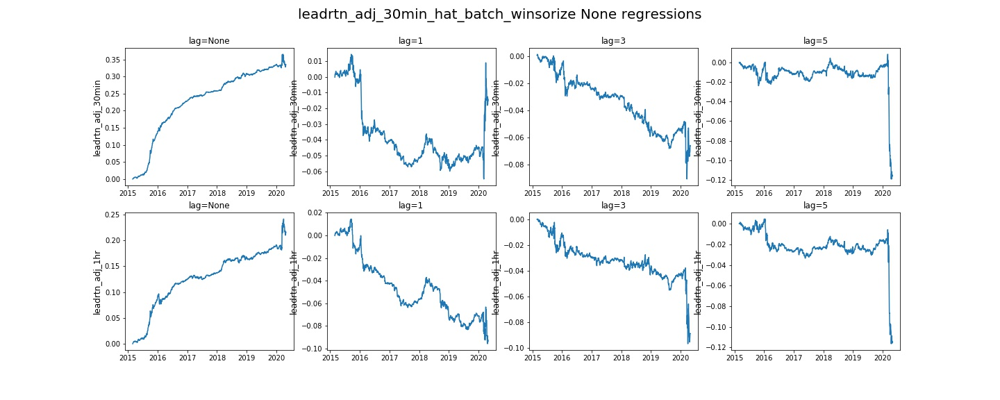

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.048286,0.771522,0.017636,0.000311,52.781437,5.090103,0.410281,0.182408,0.211446,0.201064
leadrtn_adj_1hr,NaN,10178014,0.888220,0.048286,0.580600,0.013724,0.000188,40.899235,3.564918,0.410281,0.182408,0.211446,0.201064
leadrtn_adj_30min,1.0,10178014,0.888224,-0.894771,0.063386,0.001525,0.000002,4.449856,0.460994,0.415384,0.185207,0.213381,0.201343
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.894771,-0.198512,-0.004846,0.000023,-14.407660,-1.736144,0.415384,0.185207,0.213381,0.201343
leadrtn_adj_30min,3.0,10178014,0.888119,-0.990009,-0.195553,-0.004360,0.000019,-12.590307,-1.773264,0.417274,0.185129,0.215059,0.203003
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.990009,-0.273907,-0.006167,0.000038,-18.150400,-2.041793,0.417274,0.185129,0.215059,0.203003
leadrtn_adj_30min,5.0,10178014,0.888011,-1.049841,-0.257828,-0.007242,0.000052,-21.321625,-1.950564,0.415632,0.185312,0.215793,0.204338
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.049841,-0.326565,-0.009119,0.000083,-26.990671,-2.100544,0.415632,0.185312,0.215793,0.204338


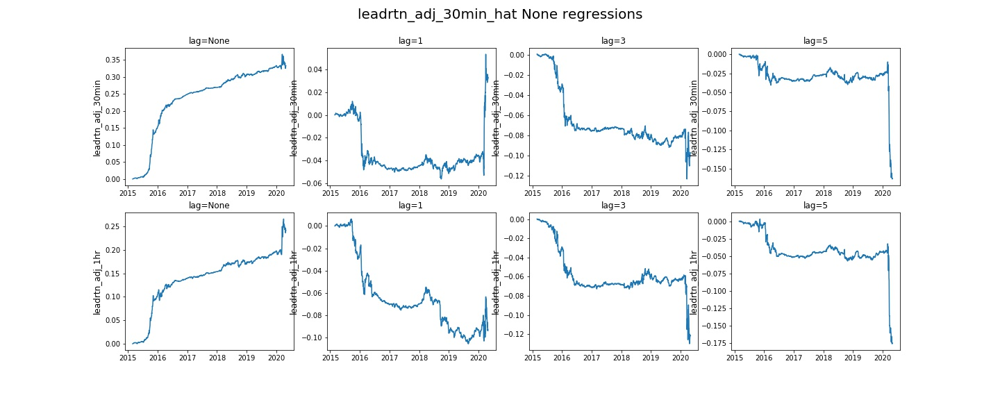

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.738022,0.751616,0.013470,1.814365e-04,40.226929,5.429720,0.420195,0.232952,0.247320,0.239646
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.738022,0.490692,0.009322,8.690357e-05,27.612238,3.412693,0.420195,0.232952,0.247320,0.239646
leadrtn_adj_30min,1.0,10178014,0.888224,-2.389898,-0.003186,-0.000488,-2.384186e-07,-0.180169,-0.026388,0.425669,0.236628,0.250351,0.241516
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.389898,-0.221881,-0.004401,1.937151e-05,-12.975951,-1.826054,0.425669,0.236628,0.250351,0.241516
leadrtn_adj_30min,3.0,10178014,0.888119,-2.554290,-0.138800,-0.002730,7.450581e-06,-7.368062,-1.244593,0.426760,0.236873,0.250784,0.242359
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.554290,-0.221599,-0.004100,1.680851e-05,-11.984250,-1.639017,0.426760,0.236873,0.250784,0.242359
leadrtn_adj_30min,5.0,10178014,0.888011,-2.658066,-0.225453,-0.004753,2.259016e-05,-13.686090,-1.668454,0.426627,0.237476,0.251720,0.243311
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.658066,-0.310892,-0.006514,4.243851e-05,-19.059250,-1.997215,0.426627,0.237476,0.251720,0.243311


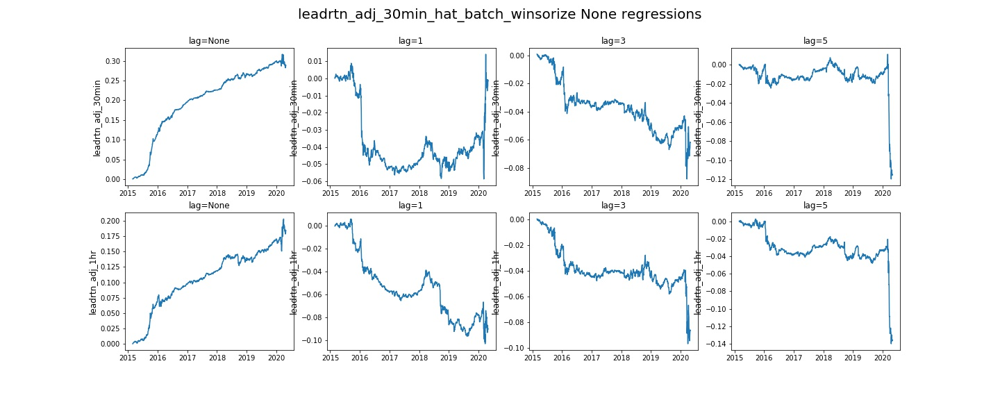

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.021998,0.816761,0.021748,0.000473,65.219025,5.175997,0.415868,0.242639,0.261445,0.242958
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.021998,0.631973,0.016953,0.000287,50.574615,3.702695,0.415868,0.242639,0.261445,0.242958
leadrtn_adj_30min,1.0,10178014,0.888224,-0.252821,0.040799,0.001221,0.000001,3.176701,0.305422,0.423551,0.247068,0.265069,0.244308
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.252821,-0.186026,-0.005115,0.000026,-15.120705,-1.640727,0.423551,0.247068,0.265069,0.244308
leadrtn_adj_30min,3.0,10178014,0.888119,-0.273020,-0.194467,-0.004913,0.000024,-14.524608,-1.793736,0.426336,0.247176,0.267121,0.246019
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.273020,-0.297961,-0.007697,0.000059,-22.657385,-2.214160,0.426336,0.247176,0.267121,0.246019
leadrtn_adj_30min,5.0,10178014,0.888011,-0.287609,-0.278098,-0.008809,0.000078,-26.240980,-2.020671,0.423911,0.247290,0.267607,0.247633
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.287609,-0.313779,-0.010025,0.000100,-29.745096,-1.926810,0.423911,0.247290,0.267607,0.247633


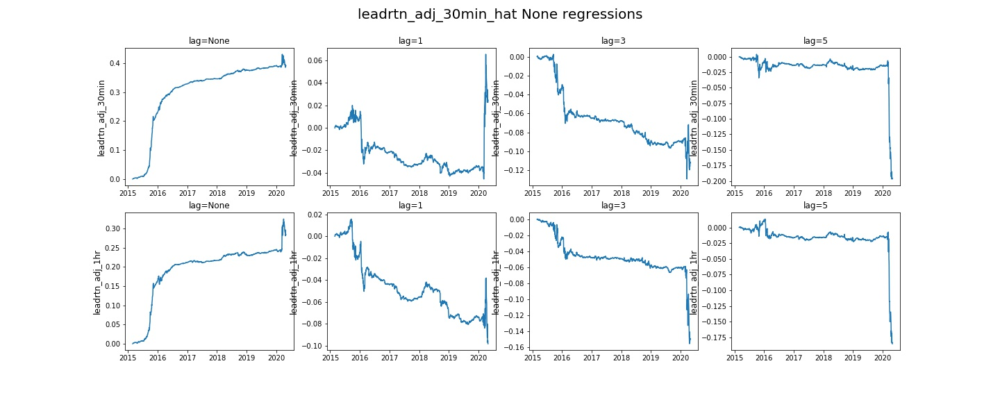

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.220421,0.879566,0.016483,2.716780e-04,49.337391,6.458551,0.436408,0.316674,0.302773,0.290675
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.220421,0.592316,0.011624,1.351237e-04,34.428223,3.667515,0.436408,0.316674,0.302773,0.290675
leadrtn_adj_30min,1.0,10178014,0.888224,-0.649978,-0.037527,-0.000913,8.344650e-07,-2.145957,-0.286286,0.446300,0.322872,0.307505,0.294402
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.649978,-0.215118,-0.004415,1.949072e-05,-12.818396,-1.940081,0.446300,0.322872,0.307505,0.294402
leadrtn_adj_30min,3.0,10178014,0.888119,-0.687878,-0.193508,-0.003621,1.311302e-05,-10.469158,-1.748421,0.447414,0.323914,0.307897,0.295237
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.687878,-0.287889,-0.005321,2.831221e-05,-15.565008,-2.166410,0.447414,0.323914,0.307897,0.295237
leadrtn_adj_30min,5.0,10178014,0.888011,-0.715350,-0.252132,-0.005705,3.254414e-05,-16.606972,-1.845711,0.447796,0.324914,0.309210,0.296381
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.715350,-0.304380,-0.006827,4.661083e-05,-19.951866,-1.857686,0.447796,0.324914,0.309210,0.296381


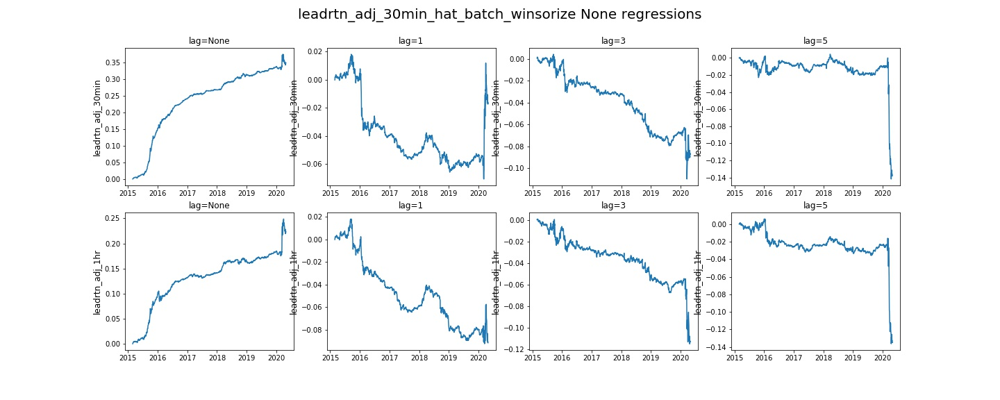

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.046607,0.772267,0.017626,0.000311,52.748775,5.099058,0.411853,0.185651,0.212563,0.202102
leadrtn_adj_1hr,NaN,10178014,0.888220,0.046607,0.578701,0.013648,0.000186,40.678402,3.548161,0.411853,0.185651,0.212563,0.202102
leadrtn_adj_30min,1.0,10178014,0.888224,-0.899207,0.059958,0.001315,0.000002,4.202098,0.436223,0.417048,0.188515,0.214519,0.202416
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.899207,-0.202178,-0.004889,0.000024,-14.641788,-1.760851,0.417048,0.188515,0.214519,0.202416
leadrtn_adj_30min,3.0,10178014,0.888119,-0.995041,-0.197345,-0.004395,0.000019,-12.674827,-1.785930,0.418955,0.188453,0.216220,0.204074
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.995041,-0.276066,-0.006176,0.000038,-18.252930,-2.053327,0.418955,0.188453,0.216220,0.204074
leadrtn_adj_30min,5.0,10178014,0.888011,-1.055357,-0.260265,-0.007288,0.000053,-21.477840,-1.968515,0.417288,0.188627,0.216956,0.205413
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.055357,-0.329768,-0.009190,0.000084,-27.192987,-2.119654,0.417288,0.188627,0.216956,0.205413


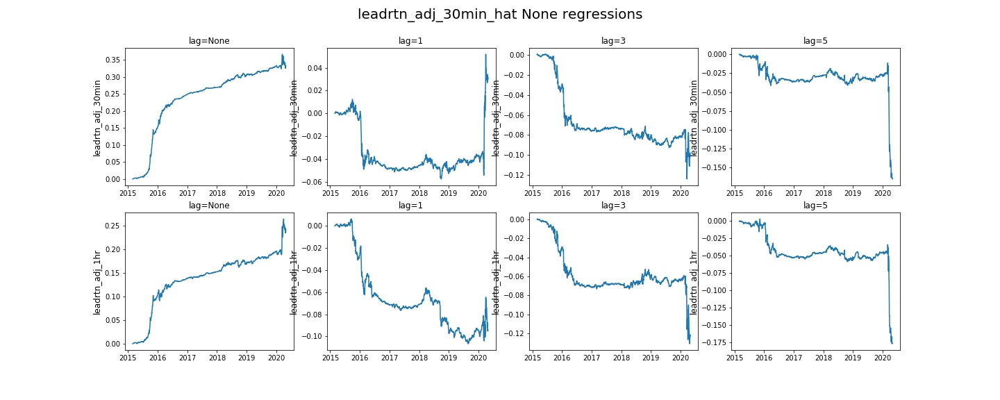

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.749548,0.755212,0.013529,1.830459e-04,40.403091,5.453912,0.420904,0.234353,0.248339,0.240694
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.749548,0.491438,0.009332,8.708239e-05,27.649582,3.414645,0.420904,0.234353,0.248339,0.240694
leadrtn_adj_30min,1.0,10178014,0.888224,-2.409371,-0.005179,-0.000488,-2.384186e-07,-0.292854,-0.042911,0.426462,0.238066,0.251392,0.242602
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.409371,-0.223674,-0.004455,1.984835e-05,-13.079851,-1.840689,0.426462,0.238066,0.251392,0.242602
leadrtn_adj_30min,3.0,10178014,0.888119,-2.574803,-0.139991,-0.002697,7.271767e-06,-7.431342,-1.254540,0.427559,0.238319,0.251847,0.243449
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.574803,-0.223569,-0.004158,1.728535e-05,-12.091829,-1.650995,0.427559,0.238319,0.251847,0.243449
leadrtn_adj_30min,5.0,10178014,0.888011,-2.679627,-0.226890,-0.004772,2.276897e-05,-13.776737,-1.678150,0.427421,0.238935,0.252780,0.244403
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.679627,-0.312669,-0.006524,4.255772e-05,-19.169823,-2.005575,0.427421,0.238935,0.252780,0.244403


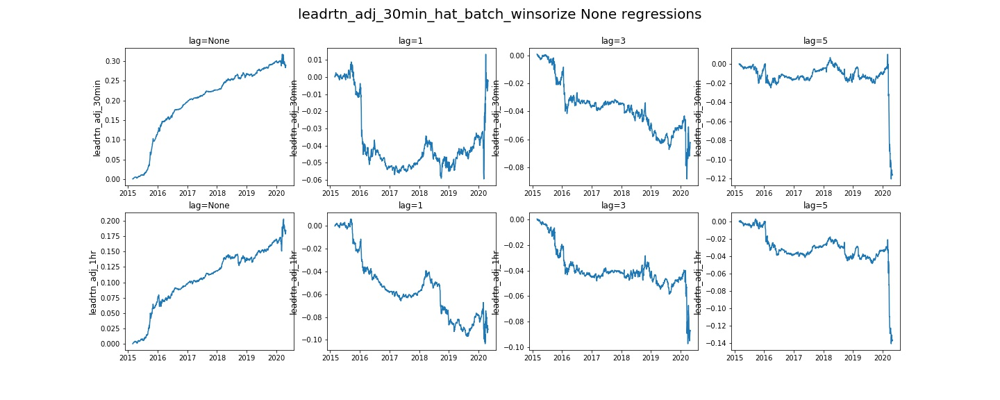

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.008557,0.942929,0.021772,4.740357e-04,65.285225,5.799845,0.417117,0.242552,0.260476,0.247757
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.008557,0.697377,0.016299,2.656579e-04,48.530708,4.192732,0.417117,0.242552,0.260476,0.247757
leadrtn_adj_30min,1.0,10178014,0.888224,-0.230823,0.014260,0.000244,5.960464e-08,0.967297,0.114435,0.425457,0.247178,0.264089,0.249094
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.230823,-0.211411,-0.005104,2.604723e-05,-15.078035,-1.866497,0.425457,0.247178,0.264089,0.249094
leadrtn_adj_30min,3.0,10178014,0.888119,-0.250796,-0.197674,-0.004488,2.014637e-05,-12.950002,-1.793656,0.428291,0.247403,0.266056,0.250842
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.250796,-0.274528,-0.006210,3.856421e-05,-18.166368,-2.077262,0.428291,0.247403,0.266056,0.250842
leadrtn_adj_30min,5.0,10178014,0.888011,-0.265336,-0.251131,-0.006695,4.482269e-05,-19.751173,-1.849979,0.425851,0.247560,0.266819,0.252415
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.265336,-0.280417,-0.007529,5.668402e-05,-22.089083,-1.781983,0.425851,0.247560,0.266819,0.252415


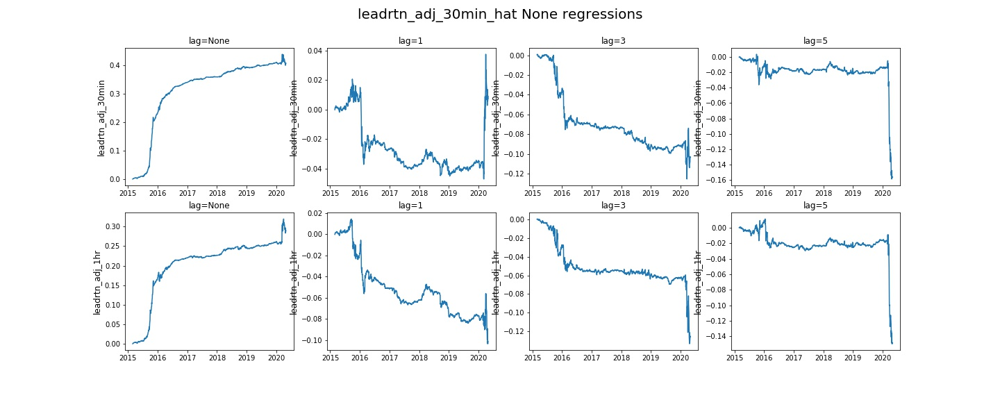

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.200897,0.876544,0.015659,0.000245,46.887672,6.408178,0.448265,0.333435,0.318664,0.310014
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.200897,0.575129,0.010759,0.000116,31.778885,3.819641,0.448265,0.333435,0.318664,0.310014
leadrtn_adj_30min,1.0,10178014,0.888224,-0.590316,-0.052852,-0.001092,0.000001,-2.864635,-0.427075,0.458177,0.339300,0.323048,0.313421
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.590316,-0.231644,-0.004541,0.000021,-13.175464,-2.062703,0.458177,0.339300,0.323048,0.313421
leadrtn_adj_30min,3.0,10178014,0.888119,-0.624899,-0.163647,-0.003049,0.000009,-8.445610,-1.476159,0.459283,0.340299,0.323404,0.314245
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.624899,-0.253209,-0.004528,0.000021,-13.099343,-1.904134,0.459283,0.340299,0.323404,0.314245
leadrtn_adj_30min,5.0,10178014,0.888011,-0.650419,-0.227741,-0.004765,0.000023,-13.855289,-1.681389,0.459549,0.341165,0.324639,0.315292
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.650419,-0.273483,-0.005777,0.000033,-16.616737,-1.707128,0.459549,0.341165,0.324639,0.315292


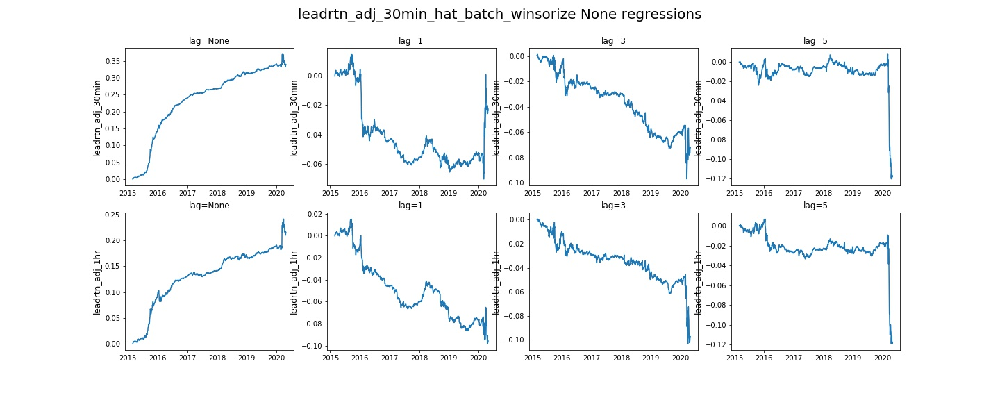

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.012037,0.723304,0.018214,0.000332,54.534981,4.850877,0.406536,0.181569,0.212668,0.198732
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.012037,0.563497,0.014575,0.000212,43.496315,3.329375,0.406536,0.181569,0.212668,0.198732
leadrtn_adj_30min,1.0,10178014,0.888224,-1.019289,0.075562,0.002211,0.000005,5.810380,0.519502,0.411660,0.184423,0.214704,0.199057
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.019289,-0.183405,-0.004907,0.000024,-14.513154,-1.595044,0.411660,0.184423,0.214704,0.199057
leadrtn_adj_30min,3.0,10178014,0.888119,-1.118063,-0.216091,-0.005270,0.000028,-15.248438,-1.993942,0.413597,0.184306,0.216508,0.200741
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.118063,-0.311860,-0.007697,0.000059,-22.740740,-2.295687,0.413597,0.184306,0.216508,0.200741
leadrtn_adj_30min,5.0,10178014,0.888011,-1.181068,-0.273392,-0.008683,0.000075,-25.733561,-2.043293,0.411870,0.184559,0.217183,0.202312
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.181068,-0.346757,-0.010948,0.000120,-32.636566,-2.173514,0.411870,0.184559,0.217183,0.202312


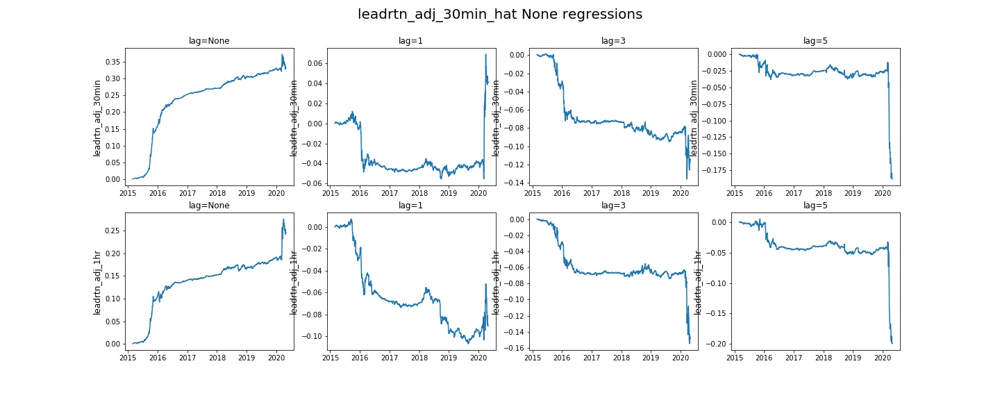

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.833411,0.759382,0.014042,1.971722e-04,41.941483,5.533366,0.412752,0.226719,0.241715,0.231770
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.833411,0.494242,0.009738,9.483099e-05,28.851871,3.243080,0.412752,0.226719,0.241715,0.231770
leadrtn_adj_30min,1.0,10178014,0.888224,-2.647551,-0.007911,-0.000488,-2.384186e-07,-0.463603,-0.062034,0.418299,0.230659,0.244959,0.233909
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.647551,-0.222005,-0.004606,2.121925e-05,-13.489235,-1.834166,0.418299,0.230659,0.244959,0.233909
leadrtn_adj_30min,3.0,10178014,0.888119,-2.824825,-0.172712,-0.003444,1.186132e-05,-9.572487,-1.556835,0.419461,0.231003,0.245456,0.234779
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.824825,-0.280633,-0.005421,2.938509e-05,-15.821934,-2.075881,0.419461,0.231003,0.245456,0.234779
leadrtn_adj_30min,5.0,10178014,0.888011,-2.939378,-0.259473,-0.005705,3.254414e-05,-16.757187,-1.859872,0.419388,0.231768,0.246481,0.235881
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.939378,-0.352768,-0.007820,6.115437e-05,-23.092754,-2.151276,0.419388,0.231768,0.246481,0.235881


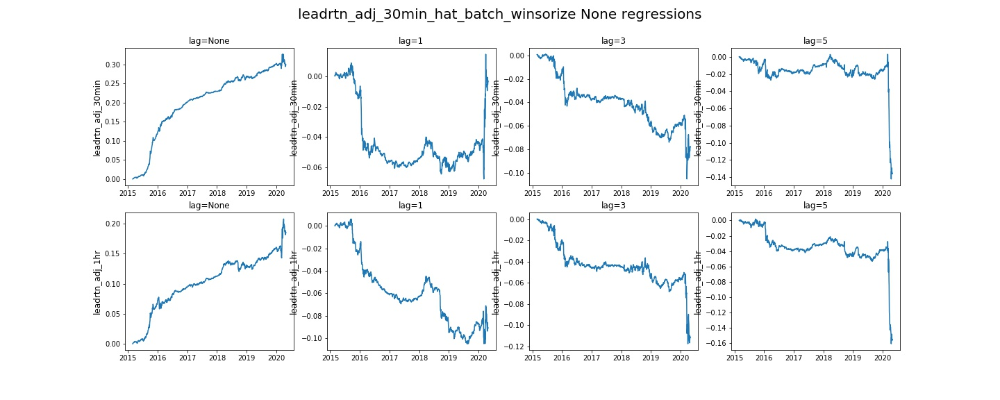

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.008422,0.912014,0.020948,4.388094e-04,62.817204,5.711483,0.425590,0.262690,0.265755,0.254385
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.008422,0.669425,0.015562,2.421737e-04,46.326939,4.065001,0.425590,0.262690,0.265755,0.254385
leadrtn_adj_30min,1.0,10178014,0.888224,-0.228855,0.009457,0.000244,5.960464e-08,0.639517,0.075201,0.434182,0.267742,0.269302,0.256111
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.228855,-0.224916,-0.005426,2.944469e-05,-15.954606,-1.985661,0.434182,0.267742,0.269302,0.256111
leadrtn_adj_30min,3.0,10178014,0.888119,-0.248970,-0.194009,-0.004285,1.835823e-05,-12.552417,-1.743247,0.436891,0.268067,0.271212,0.257658
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.248970,-0.277048,-0.006244,3.898144e-05,-18.243668,-2.071388,0.436891,0.268067,0.271212,0.257658
leadrtn_adj_30min,5.0,10178014,0.888011,-0.263537,-0.260151,-0.006948,4.827976e-05,-20.500647,-1.913810,0.434464,0.268133,0.271864,0.259009
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.263537,-0.290833,-0.007770,6.037951e-05,-22.870291,-1.835198,0.434464,0.268133,0.271864,0.259009


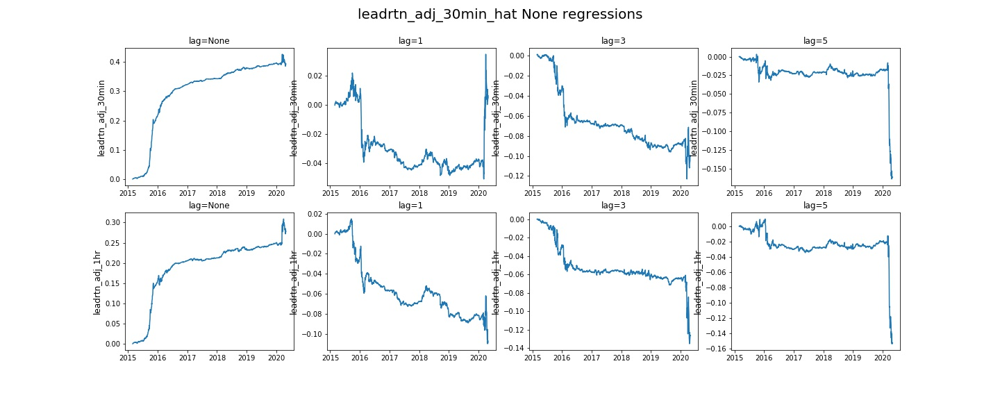

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.198549,0.874048,0.015510,0.000241,46.486496,6.416560,0.450729,0.336376,0.319910,0.311527
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.198549,0.575765,0.010714,0.000115,31.638390,3.852652,0.450729,0.336376,0.319910,0.311527
leadrtn_adj_30min,1.0,10178014,0.888224,-0.572512,-0.049006,-0.001007,0.000001,-2.637002,-0.397884,0.460648,0.342291,0.324220,0.314926
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.572512,-0.228654,-0.004442,0.000020,-12.925536,-2.041009,0.460648,0.342291,0.324220,0.314926
leadrtn_adj_30min,3.0,10178014,0.888119,-0.605884,-0.161888,-0.003020,0.000009,-8.337555,-1.459773,0.461722,0.343283,0.324674,0.315762
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.605884,-0.252836,-0.004554,0.000021,-13.047287,-1.893597,0.461722,0.343283,0.324674,0.315762
leadrtn_adj_30min,5.0,10178014,0.888011,-0.630540,-0.229526,-0.004821,0.000023,-13.916227,-1.694957,0.462020,0.344157,0.325840,0.316730
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.630540,-0.270718,-0.005684,0.000032,-16.384890,-1.693525,0.462020,0.344157,0.325840,0.316730


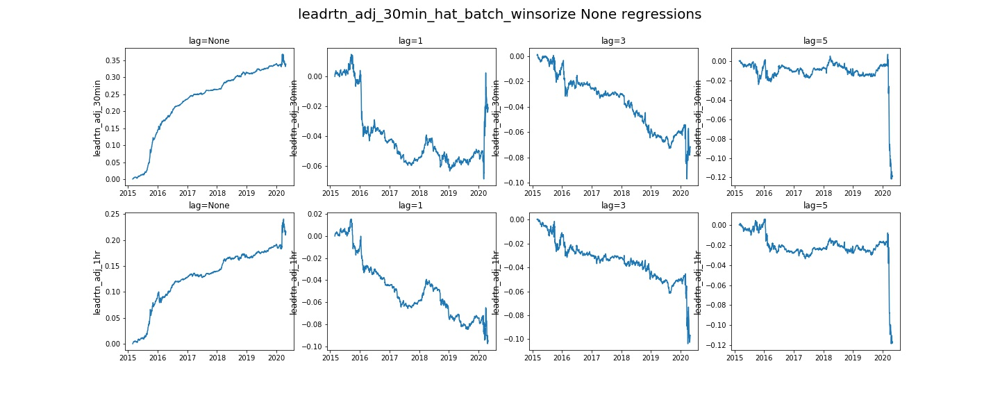

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.006798,0.937728,0.021520,4.631281e-04,64.548531,5.791395,0.416544,0.243760,0.260053,0.247984
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.006798,0.695563,0.016185,2.619624e-04,48.164124,4.206876,0.416544,0.243760,0.260053,0.247984
leadrtn_adj_30min,1.0,10178014,0.888224,-0.225933,0.018878,0.000423,1.788139e-07,1.272241,0.150979,0.424757,0.248436,0.263637,0.249364
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.225933,-0.211432,-0.005063,2.563000e-05,-15.000551,-1.881503,0.424757,0.248436,0.263637,0.249364
leadrtn_adj_30min,3.0,10178014,0.888119,-0.245624,-0.195112,-0.004347,1.889467e-05,-12.739639,-1.765810,0.427496,0.248654,0.265556,0.251074
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.245624,-0.271746,-0.006123,3.749132e-05,-17.929573,-2.055939,0.427496,0.248654,0.265556,0.251074
leadrtn_adj_30min,5.0,10178014,0.888011,-0.259913,-0.249693,-0.006664,4.440546e-05,-19.616072,-1.836484,0.425191,0.248839,0.266282,0.252599
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.259913,-0.279547,-0.007469,5.578995e-05,-21.959814,-1.771361,0.425191,0.248839,0.266282,0.252599


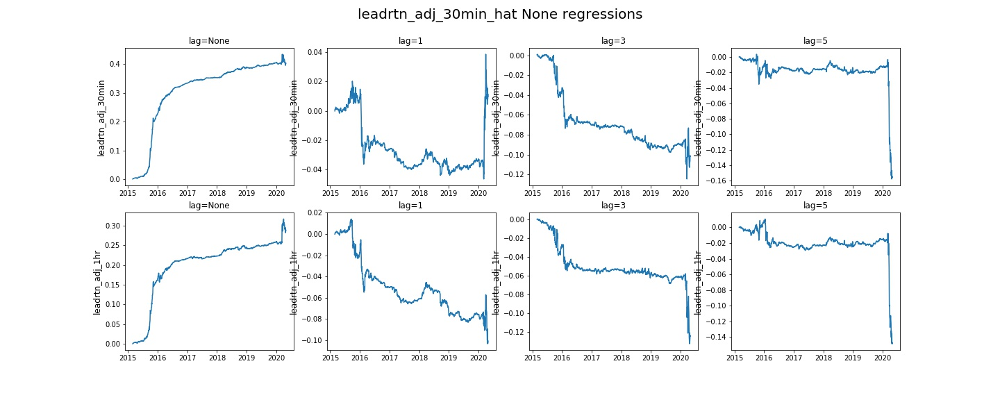

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.192819,0.871527,0.015491,2.399683e-04,46.405228,6.401516,0.447511,0.332346,0.317265,0.308848
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.192819,0.573877,0.010698,1.144409e-04,31.577503,3.842502,0.447511,0.332346,0.317265,0.308848
leadrtn_adj_30min,1.0,10178014,0.888224,-0.569275,-0.048560,-0.000977,9.536743e-07,-2.616441,-0.391902,0.457254,0.338214,0.321607,0.312220
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.569275,-0.230901,-0.004488,2.014637e-05,-13.080061,-2.065484,0.457254,0.338214,0.321607,0.312220
leadrtn_adj_30min,3.0,10178014,0.888119,-0.602720,-0.159363,-0.002950,8.702278e-06,-8.218691,-1.435848,0.458356,0.339182,0.321990,0.313071
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.602720,-0.248699,-0.004462,1.990795e-05,-12.852582,-1.873196,0.458356,0.339182,0.321990,0.313071
leadrtn_adj_30min,5.0,10178014,0.888011,-0.627286,-0.225078,-0.004734,2.241135e-05,-13.656609,-1.659868,0.458626,0.340041,0.323187,0.314093
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.627286,-0.270820,-0.005684,3.230572e-05,-16.402155,-1.693201,0.458626,0.340041,0.323187,0.314093


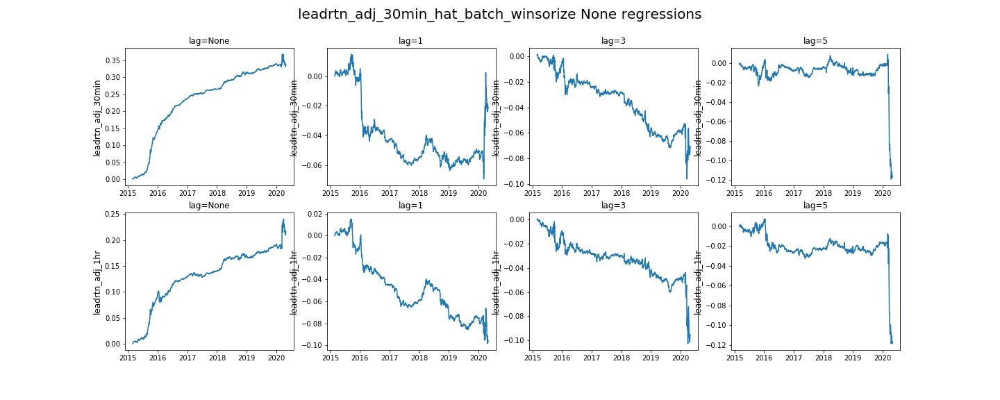

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.007841,0.520053,0.018463,0.000341,55.218533,3.709269,0.453902,0.356409,0.322523,0.306496
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.007841,0.482928,0.016881,0.000285,50.319355,3.037703,0.453902,0.356409,0.322523,0.306496
leadrtn_adj_30min,1.0,10178014,0.888224,-0.071605,0.103158,0.003605,0.000013,10.386905,0.764393,0.465024,0.363357,0.327260,0.309766
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.071605,-0.093516,-0.003339,0.000011,-9.845800,-0.919709,0.465024,0.363357,0.327260,0.309766
leadrtn_adj_30min,3.0,10178014,0.888119,-0.076927,-0.129441,-0.004200,0.000018,-12.206061,-1.244984,0.467282,0.364753,0.328781,0.311020
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.076927,-0.285320,-0.009303,0.000087,-27.467251,-2.206629,0.467282,0.364753,0.328781,0.311020
leadrtn_adj_30min,5.0,10178014,0.888011,-0.080605,-0.316400,-0.014275,0.000204,-42.660183,-2.306526,0.465755,0.364982,0.329378,0.311013
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.080605,-0.331478,-0.014726,0.000217,-43.836521,-1.941344,0.465755,0.364982,0.329378,0.311013


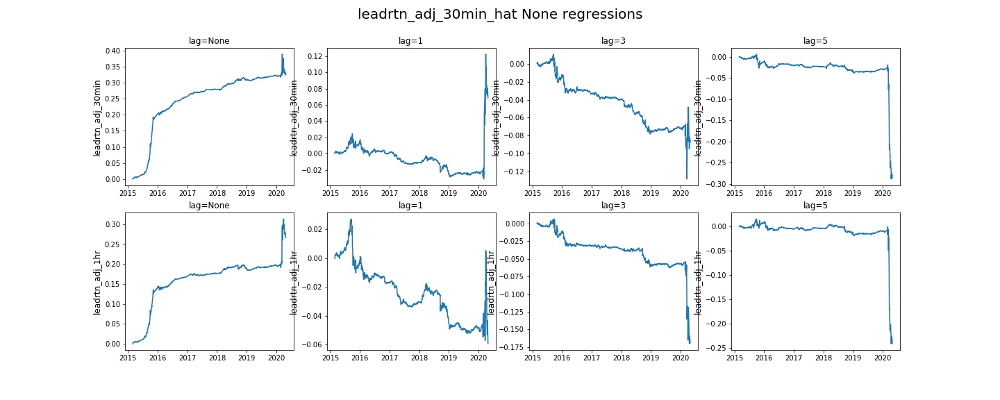

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.044132,0.749639,0.014893,2.217889e-04,44.474396,5.704732,0.497909,0.418818,0.371820,0.353590
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.044132,0.566976,0.011545,1.332760e-04,34.132835,3.340981,0.497909,0.418818,0.371820,0.353590
leadrtn_adj_30min,1.0,10178014,0.888224,-0.155716,0.011705,0.000598,3.576279e-07,0.677202,0.088911,0.512198,0.427266,0.377463,0.358771
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.155716,-0.111909,-0.002290,5.245209e-06,-6.831247,-1.025203,0.512198,0.427266,0.377463,0.358771
leadrtn_adj_30min,3.0,10178014,0.888119,-0.165233,-0.197203,-0.003727,1.388788e-05,-10.927106,-1.750337,0.512943,0.429142,0.378049,0.359694
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.165233,-0.305495,-0.005705,3.254414e-05,-16.780296,-2.225828,0.512943,0.429142,0.378049,0.359694
leadrtn_adj_30min,5.0,10178014,0.888011,-0.171759,-0.263654,-0.006390,4.082918e-05,-18.818686,-1.905089,0.513888,0.429954,0.379097,0.359905
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.171759,-0.286113,-0.006853,4.696846e-05,-19.975983,-1.704082,0.513888,0.429954,0.379097,0.359905


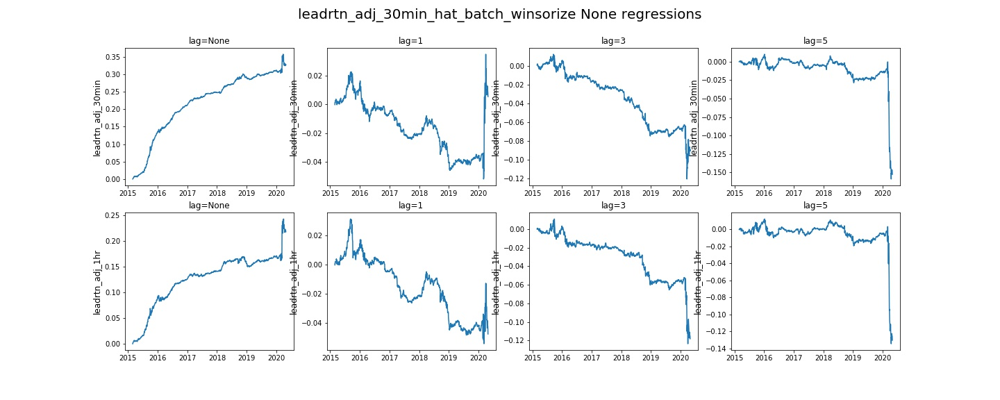

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.023750,0.779506,0.020809,0.000433,62.412369,5.054716,0.429870,0.267019,0.270347,0.255323
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.023750,0.614131,0.016486,0.000272,49.189976,3.592235,0.429870,0.267019,0.270347,0.255323
leadrtn_adj_30min,1.0,10178014,0.888224,-0.262237,0.054958,0.001582,0.000003,4.278162,0.398788,0.437700,0.271692,0.273840,0.257208
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.262237,-0.185130,-0.005092,0.000026,-15.014276,-1.625523,0.437700,0.271692,0.273840,0.257208
leadrtn_adj_30min,3.0,10178014,0.888119,-0.283887,-0.184108,-0.004645,0.000022,-13.615466,-1.693777,0.440097,0.271874,0.275578,0.258489
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.283887,-0.291270,-0.007529,0.000057,-22.156469,-2.121171,0.440097,0.271874,0.275578,0.258489
leadrtn_adj_30min,5.0,10178014,0.888011,-0.298988,-0.285683,-0.009184,0.000084,-27.359550,-2.079584,0.437792,0.271945,0.276031,0.259695
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.298988,-0.320962,-0.010381,0.000108,-30.742613,-1.963202,0.437792,0.271945,0.276031,0.259695


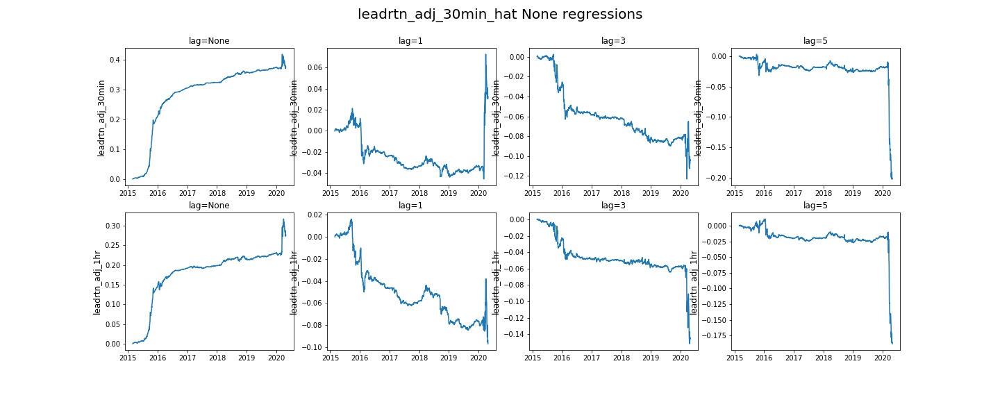

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.220527,0.872985,0.016172,2.615452e-04,48.445271,6.330335,0.449552,0.321057,0.307862,0.295836
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.220527,0.595177,0.011563,1.336932e-04,34.240231,3.643660,0.449552,0.321057,0.307862,0.295836
leadrtn_adj_30min,1.0,10178014,0.888224,-0.636658,-0.025634,-0.000732,5.364418e-07,-1.450926,-0.196231,0.458927,0.326882,0.312273,0.299309
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.636658,-0.210535,-0.004271,1.823902e-05,-12.446312,-1.870691,0.458927,0.326882,0.312273,0.299309
leadrtn_adj_30min,3.0,10178014,0.888119,-0.674122,-0.181230,-0.003383,1.144409e-05,-9.763427,-1.654955,0.459901,0.327888,0.312752,0.300150
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.674122,-0.274307,-0.005104,2.604723e-05,-14.806761,-2.034439,0.459901,0.327888,0.312752,0.300150
leadrtn_adj_30min,5.0,10178014,0.888011,-0.700702,-0.254606,-0.005679,3.224611e-05,-16.707417,-1.867555,0.460369,0.328882,0.313977,0.301082
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.700702,-0.302488,-0.006792,4.613400e-05,-19.808876,-1.840749,0.460369,0.328882,0.313977,0.301082


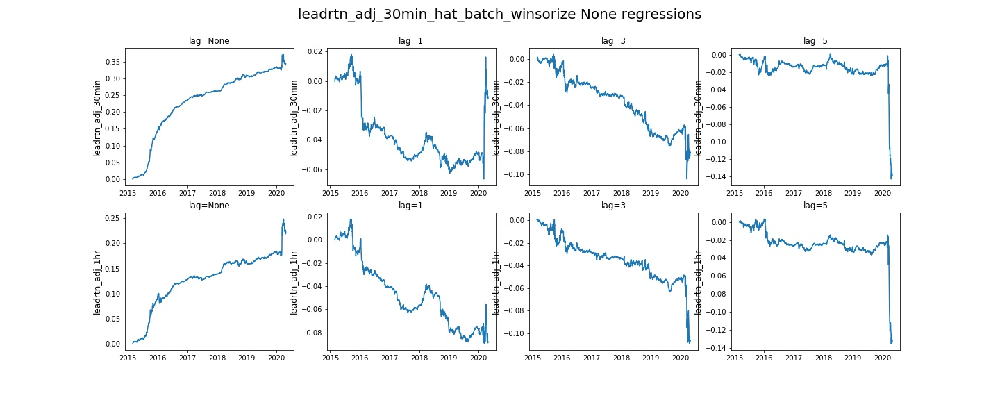

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.034365,0.715714,0.018037,0.000325,53.941242,4.798719,0.407670,0.181549,0.210866,0.197757
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.034365,0.560101,0.014481,0.000210,43.217545,3.302534,0.407670,0.181549,0.210866,0.197757
leadrtn_adj_30min,1.0,10178014,0.888224,-1.085882,0.079076,0.002264,0.000005,6.077598,0.540376,0.412655,0.184370,0.212884,0.198146
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.085882,-0.182093,-0.004846,0.000023,-14.399966,-1.575499,0.412655,0.184370,0.212884,0.198146
leadrtn_adj_30min,3.0,10178014,0.888119,-1.189653,-0.212774,-0.005162,0.000027,-14.985742,-1.965486,0.414512,0.184255,0.214622,0.199727
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.189653,-0.308015,-0.007592,0.000058,-22.458992,-2.260518,0.414512,0.184255,0.214622,0.199727
leadrtn_adj_30min,5.0,10178014,0.888011,-1.255227,-0.274204,-0.008714,0.000076,-25.872047,-2.059374,0.412832,0.184512,0.215277,0.201215
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.255227,-0.347050,-0.010992,0.000121,-32.718521,-2.185154,0.412832,0.184512,0.215277,0.201215


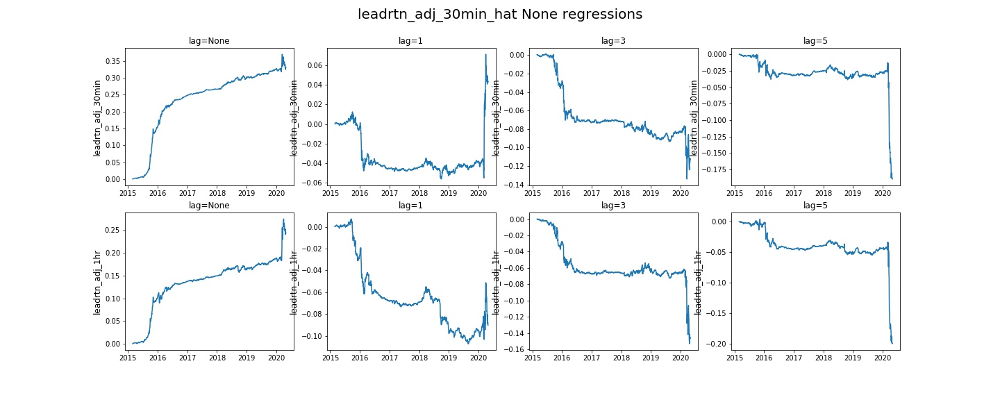

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.883857,0.754444,0.013903,1.932979e-04,41.483212,5.499825,0.412948,0.223726,0.239373,0.229505
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.883857,0.488884,0.009590,9.196997e-05,28.409267,3.225071,0.412948,0.223726,0.239373,0.229505
leadrtn_adj_30min,1.0,10178014,0.888224,-2.765029,-0.009024,-0.000598,-3.576279e-07,-0.526609,-0.070991,0.418400,0.227612,0.242593,0.231656
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.765029,-0.222814,-0.004606,2.121925e-05,-13.479462,-1.835169,0.418400,0.227612,0.242593,0.231656
leadrtn_adj_30min,3.0,10178014,0.888119,-2.950588,-0.172706,-0.003409,1.162291e-05,-9.514712,-1.562980,0.419517,0.227940,0.243094,0.232491
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.950588,-0.278019,-0.005338,2.849102e-05,-15.609332,-2.057353,0.419517,0.227940,0.243094,0.232491
leadrtn_adj_30min,5.0,10178014,0.888011,-3.068520,-0.261304,-0.005741,3.296137e-05,-16.792589,-1.876930,0.419464,0.228697,0.244092,0.233562
leadrtn_adj_1hr,5.0,10178014,0.887955,-3.068520,-0.354649,-0.007843,6.151199e-05,-23.120935,-2.167700,0.419464,0.228697,0.244092,0.233562


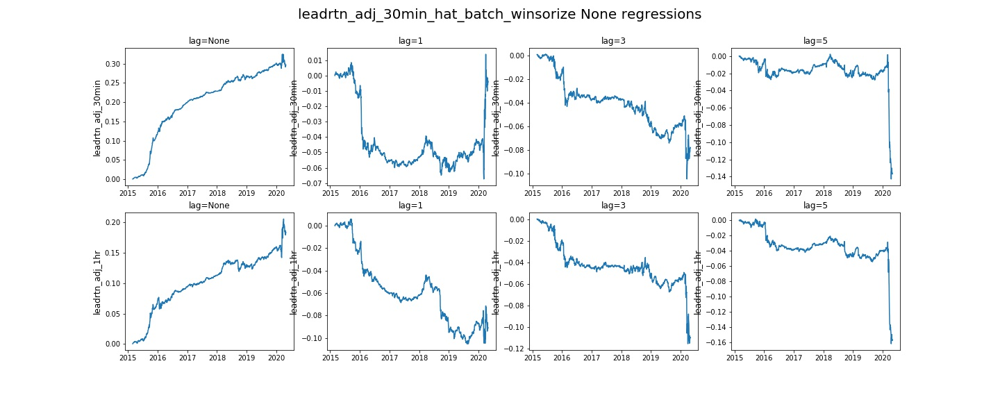

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.021876,0.784735,0.020835,0.000434,62.468338,5.064509,0.423850,0.262705,0.265710,0.248905
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.021876,0.602574,0.016115,0.000260,48.044891,3.565392,0.423850,0.262705,0.265710,0.248905
leadrtn_adj_30min,1.0,10178014,0.888224,-0.253811,0.035392,0.001036,0.000001,2.751111,0.263265,0.431895,0.267583,0.269290,0.250756
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.253811,-0.199552,-0.005492,0.000030,-16.157095,-1.759556,0.431895,0.267583,0.269290,0.250756
leadrtn_adj_30min,3.0,10178014,0.888119,-0.274476,-0.192214,-0.004803,0.000023,-14.203937,-1.767783,0.434465,0.267727,0.271221,0.252200
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.274476,-0.300744,-0.007724,0.000060,-22.782740,-2.220471,0.434465,0.267727,0.271221,0.252200
leadrtn_adj_30min,5.0,10178014,0.888011,-0.289281,-0.286270,-0.009109,0.000083,-27.113338,-2.077144,0.432052,0.267731,0.271568,0.253571
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.289281,-0.323963,-0.010355,0.000107,-30.749420,-1.982020,0.432052,0.267731,0.271568,0.253571


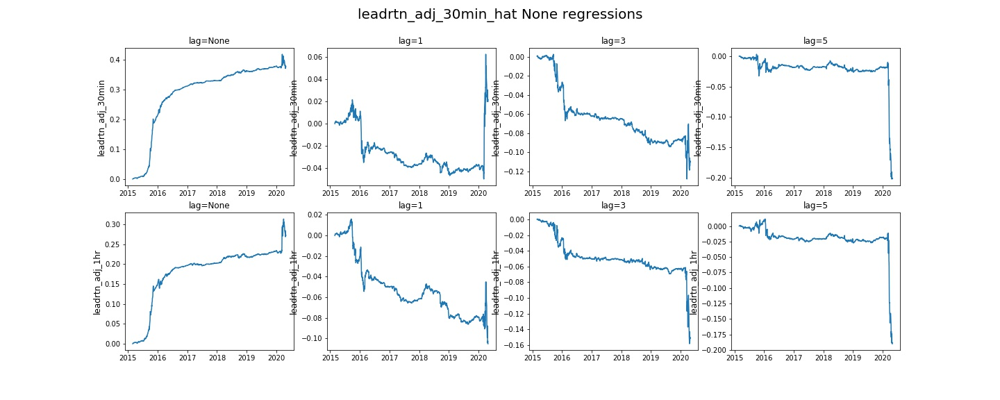

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.217761,0.873489,0.016281,2.650619e-04,48.712029,6.413900,0.438635,0.318972,0.303241,0.291450
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.217761,0.588625,0.011488,1.319647e-04,34.027134,3.671097,0.438635,0.318972,0.303241,0.291450
leadrtn_adj_30min,1.0,10178014,0.888224,-0.633871,-0.035985,-0.000846,7.152557e-07,-2.045060,-0.275940,0.448557,0.325264,0.307919,0.295176
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.633871,-0.215320,-0.004374,1.913309e-05,-12.759677,-1.941839,0.448557,0.325264,0.307919,0.295176
leadrtn_adj_30min,3.0,10178014,0.888119,-0.670753,-0.190688,-0.003546,1.257658e-05,-10.295534,-1.725926,0.449616,0.326266,0.308371,0.296034
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.670753,-0.288087,-0.005321,2.831221e-05,-15.536826,-2.161127,0.449616,0.326266,0.308371,0.296034
leadrtn_adj_30min,5.0,10178014,0.888011,-0.697483,-0.256293,-0.005741,3.296137e-05,-16.804710,-1.871612,0.450021,0.327260,0.309630,0.297051
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.697483,-0.303550,-0.006770,4.583597e-05,-19.804031,-1.854095,0.450021,0.327260,0.309630,0.297051


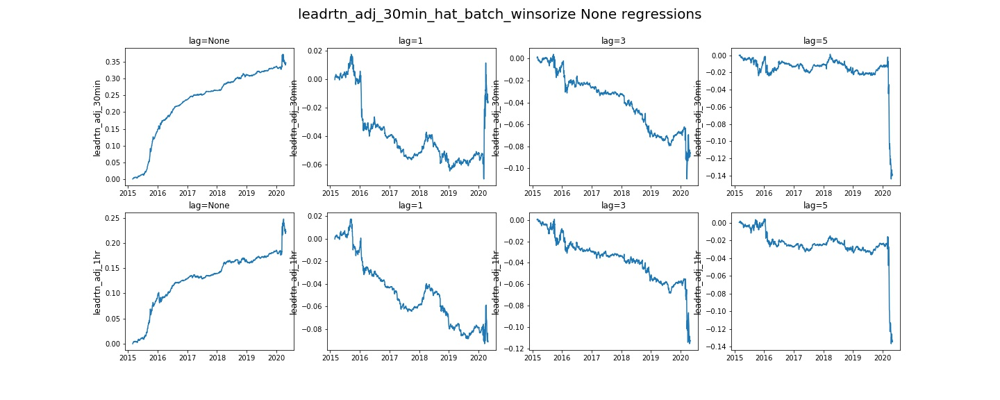

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.019378,0.803288,0.021235,0.000451,63.686642,5.147657,0.418460,0.246128,0.261148,0.246628
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.019378,0.640466,0.017090,0.000292,50.958717,3.745175,0.418460,0.246128,0.261148,0.246628
leadrtn_adj_30min,1.0,10178014,0.888224,-0.254139,0.068706,0.001998,0.000004,5.285134,0.497634,0.425776,0.250489,0.264611,0.248121
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.254139,-0.172856,-0.004677,0.000022,-13.908748,-1.550429,0.425776,0.250489,0.264611,0.248121
leadrtn_adj_30min,3.0,10178014,0.888119,-0.275167,-0.181544,-0.004574,0.000021,-13.436758,-1.670422,0.428174,0.250601,0.266357,0.249586
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.275167,-0.282823,-0.007288,0.000053,-21.421480,-2.076060,0.428174,0.250601,0.266357,0.249586
leadrtn_adj_30min,5.0,10178014,0.888011,-0.289802,-0.275147,-0.008799,0.000077,-26.109676,-2.000123,0.426112,0.250809,0.266886,0.250928
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.289802,-0.308969,-0.009908,0.000098,-29.318356,-1.890960,0.426112,0.250809,0.266886,0.250928


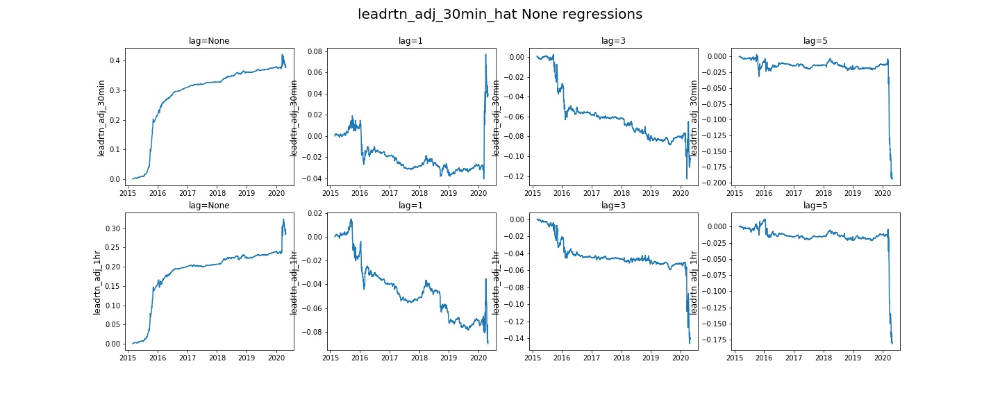

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.207315,0.862231,0.015935,2.539158e-04,47.763897,6.269889,0.444375,0.313672,0.301957,0.290627
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.207315,0.592472,0.011501,1.322627e-04,34.025234,3.660957,0.444375,0.313672,0.301957,0.290627
leadrtn_adj_30min,1.0,10178014,0.888224,-0.613795,-0.017825,-0.000345,-1.192093e-07,-1.005466,-0.135844,0.453430,0.319387,0.306308,0.294044
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.613795,-0.209712,-0.004236,1.794100e-05,-12.405853,-1.879910,0.453430,0.319387,0.306308,0.294044
leadrtn_adj_30min,3.0,10178014,0.888119,-0.650300,-0.172680,-0.003285,1.078844e-05,-9.333414,-1.575438,0.454436,0.320343,0.306758,0.294896
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.650300,-0.262759,-0.004919,2.419949e-05,-14.215344,-1.961444,0.454436,0.320343,0.306758,0.294896
leadrtn_adj_30min,5.0,10178014,0.888011,-0.675951,-0.246604,-0.005540,3.069639e-05,-16.187437,-1.803470,0.454871,0.321317,0.307958,0.295859
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.675951,-0.297361,-0.006677,4.458427e-05,-19.472460,-1.809540,0.454871,0.321317,0.307958,0.295859


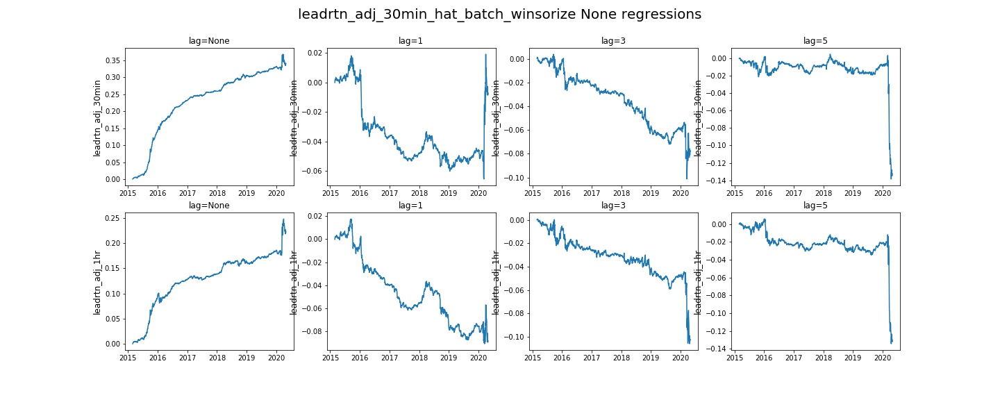

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.005742,0.500507,0.015020,0.000226,44.976749,2.476102,0.307933,0.240249,0.223262,0.211002
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.005742,0.434443,0.013181,0.000174,39.263687,2.042745,0.307933,0.240249,0.223262,0.211002
leadrtn_adj_30min,1.0,10178014,0.888224,-0.042757,0.068620,0.002238,0.000005,6.032856,0.483647,0.314595,0.243771,0.225687,0.212515
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.042757,-0.107152,-0.003356,0.000011,-9.895216,-0.936635,0.314595,0.243771,0.225687,0.212515
leadrtn_adj_30min,3.0,10178014,0.888119,-0.045824,-0.123454,-0.003444,0.000012,-10.227383,-1.067908,0.315500,0.244407,0.226573,0.213077
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.045824,-0.303238,-0.008694,0.000076,-25.831232,-1.813422,0.315500,0.244407,0.226573,0.213077
leadrtn_adj_30min,5.0,10178014,0.888011,-0.048108,-0.345237,-0.013197,0.000174,-39.404842,-2.076265,0.313693,0.244139,0.227099,0.212954
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.048108,-0.371011,-0.014033,0.000197,-41.847073,-1.840977,0.313693,0.244139,0.227099,0.212954


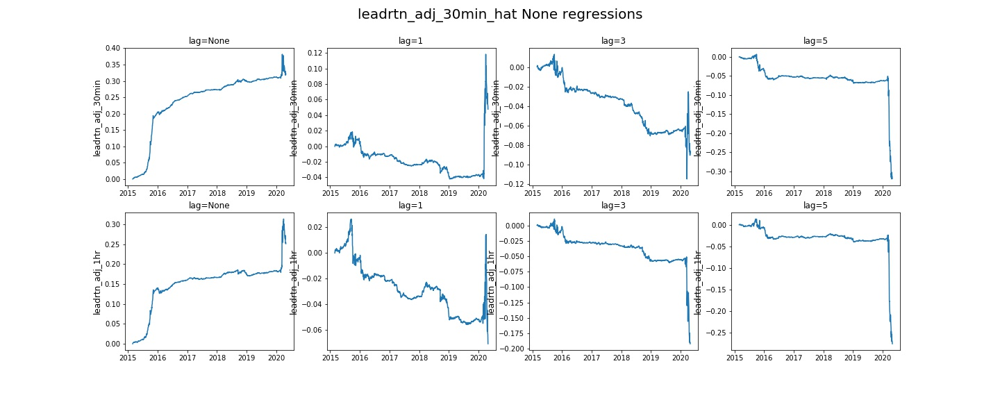

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.050024,0.728219,0.014728,2.169013e-04,43.926510,5.458657,0.489470,0.419417,0.377784,0.359580
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.050024,0.534971,0.011118,1.236200e-04,32.819050,3.052382,0.489470,0.419417,0.377784,0.359580
leadrtn_adj_30min,1.0,10178014,0.888224,-0.159445,-0.008608,-0.000345,-1.192093e-07,-0.507945,-0.063684,0.503453,0.426882,0.383270,0.364664
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.159445,-0.139180,-0.002899,8.404255e-06,-8.667370,-1.242850,0.503453,0.426882,0.383270,0.364664
leadrtn_adj_30min,3.0,10178014,0.888119,-0.169259,-0.219364,-0.004143,1.716614e-05,-12.261933,-1.941469,0.504206,0.428933,0.383835,0.365432
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.169259,-0.346824,-0.006610,4.369020e-05,-19.284889,-2.545647,0.504206,0.428933,0.383835,0.365432
leadrtn_adj_30min,5.0,10178014,0.888011,-0.176044,-0.292453,-0.007234,5.233288e-05,-21.509768,-2.141391,0.505109,0.430002,0.385077,0.365841
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.176044,-0.317323,-0.007824,6.121397e-05,-22.875620,-1.897244,0.505109,0.430002,0.385077,0.365841


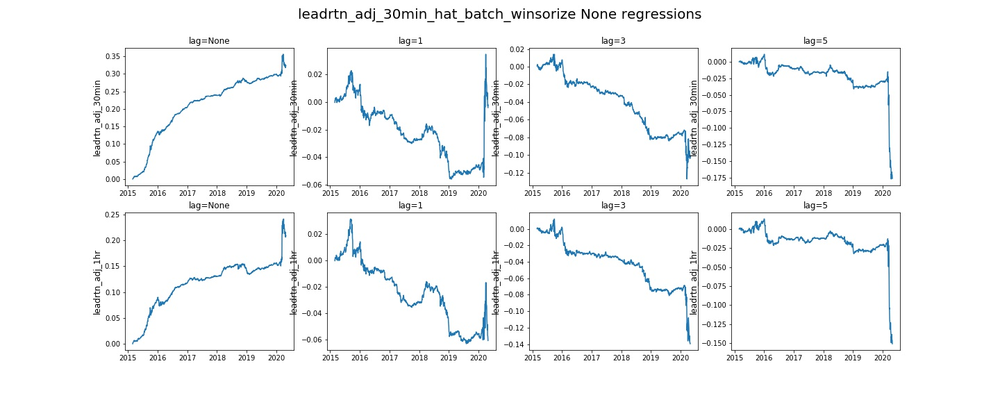

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.032524,0.713414,0.017989,0.000324,53.794559,4.785588,0.407222,0.180896,0.210204,0.197216
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.032524,0.559088,0.014462,0.000209,43.167027,3.300136,0.407222,0.180896,0.210204,0.197216
leadrtn_adj_30min,1.0,10178014,0.888224,-1.079759,0.080071,0.002264,0.000005,6.158110,0.547048,0.412164,0.183702,0.212210,0.197602
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.079759,-0.181519,-0.004846,0.000023,-14.365547,-1.572996,0.412164,0.183702,0.212210,0.197602
leadrtn_adj_30min,3.0,10178014,0.888119,-1.183151,-0.211767,-0.005133,0.000026,-14.924398,-1.956623,0.414004,0.183585,0.213936,0.199172
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.183151,-0.307026,-0.007568,0.000057,-22.404448,-2.253831,0.414004,0.183585,0.213936,0.199172
leadrtn_adj_30min,5.0,10178014,0.888011,-1.248432,-0.273927,-0.008724,0.000076,-25.873405,-2.057597,0.412339,0.183843,0.214586,0.200650
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.248432,-0.346520,-0.010989,0.000121,-32.700245,-2.182659,0.412339,0.183843,0.214586,0.200650


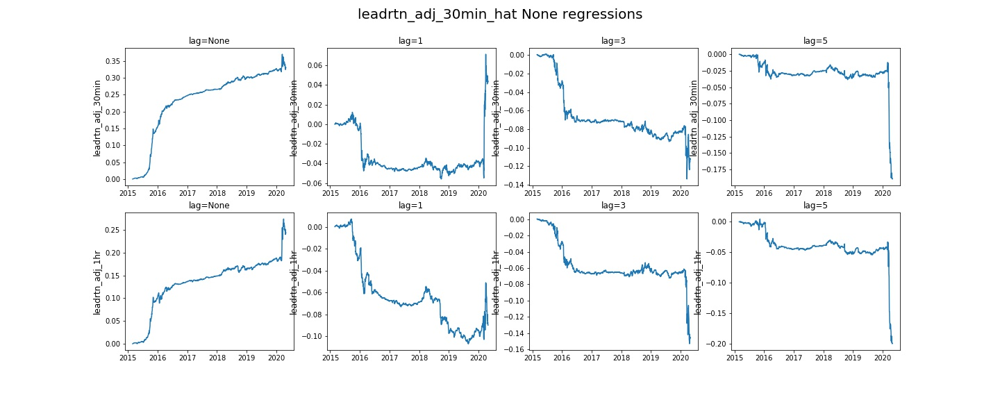

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.877119,0.752539,0.013867,1.922846e-04,41.375488,5.487907,0.412543,0.223038,0.238772,0.228909
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.877119,0.488012,0.009571,9.161234e-05,28.352980,3.224392,0.412543,0.223038,0.238772,0.228909
leadrtn_adj_30min,1.0,10178014,0.888224,-2.748207,-0.008478,-0.000598,-3.576279e-07,-0.494766,-0.066751,0.417957,0.226905,0.241978,0.231046
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.748207,-0.222347,-0.004593,2.110004e-05,-13.448587,-1.831492,0.417957,0.226905,0.241978,0.231046
leadrtn_adj_30min,3.0,10178014,0.888119,-2.932925,-0.172094,-0.003400,1.156330e-05,-9.477008,-1.558255,0.419068,0.227230,0.242476,0.231880
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.932925,-0.277164,-0.005310,2.819300e-05,-15.555619,-2.052235,0.419068,0.227230,0.242476,0.231880
leadrtn_adj_30min,5.0,10178014,0.888011,-3.050091,-0.260871,-0.005741,3.296137e-05,-16.753534,-1.874388,0.419015,0.227984,0.243469,0.232947
leadrtn_adj_1hr,5.0,10178014,0.887955,-3.050091,-0.354018,-0.007824,6.121397e-05,-23.070360,-2.165846,0.419015,0.227984,0.243469,0.232947


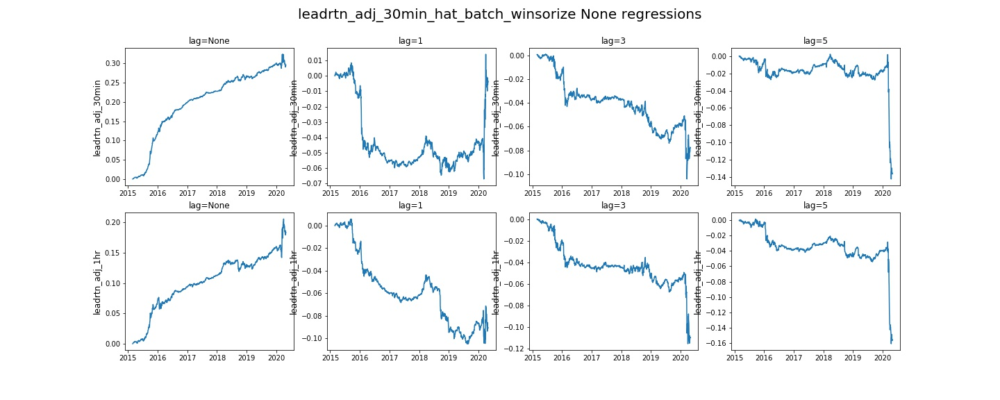

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.006609,0.624631,0.015044,0.000226,45.032921,2.304816,0.287994,0.221683,0.208773,0.201702
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.006609,0.513817,0.012439,0.000155,36.995621,2.025637,0.287994,0.221683,0.208773,0.201702
leadrtn_adj_30min,1.0,10178014,0.888224,-0.037745,0.045886,0.001196,0.000001,3.236519,0.354688,0.294918,0.224763,0.211032,0.202972
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.037745,-0.124761,-0.003155,0.000010,-9.349590,-1.064392,0.294918,0.224763,0.211032,0.202972
leadrtn_adj_30min,3.0,10178014,0.888119,-0.040437,-0.128910,-0.002950,0.000009,-8.504569,-1.046066,0.295708,0.225398,0.211583,0.203373
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.040437,-0.277866,-0.006343,0.000040,-18.707529,-1.562611,0.295708,0.225398,0.211583,0.203373
leadrtn_adj_30min,5.0,10178014,0.888011,-0.042475,-0.341438,-0.010216,0.000104,-30.456987,-1.877682,0.293985,0.225152,0.212354,0.203070
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.042475,-0.340254,-0.010007,0.000100,-29.744858,-1.612618,0.293985,0.225152,0.212354,0.203070


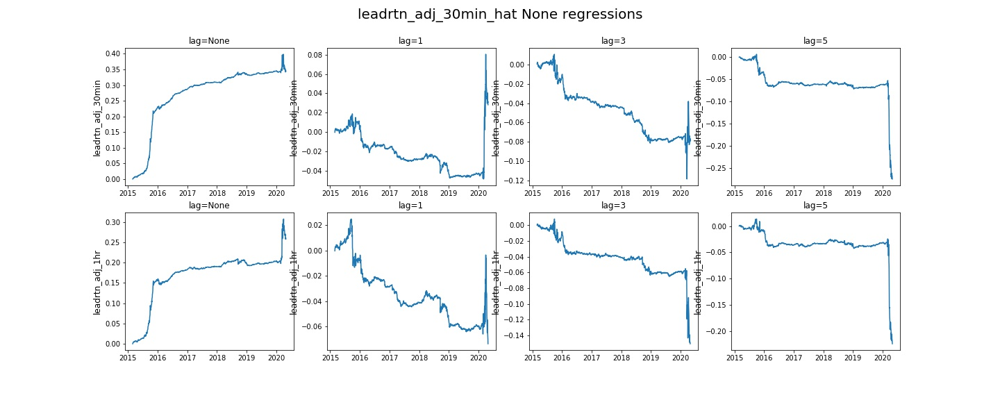

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.054086,0.724879,0.013580,1.844168e-04,40.504086,5.336723,0.515884,0.437877,0.400204,0.385204
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.054086,0.516073,0.009986,9.971857e-05,29.470985,3.102494,0.515884,0.437877,0.400204,0.385204
leadrtn_adj_30min,1.0,10178014,0.888224,-0.144287,-0.024798,-0.000546,2.980232e-07,-1.379686,-0.196398,0.530605,0.444873,0.405425,0.390111
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.144287,-0.171417,-0.003496,1.221895e-05,-10.131618,-1.497859,0.530605,0.444873,0.405425,0.390111
leadrtn_adj_30min,3.0,10178014,0.888119,-0.152609,-0.221180,-0.003921,1.537800e-05,-11.518859,-1.975068,0.531114,0.447008,0.406008,0.390749
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.152609,-0.337099,-0.006045,3.653765e-05,-17.545231,-2.361374,0.531114,0.447008,0.406008,0.390749
leadrtn_adj_30min,5.0,10178014,0.888011,-0.158558,-0.295623,-0.006587,4.339218e-05,-19.443823,-2.146220,0.531979,0.447821,0.407231,0.391130
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.158558,-0.318559,-0.007160,5.125999e-05,-20.830515,-1.878467,0.531979,0.447821,0.407231,0.391130


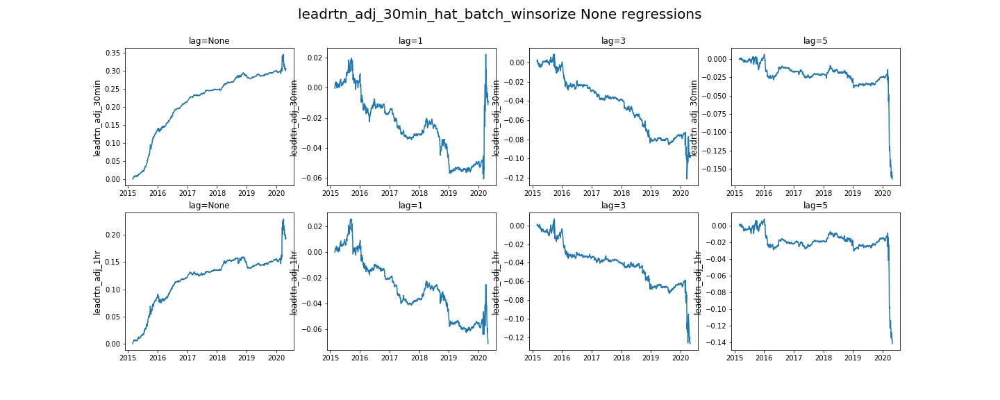

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.021695,0.807977,0.021501,0.000462,64.487396,5.158781,0.420419,0.247679,0.263825,0.248243
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.021695,0.641605,0.017208,0.000296,51.344212,3.737301,0.420419,0.247679,0.263825,0.248243
leadrtn_adj_30min,1.0,10178014,0.888224,-0.258741,0.063720,0.001843,0.000003,4.938270,0.463732,0.427884,0.252019,0.267331,0.249716
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.258741,-0.172884,-0.004728,0.000022,-13.997322,-1.534092,0.427884,0.252019,0.267331,0.249716
leadrtn_adj_30min,3.0,10178014,0.888119,-0.279939,-0.183957,-0.004658,0.000022,-13.684954,-1.694193,0.430380,0.252142,0.269130,0.251215
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.279939,-0.286363,-0.007413,0.000055,-21.781483,-2.100693,0.430380,0.252142,0.269130,0.251215
leadrtn_adj_30min,5.0,10178014,0.888011,-0.294764,-0.277045,-0.008836,0.000078,-26.369911,-2.017084,0.428189,0.252326,0.269695,0.252603
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.294764,-0.310706,-0.009989,0.000100,-29.609758,-1.904506,0.428189,0.252326,0.269695,0.252603


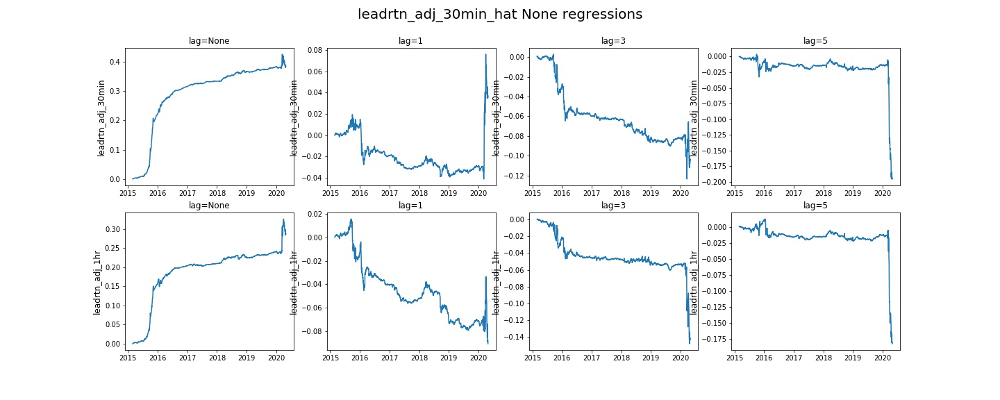

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.215076,0.871356,0.016172,2.615452e-04,48.447720,6.329344,0.445994,0.316327,0.304736,0.292981
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.215076,0.596366,0.011601,1.345873e-04,34.356815,3.661203,0.445994,0.316327,0.304736,0.292981
leadrtn_adj_30min,1.0,10178014,0.888224,-0.633338,-0.022540,-0.000423,1.788139e-07,-1.277304,-0.172019,0.455228,0.322047,0.309149,0.296443
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.633338,-0.210059,-0.004271,1.823902e-05,-12.452400,-1.875722,0.455228,0.322047,0.309149,0.296443
leadrtn_adj_30min,3.0,10178014,0.888119,-0.670848,-0.178142,-0.003321,1.102686e-05,-9.620746,-1.625046,0.456234,0.323046,0.309583,0.297273
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.670848,-0.268530,-0.005003,2.503395e-05,-14.522701,-2.001314,0.456234,0.323046,0.309583,0.297273
leadrtn_adj_30min,5.0,10178014,0.888011,-0.697354,-0.249515,-0.005615,3.153086e-05,-16.404945,-1.826341,0.456679,0.324036,0.310829,0.298258
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.697354,-0.300453,-0.006748,4.553795e-05,-19.711502,-1.825928,0.456679,0.324036,0.310829,0.298258


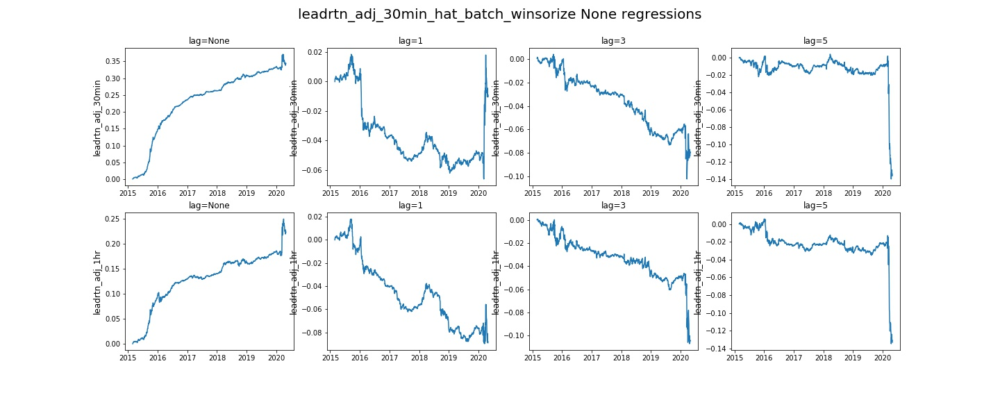

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.069415,0.780476,0.017816,0.000317,53.333626,5.156854,0.410698,0.185884,0.214466,0.203211
leadrtn_adj_1hr,NaN,10178014,0.888220,0.069415,0.581936,0.013739,0.000189,40.915524,3.575207,0.410698,0.185884,0.214466,0.203211
leadrtn_adj_30min,1.0,10178014,0.888224,-0.834058,0.055704,0.001381,0.000002,3.905886,0.408065,0.416063,0.188803,0.216455,0.203480
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.834058,-0.204145,-0.004962,0.000025,-14.794072,-1.785789,0.416063,0.188803,0.216455,0.203480
leadrtn_adj_30min,3.0,10178014,0.888119,-0.925244,-0.201228,-0.004488,0.000020,-12.940607,-1.818859,0.418051,0.188738,0.218217,0.205243
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.925244,-0.280365,-0.006291,0.000040,-18.529234,-2.091468,0.418051,0.188738,0.218217,0.205243
leadrtn_adj_30min,5.0,10178014,0.888011,-0.983157,-0.259201,-0.007230,0.000052,-21.331739,-1.949449,0.416328,0.188915,0.218982,0.206660
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.983157,-0.329736,-0.009151,0.000084,-27.132389,-2.108362,0.416328,0.188915,0.218982,0.206660


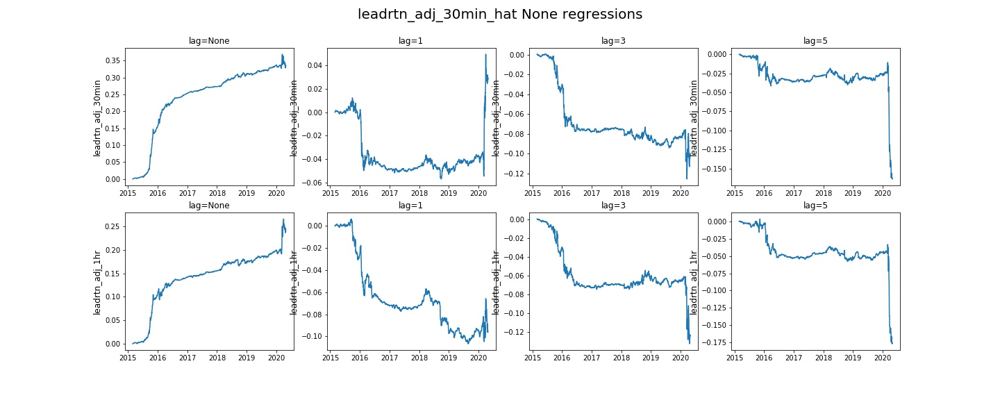

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.702405,0.756685,0.013609,1.851916e-04,40.637295,5.476477,0.420858,0.237956,0.251136,0.243400
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.702405,0.494797,0.009462,8.952618e-05,27.949015,3.430727,0.420858,0.237956,0.251136,0.243400
leadrtn_adj_30min,1.0,10178014,0.888224,-2.301523,-0.003816,-0.000345,-1.192093e-07,-0.216736,-0.031552,0.426523,0.241741,0.254227,0.245317
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.301523,-0.223006,-0.004435,1.966953e-05,-13.099180,-1.843985,0.426523,0.241741,0.254227,0.245317
leadrtn_adj_30min,3.0,10178014,0.888119,-2.459488,-0.140452,-0.002751,7.569790e-06,-7.493929,-1.255745,0.427668,0.242018,0.254686,0.246211
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.459488,-0.226303,-0.004264,1.817942e-05,-12.295805,-1.668561,0.427668,0.242018,0.254686,0.246211
leadrtn_adj_30min,5.0,10178014,0.888011,-2.561339,-0.225868,-0.004790,2.294779e-05,-13.789642,-1.662634,0.427520,0.242662,0.255646,0.247208
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.561339,-0.312911,-0.006565,4.309416e-05,-19.278950,-1.993328,0.427520,0.242662,0.255646,0.247208


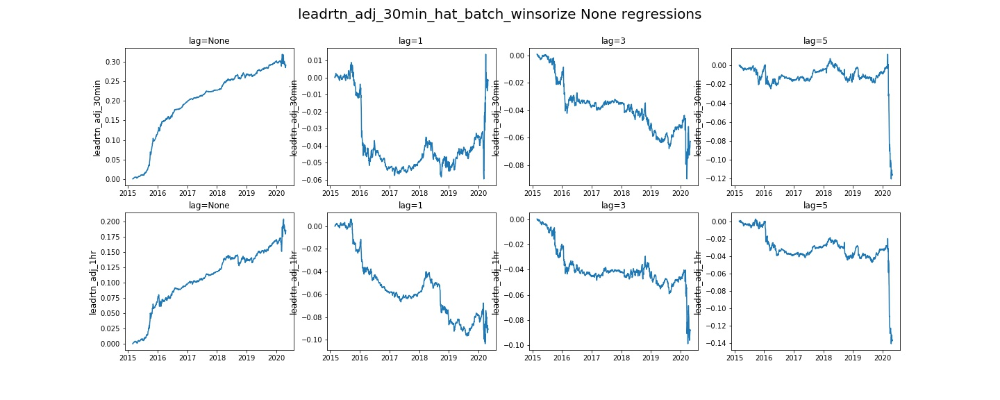

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.047758,0.769443,0.017575,0.000309,52.606941,5.083777,0.411489,0.185127,0.212020,0.201650
leadrtn_adj_1hr,NaN,10178014,0.888220,0.047758,0.577503,0.013635,0.000186,40.638321,3.544545,0.411489,0.185127,0.212020,0.201650
leadrtn_adj_30min,1.0,10178014,0.888224,-0.893563,0.061167,0.001444,0.000002,4.291504,0.444781,0.416639,0.187976,0.213964,0.201960
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.893563,-0.201391,-0.004907,0.000024,-14.601962,-1.756267,0.416639,0.187976,0.213964,0.201960
leadrtn_adj_30min,3.0,10178014,0.888119,-0.988973,-0.196260,-0.004374,0.000019,-12.620345,-1.776566,0.418530,0.187911,0.215653,0.203608
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.988973,-0.275078,-0.006176,0.000038,-18.212114,-2.046509,0.418530,0.187911,0.215653,0.203608
leadrtn_adj_30min,5.0,10178014,0.888011,-1.048977,-0.259994,-0.007304,0.000053,-21.493143,-1.966774,0.416878,0.188087,0.216383,0.204936
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.048977,-0.329220,-0.009190,0.000084,-27.192678,-2.116785,0.416878,0.188087,0.216383,0.204936


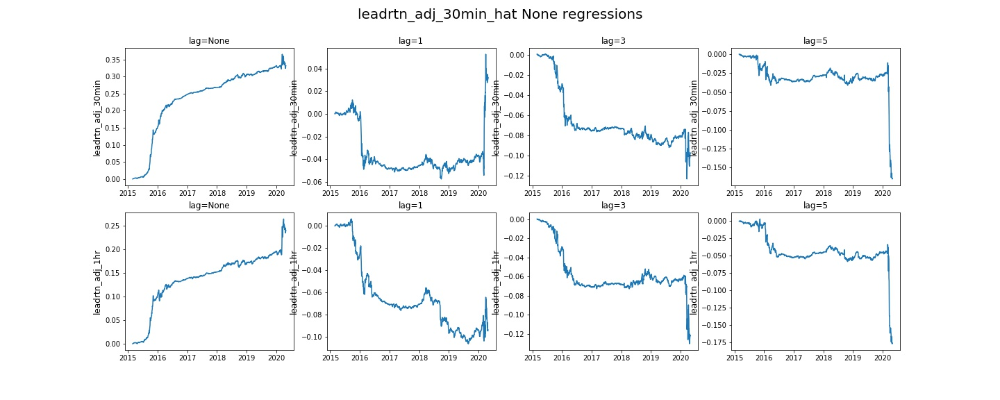

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.743497,0.753194,0.013501,1.822710e-04,40.299816,5.442299,0.420585,0.233743,0.247804,0.240163
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.743497,0.490416,0.009306,8.660555e-05,27.592363,3.411668,0.420585,0.233743,0.247804,0.240163
leadrtn_adj_30min,1.0,10178014,0.888224,-2.392845,-0.004637,-0.000488,-2.384186e-07,-0.262208,-0.038425,0.426106,0.237440,0.250846,0.242057
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.392845,-0.223166,-0.004455,1.984835e-05,-13.049673,-1.836186,0.426106,0.237440,0.250846,0.242057
leadrtn_adj_30min,3.0,10178014,0.888119,-2.557359,-0.139000,-0.002730,7.450581e-06,-7.378597,-1.246059,0.427197,0.237691,0.251298,0.242902
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.557359,-0.222500,-0.004114,1.692772e-05,-12.033239,-1.644044,0.427197,0.237691,0.251298,0.242902
leadrtn_adj_30min,5.0,10178014,0.888011,-2.661430,-0.226413,-0.004765,2.270937e-05,-13.741450,-1.675287,0.427061,0.238303,0.252228,0.243852
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.661430,-0.311927,-0.006514,4.243851e-05,-19.120398,-2.002832,0.427061,0.238303,0.252228,0.243852


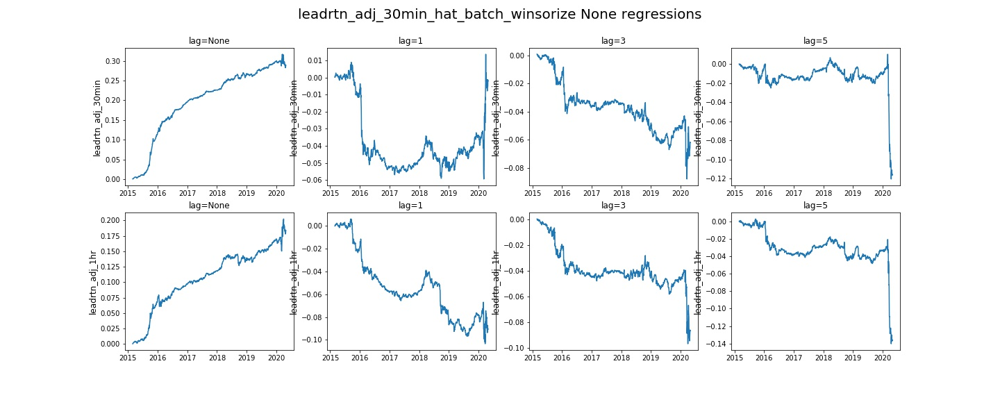

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.009931,0.607441,0.018987,0.000360,56.752533,4.029119,0.467710,0.365723,0.340231,0.326005
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.009931,0.520818,0.016132,0.000260,48.042480,3.290934,0.467710,0.365723,0.340231,0.326005
leadrtn_adj_30min,1.0,10178014,0.888224,-0.068698,0.068281,0.002251,0.000005,6.160278,0.550496,0.479879,0.372419,0.345178,0.329432
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.068698,-0.118467,-0.003868,0.000015,-11.392866,-1.114326,0.479879,0.372419,0.345178,0.329432
leadrtn_adj_30min,3.0,10178014,0.888119,-0.073708,-0.137857,-0.004004,0.000016,-11.631079,-1.281447,0.482248,0.373888,0.346602,0.330572
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.073708,-0.278371,-0.008152,0.000066,-23.972616,-2.135044,0.482248,0.373888,0.346602,0.330572
leadrtn_adj_30min,5.0,10178014,0.888011,-0.077390,-0.311883,-0.012141,0.000147,-36.155285,-2.305704,0.480139,0.373993,0.347468,0.330376
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.077390,-0.310376,-0.011903,0.000142,-35.366215,-1.864134,0.480139,0.373993,0.347468,0.330376


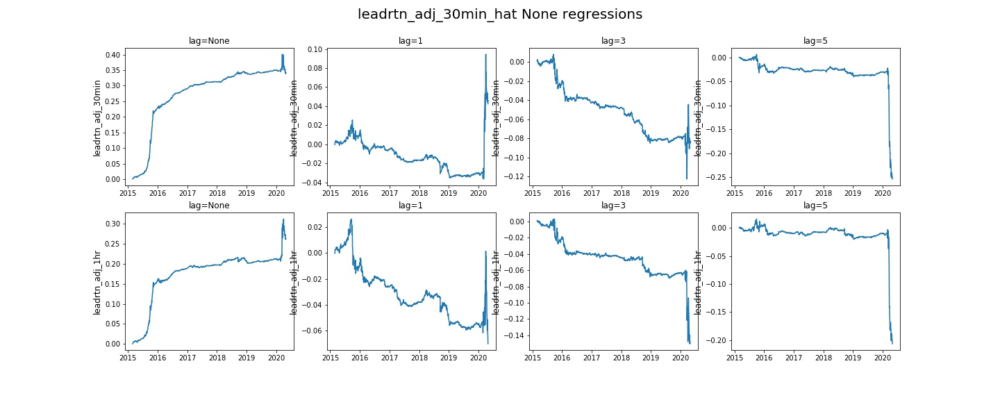

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.054317,0.757258,0.014369,2.064705e-04,42.829651,5.550737,0.514454,0.434377,0.394279,0.378294
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.054317,0.548660,0.010689,1.142621e-04,31.599964,3.333759,0.514454,0.434377,0.394279,0.378294
leadrtn_adj_30min,1.0,10178014,0.888224,-0.157472,-0.019656,-0.000244,5.960464e-08,-1.098926,-0.158104,0.529329,0.442036,0.399890,0.383384
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.157472,-0.147683,-0.002909,8.463860e-06,-8.755104,-1.294941,0.529329,0.442036,0.399890,0.383384
leadrtn_adj_30min,3.0,10178014,0.888119,-0.166456,-0.213321,-0.003891,1.513958e-05,-11.232820,-1.909960,0.529888,0.444081,0.400362,0.384099
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.166456,-0.315941,-0.005720,3.272295e-05,-16.607452,-2.232066,0.529888,0.444081,0.400362,0.384099
leadrtn_adj_30min,5.0,10178014,0.888011,-0.172891,-0.286728,-0.006390,4.082918e-05,-18.921925,-2.101918,0.530787,0.444821,0.401567,0.384269
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.172891,-0.293856,-0.006646,4.416704e-05,-19.266523,-1.761197,0.530787,0.444821,0.401567,0.384269


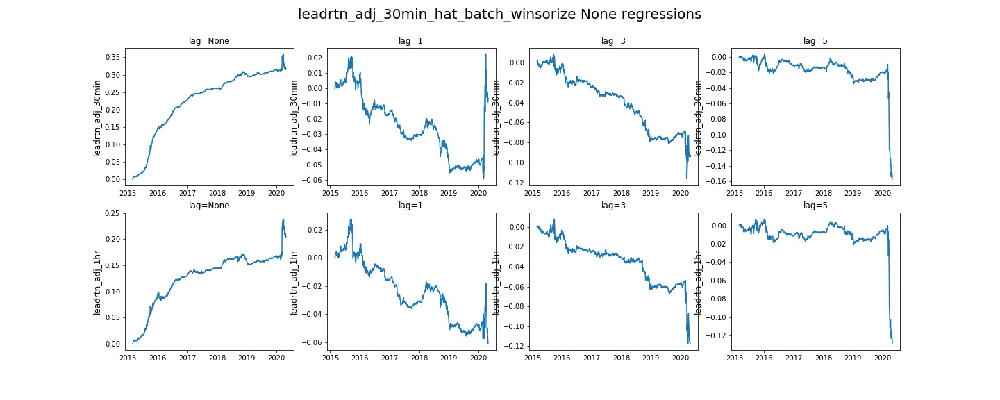

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.068277,0.783220,0.017864,0.000319,53.470634,5.171323,0.411069,0.186394,0.215003,0.203655
leadrtn_adj_1hr,NaN,10178014,0.888220,0.068277,0.583084,0.013750,0.000189,40.953320,3.578367,0.411069,0.186394,0.215003,0.203655
leadrtn_adj_30min,1.0,10178014,0.888224,-0.839471,0.054502,0.001245,0.000002,3.817554,0.399473,0.416477,0.189327,0.217003,0.203927
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.839471,-0.204902,-0.004949,0.000024,-14.831675,-1.790046,0.416477,0.189327,0.217003,0.203927
leadrtn_adj_30min,3.0,10178014,0.888119,-0.931059,-0.202300,-0.004508,0.000020,-12.994308,-1.828231,0.418480,0.189265,0.218776,0.205701
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.931059,-0.281342,-0.006301,0.000040,-18.569410,-2.098327,0.418480,0.189265,0.218776,0.205701
leadrtn_adj_30min,5.0,10178014,0.888011,-0.989271,-0.259451,-0.007222,0.000052,-21.315351,-1.951147,0.416743,0.189441,0.219548,0.207128
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.989271,-0.330252,-0.009158,0.000084,-27.130379,-2.111139,0.416743,0.189441,0.219548,0.207128


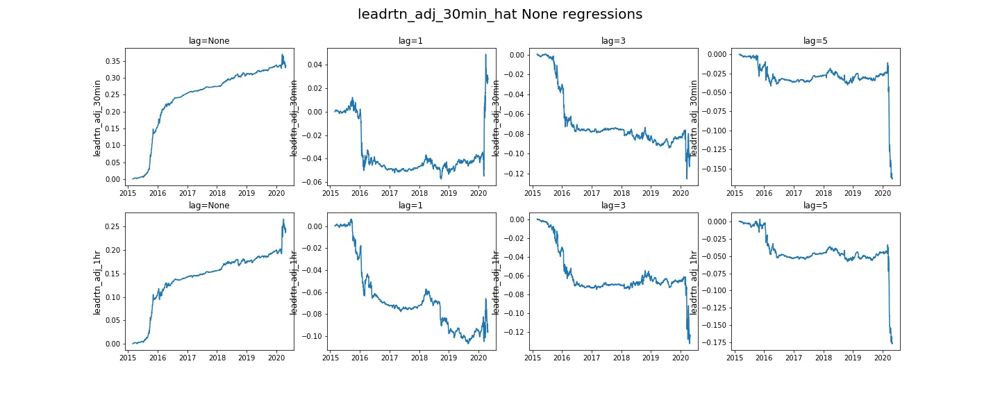

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.709004,0.758279,0.013637,1.859665e-04,40.715111,5.485482,0.421234,0.238603,0.251699,0.243968
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.709004,0.495351,0.009478,8.982420e-05,27.979151,3.430732,0.421234,0.238603,0.251699,0.243968
leadrtn_adj_30min,1.0,10178014,0.888224,-2.317891,-0.004483,-0.000488,-2.384186e-07,-0.254605,-0.037064,0.426928,0.242403,0.254802,0.245895
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.317891,-0.223590,-0.004435,1.966953e-05,-13.133287,-1.849081,0.426928,0.242403,0.254802,0.245895
leadrtn_adj_30min,3.0,10178014,0.888119,-2.476665,-0.141251,-0.002762,7.629395e-06,-7.536617,-1.262475,0.428079,0.242680,0.255266,0.246792
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.476665,-0.227113,-0.004250,1.806021e-05,-12.340707,-1.673599,0.428079,0.242680,0.255266,0.246792
leadrtn_adj_30min,5.0,10178014,0.888011,-2.579213,-0.226379,-0.004790,2.294779e-05,-13.825495,-1.665972,0.427930,0.243329,0.256226,0.247791
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.579213,-0.313620,-0.006592,4.345179e-05,-19.324022,-1.996256,0.427930,0.243329,0.256226,0.247791


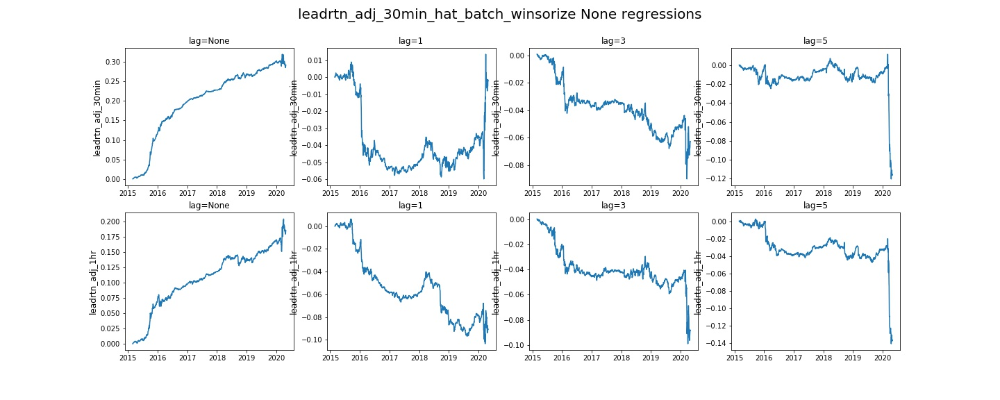

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.031608,0.716123,0.018061,0.000326,54.011993,4.794514,0.405855,0.177878,0.209493,0.196484
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.031608,0.562735,0.014565,0.000212,43.484940,3.322273,0.405855,0.177878,0.209493,0.196484
leadrtn_adj_30min,1.0,10178014,0.888224,-1.080106,0.082376,0.002342,0.000005,6.337376,0.562856,0.410746,0.180634,0.211490,0.196828
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.080106,-0.178530,-0.004772,0.000023,-14.138578,-1.552290,0.410746,0.180634,0.211490,0.196828
leadrtn_adj_30min,3.0,10178014,0.888119,-1.183256,-0.210954,-0.005139,0.000026,-14.880325,-1.951606,0.412591,0.180509,0.213211,0.198419
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.183256,-0.305798,-0.007537,0.000057,-22.327539,-2.248647,0.412591,0.180509,0.213211,0.198419
leadrtn_adj_30min,5.0,10178014,0.888011,-1.248322,-0.271873,-0.008673,0.000075,-25.676323,-2.042438,0.410939,0.180773,0.213868,0.199908
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.248322,-0.343853,-0.010894,0.000119,-32.452698,-2.166511,0.410939,0.180773,0.213868,0.199908


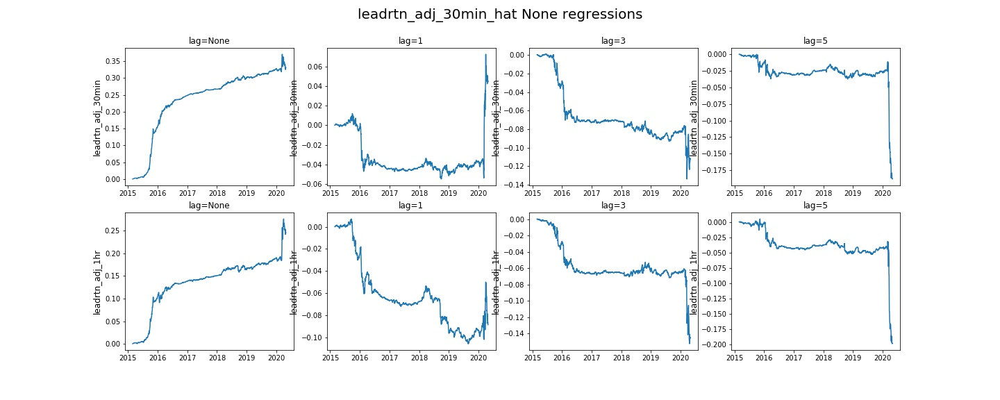

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.871258,0.751450,0.013852,1.918674e-04,41.324253,5.478759,0.412025,0.222083,0.238169,0.228297
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.871258,0.488343,0.009584,9.185076e-05,28.374546,3.226452,0.412025,0.222083,0.238169,0.228297
leadrtn_adj_30min,1.0,10178014,0.888224,-2.744280,-0.007215,-0.000488,-2.384186e-07,-0.421012,-0.056792,0.417389,0.225927,0.241365,0.230408
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.744280,-0.221312,-0.004593,2.110004e-05,-13.387456,-1.823590,0.417389,0.225927,0.241365,0.230408
leadrtn_adj_30min,3.0,10178014,0.888119,-2.928799,-0.171270,-0.003365,1.132488e-05,-9.430097,-1.550932,0.418500,0.226247,0.241843,0.231241
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.928799,-0.275562,-0.005270,2.777576e-05,-15.464702,-2.042294,0.418500,0.226247,0.241843,0.231241
leadrtn_adj_30min,5.0,10178014,0.888011,-3.045624,-0.259702,-0.005726,3.278255e-05,-16.681482,-1.866280,0.418452,0.226990,0.242842,0.232314
leadrtn_adj_1hr,5.0,10178014,0.887955,-3.045624,-0.352982,-0.007797,6.079674e-05,-23.005901,-2.160591,0.418452,0.226990,0.242842,0.232314


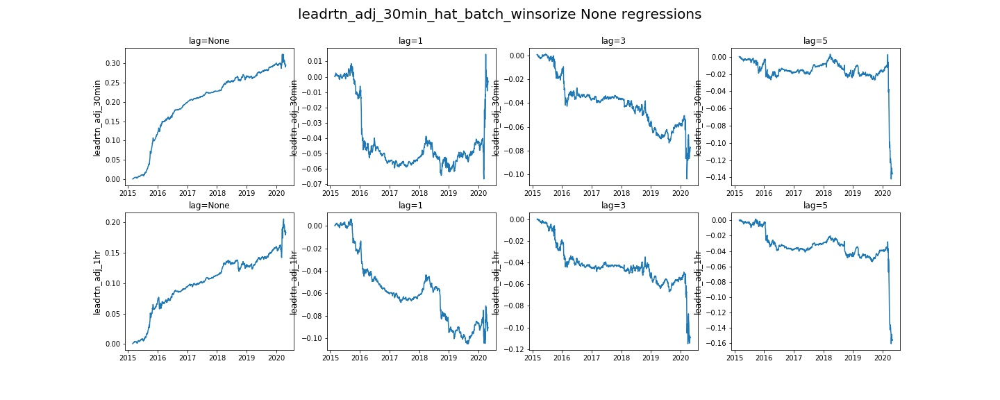

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.012878,0.720467,0.018134,0.000329,54.310909,4.840844,0.407880,0.184565,0.213328,0.199422
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.012878,0.559728,0.014468,0.000209,43.172356,3.306419,0.407880,0.184565,0.213328,0.199422
leadrtn_adj_30min,1.0,10178014,0.888224,-1.018339,0.073220,0.002128,0.000005,5.629189,0.503334,0.413056,0.187472,0.215373,0.199788
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.018339,-0.186400,-0.004949,0.000024,-14.740825,-1.615829,0.413056,0.187472,0.215373,0.199788
leadrtn_adj_30min,3.0,10178014,0.888119,-1.117315,-0.216848,-0.005265,0.000028,-15.288902,-1.998295,0.414988,0.187361,0.217182,0.201451
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.117315,-0.313004,-0.007732,0.000060,-22.811831,-2.300411,0.414988,0.187361,0.217182,0.201451
leadrtn_adj_30min,5.0,10178014,0.888011,-1.180517,-0.275455,-0.008748,0.000077,-25.932734,-2.058584,0.413248,0.187608,0.217849,0.203010
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.180517,-0.349450,-0.011038,0.000122,-32.888138,-2.189893,0.413248,0.187608,0.217849,0.203010


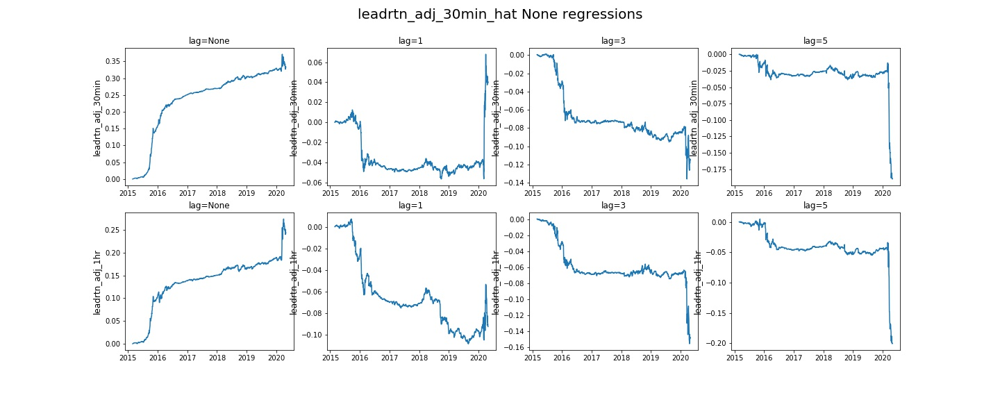

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.840113,0.759839,0.014052,1.974702e-04,41.954460,5.542069,0.413197,0.227560,0.242222,0.232296
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.840113,0.493624,0.009723,9.453297e-05,28.810223,3.240057,0.413197,0.227560,0.242222,0.232296
leadrtn_adj_30min,1.0,10178014,0.888224,-2.651630,-0.009012,-0.000598,-3.576279e-07,-0.528040,-0.070664,0.418798,0.231527,0.245477,0.234460
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.651630,-0.222775,-0.004619,2.133846e-05,-13.533479,-1.839771,0.418798,0.231527,0.245477,0.234460
leadrtn_adj_30min,3.0,10178014,0.888119,-2.829054,-0.173208,-0.003427,1.174212e-05,-9.600889,-1.560810,0.419959,0.231876,0.245991,0.235330
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.829054,-0.281871,-0.005454,2.974272e-05,-15.891256,-2.082819,0.419959,0.231876,0.245991,0.235330
leadrtn_adj_30min,5.0,10178014,0.888011,-2.943942,-0.260539,-0.005726,3.278255e-05,-16.823566,-1.867172,0.419885,0.232649,0.247010,0.236428
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.943942,-0.353730,-0.007843,6.151199e-05,-23.153175,-2.155899,0.419885,0.232649,0.247010,0.236428


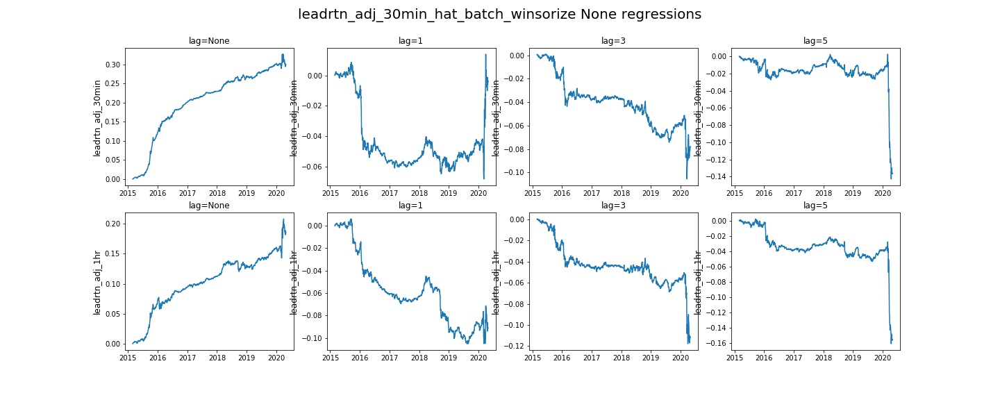

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,0.068938,0.778264,0.017762,0.000315,53.153309,5.149418,0.411883,0.188576,0.214986,0.203749
leadrtn_adj_1hr,NaN,10178014,0.888220,0.068938,0.578710,0.013641,0.000186,40.649418,3.553979,0.411883,0.188576,0.214986,0.203749
leadrtn_adj_30min,1.0,10178014,0.888224,-0.832322,0.053442,0.001221,0.000001,3.745371,0.391401,0.417295,0.191546,0.216984,0.204050
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.832322,-0.207037,-0.005021,0.000025,-14.988995,-1.806082,0.417295,0.191546,0.216984,0.204050
leadrtn_adj_30min,3.0,10178014,0.888119,-0.923644,-0.201877,-0.004502,0.000020,-12.966764,-1.821398,0.419286,0.191495,0.218756,0.205801
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.923644,-0.281444,-0.006315,0.000040,-18.584551,-2.095585,0.419286,0.191495,0.218756,0.205801
leadrtn_adj_30min,5.0,10178014,0.888011,-0.981715,-0.261377,-0.007283,0.000053,-21.504662,-1.965757,0.417553,0.191664,0.219517,0.207209
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.981715,-0.332413,-0.009235,0.000085,-27.337198,-2.124783,0.417553,0.191664,0.219517,0.207209


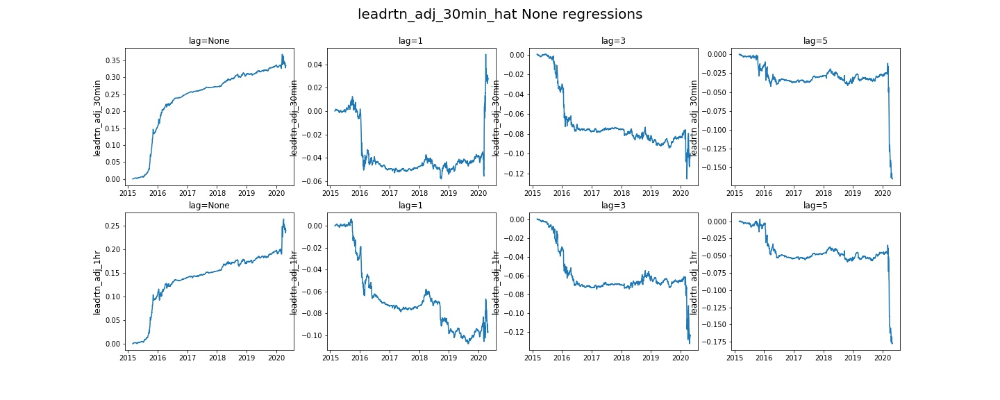

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.707950,0.757356,0.013615,1.853704e-04,40.666077,5.484586,0.421257,0.238850,0.251681,0.243985
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.707950,0.493846,0.009433,8.898973e-05,27.895187,3.425532,0.421257,0.238850,0.251681,0.243985
leadrtn_adj_30min,1.0,10178014,0.888224,-2.304612,-0.005331,-0.000488,-2.384186e-07,-0.302816,-0.044097,0.426959,0.242656,0.254784,0.245925
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.304612,-0.224239,-0.004462,1.990795e-05,-13.171984,-1.854059,0.426959,0.242656,0.254784,0.245925
leadrtn_adj_30min,3.0,10178014,0.888119,-2.462702,-0.140514,-0.002751,7.569790e-06,-7.497918,-1.255960,0.428105,0.242939,0.255264,0.246825
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.462702,-0.227093,-0.004250,1.806021e-05,-12.339905,-1.673083,0.428105,0.242939,0.255264,0.246825
leadrtn_adj_30min,5.0,10178014,0.888011,-2.564859,-0.226811,-0.004803,2.306700e-05,-13.846766,-1.669348,0.427956,0.243594,0.256215,0.247819
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.564859,-0.313939,-0.006601,4.357100e-05,-19.343609,-1.998866,0.427956,0.243594,0.256215,0.247819


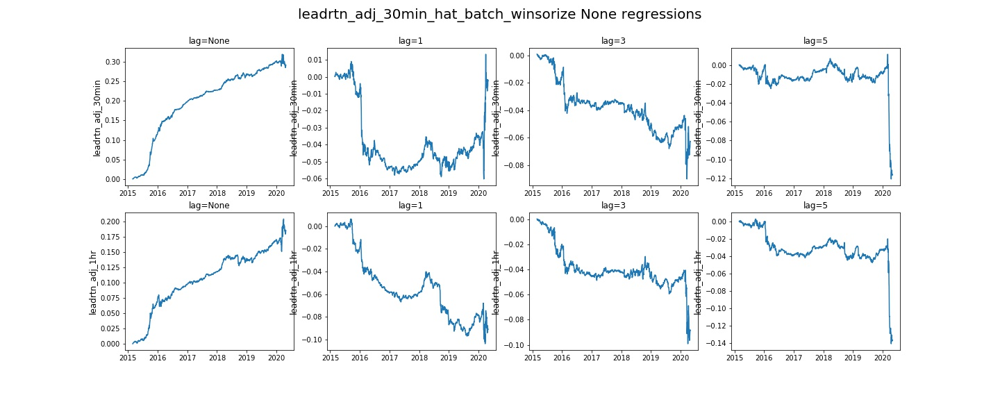

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.005199,0.539092,0.014435,0.000208,43.170204,2.156668,0.267351,0.206375,0.189622,0.181790
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.005199,0.474924,0.012807,0.000164,38.142548,1.875105,0.267351,0.206375,0.189622,0.181790
leadrtn_adj_30min,1.0,10178014,0.888224,-0.037193,0.082852,0.002316,0.000005,6.441116,0.568763,0.273410,0.209519,0.191677,0.183002
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.037193,-0.095669,-0.002663,0.000007,-7.769279,-0.879646,0.273410,0.209519,0.191677,0.183002
leadrtn_adj_30min,3.0,10178014,0.888119,-0.039898,-0.115918,-0.002899,0.000008,-8.448533,-0.987255,0.274150,0.210147,0.192359,0.183433
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.039898,-0.280995,-0.007059,0.000050,-20.915079,-1.537540,0.274150,0.210147,0.192359,0.183433
leadrtn_adj_30min,5.0,10178014,0.888011,-0.041825,-0.341416,-0.011642,0.000136,-34.742245,-1.799419,0.272897,0.209994,0.192895,0.183289
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.041825,-0.356651,-0.011968,0.000143,-35.584454,-1.588113,0.272897,0.209994,0.192895,0.183289


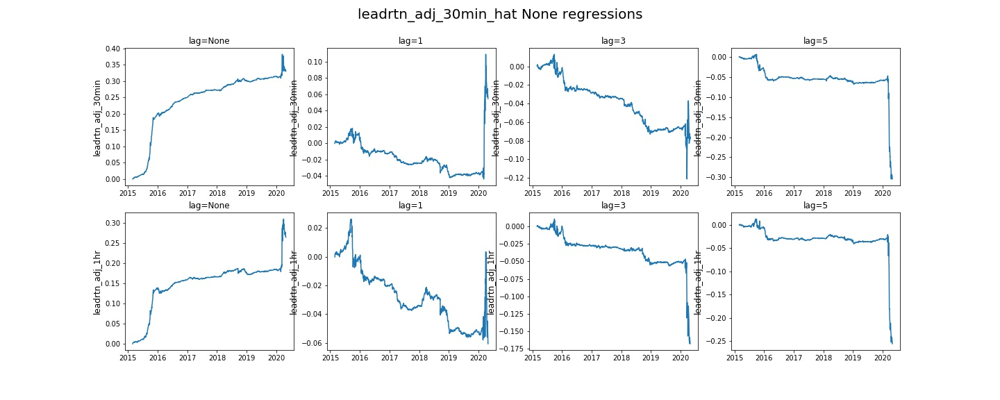

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.044771,0.718685,0.014217,2.021194e-04,42.384983,5.426115,0.499980,0.422724,0.378372,0.361057
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.044771,0.537123,0.010907,1.189709e-04,32.188965,3.099206,0.499980,0.422724,0.378372,0.361057
leadrtn_adj_30min,1.0,10178014,0.888224,-0.140509,0.007002,0.000345,1.192093e-07,0.402975,0.052139,0.513801,0.430140,0.383481,0.365788
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.140509,-0.132914,-0.002773,7.688999e-06,-8.092079,-1.215395,0.513801,0.430140,0.383481,0.365788
leadrtn_adj_30min,3.0,10178014,0.888119,-0.149124,-0.207903,-0.003952,1.561642e-05,-11.479564,-1.835774,0.514489,0.432103,0.384083,0.366593
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.149124,-0.333722,-0.006239,3.892183e-05,-18.235779,-2.427372,0.514489,0.432103,0.384083,0.366593
leadrtn_adj_30min,5.0,10178014,0.888011,-0.155114,-0.277859,-0.006717,4.512072e-05,-19.828226,-2.007819,0.515405,0.433000,0.385215,0.367039
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.155114,-0.306709,-0.007357,5.412102e-05,-21.392357,-1.817105,0.515405,0.433000,0.385215,0.367039


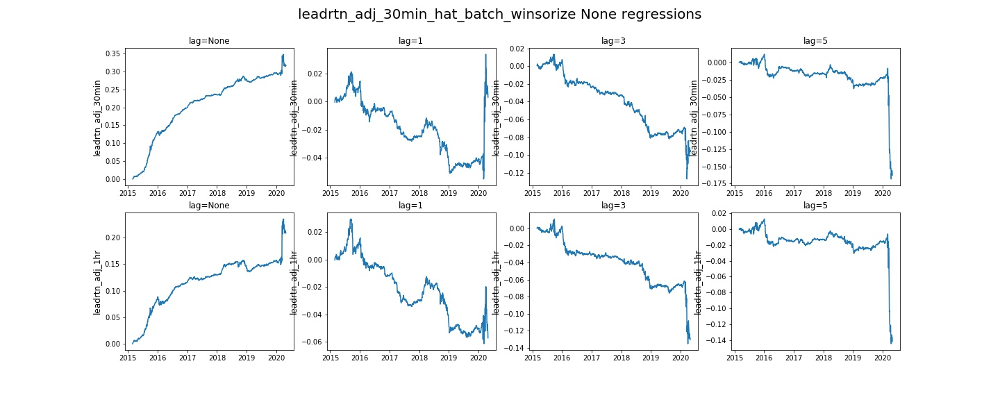

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.014718,0.722667,0.018183,0.000331,54.451443,4.853083,0.408332,0.185199,0.213975,0.199948
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.014718,0.560683,0.014491,0.000210,43.219841,3.308384,0.408332,0.185199,0.213975,0.199948
leadrtn_adj_30min,1.0,10178014,0.888224,-1.024200,0.072243,0.002086,0.000004,5.550584,0.496726,0.413550,0.188120,0.216031,0.200318
leadrtn_adj_1hr,1.0,10178014,0.888168,-1.024200,-0.186945,-0.004980,0.000025,-14.773051,-1.618009,0.413550,0.188120,0.216031,0.200318
leadrtn_adj_30min,3.0,10178014,0.888119,-1.123531,-0.217829,-0.005287,0.000028,-15.348695,-2.006990,0.415497,0.188012,0.217852,0.201991
leadrtn_adj_1hr,3.0,10178014,0.888064,-1.123531,-0.313968,-0.007759,0.000060,-22.864843,-2.306996,0.415497,0.188012,0.217852,0.201991
leadrtn_adj_30min,5.0,10178014,0.888011,-1.187009,-0.275716,-0.008752,0.000077,-25.930349,-2.060351,0.413743,0.188258,0.218525,0.203560
leadrtn_adj_1hr,5.0,10178014,0.887955,-1.187009,-0.349958,-0.011040,0.000122,-32.904781,-2.192366,0.413743,0.188258,0.218525,0.203560


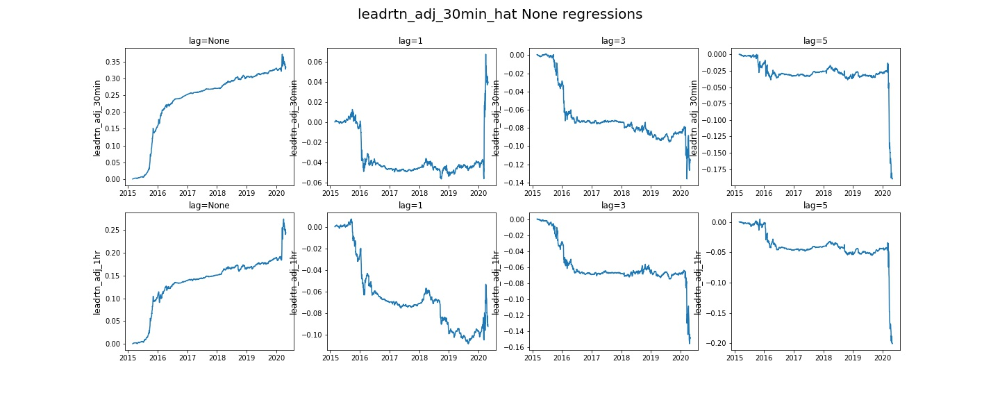

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.844526,0.761814,0.014086,1.984239e-04,42.064358,5.553476,0.413594,0.228241,0.242825,0.232885
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.844526,0.494544,0.009747,9.500980e-05,28.869930,3.240591,0.413594,0.228241,0.242825,0.232885
leadrtn_adj_30min,1.0,10178014,0.888224,-2.666157,-0.009496,-0.000488,-2.384186e-07,-0.556491,-0.074400,0.419223,0.232221,0.246093,0.235062
leadrtn_adj_1hr,1.0,10178014,0.888168,-2.666157,-0.223022,-0.004613,2.127886e-05,-13.551104,-1.841669,0.419223,0.232221,0.246093,0.235062
leadrtn_adj_30min,3.0,10178014,0.888119,-2.844411,-0.173803,-0.003444,1.186132e-05,-9.637816,-1.565436,0.420392,0.232573,0.246609,0.235933
leadrtn_adj_1hr,3.0,10178014,0.888064,-2.844411,-0.282713,-0.005454,2.974272e-05,-15.943689,-2.088341,0.420392,0.232573,0.246609,0.235933
leadrtn_adj_30min,5.0,10178014,0.888011,-2.960031,-0.260978,-0.005741,3.296137e-05,-16.861731,-1.869929,0.420319,0.233352,0.247632,0.237034
leadrtn_adj_1hr,5.0,10178014,0.887955,-2.960031,-0.354317,-0.007851,6.163120e-05,-23.198969,-2.157620,0.420319,0.233352,0.247632,0.237034


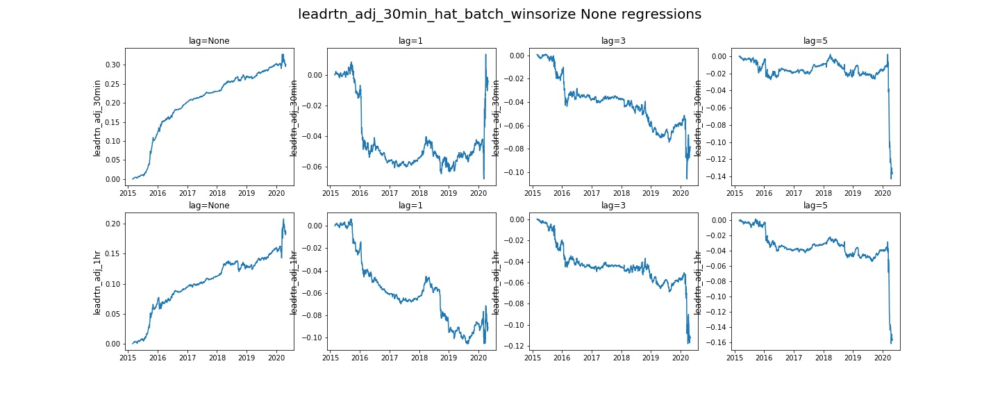

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.003564,0.665532,0.014703,0.000216,44.026318,2.424599,0.297610,0.233555,0.215501,0.210229
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.003564,0.540819,0.012065,0.000146,35.810101,2.142968,0.297610,0.233555,0.215501,0.210229
leadrtn_adj_30min,1.0,10178014,0.888224,-0.039348,0.045087,0.001092,0.000001,2.912431,0.358402,0.304783,0.237230,0.217913,0.211795
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.039348,-0.135336,-0.003088,0.000010,-9.356150,-1.180988,0.304783,0.237230,0.217913,0.211795
leadrtn_adj_30min,3.0,10178014,0.888119,-0.042507,-0.124215,-0.002697,0.000007,-7.695253,-1.019536,0.305507,0.237878,0.218469,0.212219
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.042507,-0.267070,-0.005700,0.000032,-16.825872,-1.552792,0.305507,0.237878,0.218469,0.212219
leadrtn_adj_30min,5.0,10178014,0.888011,-0.044814,-0.333949,-0.009277,0.000086,-27.672602,-1.871213,0.304275,0.237830,0.219068,0.212006
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.044814,-0.335772,-0.009135,0.000083,-27.049652,-1.603207,0.304275,0.237830,0.219068,0.212006


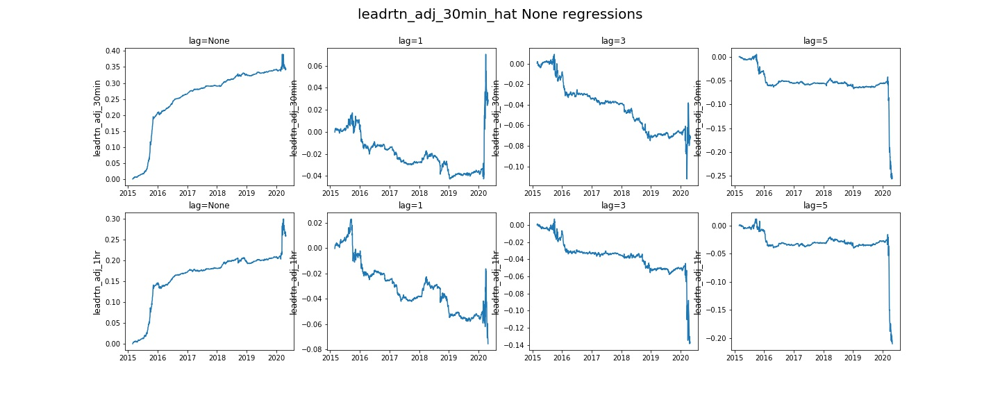

,,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26
returns,lag,,,,,,,,,,,,
leadrtn_adj_30min,NaN,10178014,0.888276,-0.043554,0.722415,0.012967,1.681447e-04,38.766190,5.458351,0.515985,0.440862,0.398579,0.385817
leadrtn_adj_1hr,NaN,10178014,0.888220,-0.043554,0.519929,0.009637,9.286404e-05,28.376045,3.334148,0.515985,0.440862,0.398579,0.385817
leadrtn_adj_30min,1.0,10178014,0.888224,-0.132400,-0.016805,-0.000345,-1.192093e-07,-0.889632,-0.138697,0.529510,0.447915,0.403217,0.390180
leadrtn_adj_1hr,1.0,10178014,0.888168,-0.132400,-0.168060,-0.003202,1.025200e-05,-9.467967,-1.494697,0.529510,0.447915,0.403217,0.390180
leadrtn_adj_30min,3.0,10178014,0.888119,-0.140526,-0.191327,-0.003400,1.156330e-05,-9.682739,-1.685272,0.530175,0.449829,0.403919,0.391014
leadrtn_adj_1hr,3.0,10178014,0.888064,-0.140526,-0.308296,-0.005332,2.843142e-05,-15.501033,-2.153338,0.530175,0.449829,0.403919,0.391014
leadrtn_adj_30min,5.0,10178014,0.888011,-0.146282,-0.283475,-0.006000,3.600121e-05,-17.735661,-1.991368,0.531048,0.450614,0.404983,0.391487
leadrtn_adj_1hr,5.0,10178014,0.887955,-0.146282,-0.298809,-0.006436,4.142523e-05,-18.608210,-1.751747,0.531048,0.450614,0.404983,0.391487


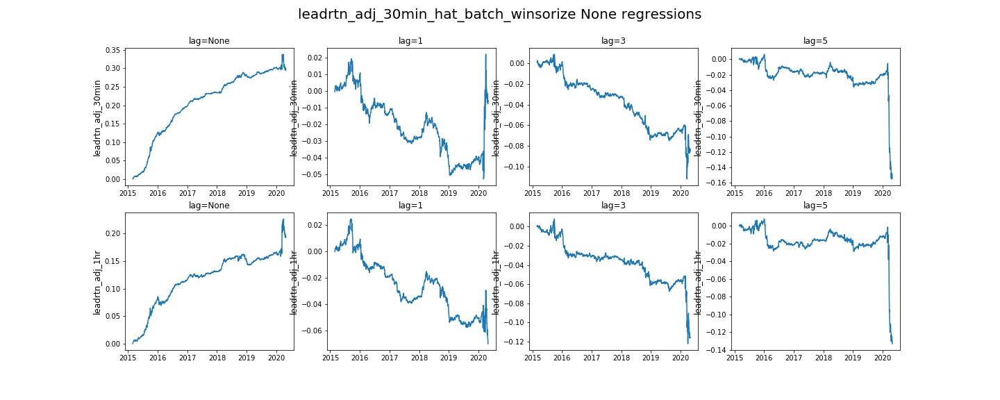

KeyboardInterrupt: 

In [43]:
# run the  hyperparameter grid 
#####################################
results = []
for i, hpso in enumerate( random_grid ):
    runner = OnlineRunner( hps=hpso, tensorboard=False, verbose=True ).set( memoize=True )                            
    runner.data = feature_builder
    disp( f'Running runner={runner.hash()} with hps={hpso.hash()}', h=2 )
    dfo = runner( )                            
    results.append( [runner.hash(), hpso,  runner.output_meta.copy()] )         
    # cache the results in case things break
    with open( f'{hpgrid_cache}/cache.pkl', 'wb' ) as fp:
        pickle.dump( results, fp )            
    disp( hpso )
    for profile in runner.output_meta                    :
        main_fig = profile['main_fig']
        exp_fig = profile['exp_fig']
        reg_fig = profile['reg_fig']
        reg_df = profile['regressions']
        if not reg_df.empty:
            reg_df = reg_df.set_index( ['returns', 'lag'] )
        disp( profile.pop( 'feature' ), profile.pop( 'transform' ), h=3, hr=True )
        # profile = pd.DataFrame( profile, index=['value'] )
        # disp( profile )
        disp( 'Regressions', reg_df, h=4 )
        # disp( main_fig )
        # disp( exp_fig )
        disp( reg_fig )    

In [59]:
regs = []
for hsh, hpso, profiles in results:
    reg = profiles[1]['regressions'].iloc[:2].assign(
        hash=hsh,
        lr=hpso.lr,
        hl_1=hpso.hl_1,
        hl_2=hpso.hl_2,
        omega_lr=hpso.omega_lr,
        ridge=hpso.ridge
    ).set_index(['hash','hl_1', 'hl_2', 'omega_lr', 'ridge'] ).reset_index()
    regs.append( reg )

disp( pd.concat( regs ) )

,hash,hl_1,hl_2,omega_lr,ridge,returns,lag,n,finite_frac,tilt,pmSR,ic,r2,tstat,DK_60,ac_1,ac_2,ac_13,ac_26,lr
0,OnlineRunner_7177652e6,100,1000,1000,0.000001,leadrtn_adj_30min,NaN,10178014,0.888276,-0.186124,0.862760,0.015186,0.000231,45.498306,6.269065,0.458642,0.333938,0.321157,0.313236,100
1,OnlineRunner_7177652e6,100,1000,1000,0.000001,leadrtn_adj_1hr,NaN,10178014,0.888220,-0.186124,0.576971,0.010689,0.000114,31.519733,3.798016,0.458642,0.333938,0.321157,0.313236,100
0,OnlineRunner_36a966120,100,10000,100,0.001000,leadrtn_adj_30min,NaN,10178014,0.888276,-0.712529,0.759163,0.013648,0.000186,40.752819,5.495476,0.421590,0.239402,0.252177,0.244484,1000
1,OnlineRunner_36a966120,100,10000,100,0.001000,leadrtn_adj_1hr,NaN,10178014,0.888220,-0.712529,0.494613,0.009452,0.000089,27.935768,3.427035,0.421590,0.239402,0.252177,0.244484,1000
0,OnlineRunner_3d9cfc225,50,10000,100,0.001000,leadrtn_adj_30min,NaN,10178014,0.888276,-0.226664,0.879774,0.016483,0.000272,49.313274,6.440161,0.440284,0.321197,0.305830,0.293556,100
1,OnlineRunner_3d9cfc225,50,10000,100,0.001000,leadrtn_adj_1hr,NaN,10178014,0.888220,-0.226664,0.590927,0.011593,0.000134,34.323837,3.650051,0.440284,0.321197,0.305830,0.293556,100
0,OnlineRunner_ede4e754d,100,10000,1000,0.001000,leadrtn_adj_30min,NaN,10178014,0.888276,-0.057328,0.721524,0.013862,0.000192,41.353035,5.337177,0.506526,0.435849,0.399164,0.383702,10
1,OnlineRunner_ede4e754d,100,10000,1000,0.001000,leadrtn_adj_1hr,NaN,10178014,0.888220,-0.057328,0.504017,0.010034,0.000101,29.601311,3.003425,0.506526,0.435849,0.399164,0.383702,10
0,OnlineRunner_ac3af58fa,100,10000,100,0.001000,leadrtn_adj_30min,NaN,10178014,0.888276,-0.206956,0.877514,0.015654,0.000245,46.877872,6.414108,0.451525,0.337596,0.321445,0.312824,100
1,OnlineRunner_ac3af58fa,100,10000,100,0.001000,leadrtn_adj_1hr,NaN,10178014,0.888220,-0.206956,0.575806,0.010764,0.000116,31.771259,3.822577,0.451525,0.337596,0.321445,0.312824,100


In [ ]:
# online learning model (using linear rnn) s
###############################################
%inline
mx = mx.reload()
mxtr = mxtr.reload()
mx.Config.start()

disp( mx.tensorboard.start_server() )
disp( mx.tensorboard.start( clear=True ) )

    
hps.online = mx.HPSet(
    features=(
      ['open_unadj_30min', 'log_open_unadj_30min'] 
      + hps.feature_set.lagging + hps.feature_set.resid_lagging 
#       + hps.feature_set.vol + hps.feature_set.resid_vol 
#       + hps.feature_set.mkt_vol + hps.feature_set.betas
    ),
    symbol=None,
    target='leadrtn_adj_30min',
    ridge=1e-4,
    lookahead=2,
    hl_1 = 50,
    hl_2 = 1000,
    lr = 100,
    rnn_tv=None, #{1:1, 2:1, 13:1e-1},
    ortho=1,
    ortho_hl=13,
    # orthogonalize out short term mean reversion
    ortho_features = ['valid', 'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min_2340.ew_beta', 'lagrtn_adj_30min_3276.ew_beta', 'lagrtn_adj_30min', 'lagrtn_adj_1day'],
    weight='valid',
    algo='mbprox', #'mbprox',
    loss='psr',
    pre_winsorize=0.01,
    batch_demean=False,
    batch_normalize=False,
    transformer=dict( pre_normalize=True, quadratic=True, post_normalize=True ),
    start='20160101',
    end='20210101',    
    # parameters realted to target reshaping 
    facrtn_features=hps.target_reshape.facrtn_feature,
    facrtn_penalty=1e3,
    facld_penalty=1e3,
    kappa=1,
    reshape_tv={1:1, 2:1, 13:1e-1},
)

@mx.operatorize( memoize=False, consumes_features=False, produces_features=True, produces_meta=True )
def OnlineRunner( da, hps, tensorboard=True, verbose=True ):
    ''' run one configuration end to end''' 
    logger = mx.Logger( 'OnlineRunner' )
    da_use = da.loc[hps.start:hps.end]
    # make sure you don't squeeze out this dimension !
    if hps.symbol:
        da_use = da_use.sel( symbol=mx.make_iterable(hps.symbol ) )            
    features = list( hps.features )
    output_features = []

    if hps.pre_winsorize:
        with logger.timer( '# pre-winsorize teh input features'):
            wins = mx.transforms.batch( sid='symbol' ).winsorize( quantiles=0.05 )
            da_use = wins( da_use, features=features )
            features = wins.output_features
        
    X = da_use.loc[:, :, features ]
    Y = da_use.loc[:, :, [hps.target]]
    W = da_use.loc[:, :, [hps.weight]]
    Z = da_use.loc[:,:, hps.ortho_features ]
    R = da_use.loc[:,['SPY'], hps.facrtn_features]
    # demean X
    if hps.batch_demean:
        X = ( X - X.mean( dim=['time','symbol']) )
    if hps.batch_normalize:
        X = X / ( X.sq().mean( dim=['time','symbol']).sqrt() + 1e-13 )        
       
    tr.cuda.empty_cache()    
    Xt = X.fillna(0).to_tensor( dtype=dtype, device=device )
    Yt = Y.fillna(0).to_tensor( dtype=dtype, device=device )
    Wt = W.fillna(0).to_tensor( dtype=dtype, device=device )
    Zt = Z.fillna(0).to_tensor( dtype=dtype, device=device )
    #Rt = R.fillna(0).to_tensor( dtype=dtype, device=device )

    with logger.timer(" the linear rnn learner"):
        # this round about shit is because cloudpickl in the memoization fucks up nan checks
        if hps.transformer:
            tfs = []
            if hps.transformer['pre_normalize']:
                tfs.append( mxtr.OnlineNorm( demean=True, normalize=True ) )
            if hps.transformer['quadratic']:
                tfs.append( mxtr.Transformer( transform='quadratic')  )
            if hps.transformer['post_normalize']:
                tfs.append( mxtr.OnlineNorm( demean=True, normalize=True ) )
            transformer = tr.nn.Sequential( *tfs )
        else:
            transformer = None
        linear_rnn = mxtr.LinearRNN(
            lookahead=hps.lookahead, 
            ridge=hps.ridge, 
            loss=hps.loss, 
            algo=hps.algo,
            halflife_1=hps.hl_1,
            halflife_2=hps.hl_2,
            lr=hps.lr,
            tv=hps.rnn_tv,
            ortho=hps.ortho,
            halflife_ortho=hps.ortho_hl,
            transformer=transformer,
            verbose=verbose, 
            patience=500 if tensorboard else None,
        )            
        Yht, meta, state = linear_rnn( X=Xt, Y=Yt, W=Wt, Z=Zt, )    
        del linear_rnn;    tr.cuda.empty_cache()        
        # convert resutls to dataarray
        output_feature = f'{hps.target}_hat'
        da_use = da_use.assign_features( **{output_feature: Yht.squeeze(-1).to_dataarray( Y.squeeze(axis=-1) )  } )
        output_features.append( output_feature )

    # drop some initial data for online priming
    da_use = da_use[500:]
    
    # reshape the forecasts to slow them down and make them residualized
    if False:
        with logger.timer('reshaping forecast'):
            # the factor returns and loadigns to be orthogonal to
            target_shaper = mx.TargetShaper(
                facrtn_penalty=hps.facrtn_penalty,
                facld_penalty=hps.facld_penalty,
                facld_residualize=False, # hard residualization
                obj='util',
                adapted=True,
                kappa=hps.kappa,
                tv=hps.reshape_tv,
                lr=1e-2,
                rel_tol=1e-7,
                max_its=1000,
                eps=1e-12,
                facrtn_winlen=None,
                facld_winlen=None,
            ).to( device, dtype )
            target_shaper.verbose = True    
            # do the reshaping
            Yht = target_shaper( Y=Yht, W=Wt, facrtns=Rt, faclds=Zt, )    
            del target_shaper;    tr.cuda.empty_cache(); gc.collect()
            # convert resutls to dataarray
            output_feature = f'{hps.target}_hat_reshaped'
            da_use = da_use.assign_features( **{output_feature: Yht.squeeze(-1).to_dataarray( Y.squeeze(axis=-1) )  } )
            output_features.append( output_feature )            

    del Xt, Yt, Wt, Zt, Yht;    tr.cuda.empty_cache(); gc.collect()
    
    with logger.timer('  winsorizations'):
        wins = mx.transforms.batch( sid='symbol' ).winsorize( quantiles=0.05 )
        da_use = wins( da_use, features=output_features )    
        output_features += wins.output_features

    with logger.timer( 'profiling ' ): 
        profiler = mx.FeatureProfiler(
            returns=['leadrtn_adj_30min', 'leadrtn_adj_1hr' ],
            exposures=['valid', 'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min'],
            transforms=None, weight=hps.weight, winsorize=None, xs=None, 
            lags=[1, 3, 5], autocorr=[1, 2, 13, 26], remove_intercept=False,
        ).set(verbose=False, memoize=False)
        profiler.data = da_use
        profiler.features = output_features
        profiler.run()
    
    return da_use, output_features,  profiler.output_meta

#--- run a basic configuration ---
if True:
    hpso = hps.online
    runner = OnlineRunner( hps=hpso, verbose=True )
    runner.data = feature_builder
    disp( f'Running runner={runner.hash()} with hps={hpso.hash()}', h=2 )
    dfo = runner( )
    disp( hpso )
    for profile in runner.output_meta                    :
        main_fig = profile.pop( 'main_fig' )
        exp_fig = profile.pop( 'exp_fig' )
        reg_fig = profile.pop( 'reg_fig' )
        reg_df = profile.pop( 'regressions' )
        if not reg_df.empty:
            reg_df = reg_df.set_index( ['returns', 'lag'] )
        disp( profile.pop( 'feature' ), profile.pop( 'transform' ), h=3, hr=True )
        profile = pd.DataFrame( profile, index=['value'] )
        disp( profile )
        disp( 'Regressions', reg_df, h=4 )
        disp( main_fig )
        disp( exp_fig )
        disp( reg_fig )
    assert False

# --- hyperparameter grid --
hpgrid = []
for target in ['leadrtn_adj_30min', 'leadrtn_adj_30min_resid', 'leadrtn_adj_1hr']:
    for hl_2 in [ 10000, 1000, 100]:
        for hl_1 in [1000, 100, 10 ]: 
            for lr in [1000, 100, 10]:
                for ridge in [1, 1e-2, 1e-4, 1e-6]:
                    hpso = hps.online.clone( target=target, ridge=ridge, lr=lr, hl_1=hl_1, hl_2=hl_2 )
                    hpgrid.append( hpso )
results = []
# random grid search
random_grid = random_sample( hpgrid, len(hpgrid) )                    
hpgrid_cache = os.path.join( mx.Config.uri, 'hpgrid_cache'  )
os.makedirs( hpgrid_cache, exist_ok=True )

for i, hpso in enumerate( random_grid ):
    runner = OnlineRunner( hps=hpso, tensorboard=False, verbose=True ).set( memoize=True )                            
    runner.data = feature_builder
    disp( f'Running runner={runner.hash()} with hps={hpso.hash()}', h=2 )
    dfo = runner( )                            
    results.append( [hpso, runner.output_meta ] )
    # cache the results in case things break
    with open( f'{hpgrid_cache}/cache.pkl', 'wb' ) as fp:
        pickle.dump( results, fp )        
    disp( hpso )
    for profile in runner.output_meta                    :
        main_fig = profile.pop( 'main_fig' )
        exp_fig = profile.pop( 'exp_fig' )
        reg_fig = profile.pop( 'reg_fig' )
        reg_df = profile.pop( 'regressions' )
        if not reg_df.empty:
            reg_df = reg_df.set_index( ['returns', 'lag'] )
        disp( profile.pop( 'feature' ), profile.pop( 'transform' ), h=3, hr=True )
        profile = pd.DataFrame( profile, index=['value'] )
        # disp( profile )
        disp( 'Regressions', reg_df, h=4 )
        # disp( main_fig )
        # disp( exp_fig )
        # disp( reg_fig )   

In [ ]:
# test target shaping ideas
###########################################################
# a) raw returns reshaped with orthogonality penalty
# b) resid returns reshaped with no orthogonality penalty
# c) resid returns reshaped with orthogonality penalty
########################################
%inline
mx = mx.reload()
mxtr = mxtr.reload()
mx.Config.start()

disp( mx.tensorboard.start_server() )
disp( mx.tensorboard.start( clear=True ) )

reg = mx.Regression( autocorr=[1, 6, 13], dk_lags=None )

start = '20070101'
facld_da = da.loc[start:,:,['valid', 'lagrtn_adj_30min_1170.ew_beta', 'lagrtn_adj_30min_2340.ew_beta','lagrtn_adj_30min_3276.ew_beta'] ]
facrtn_da = da.loc[start:,['SPY'], ['mkt_lagrtn_30min'] ]
Y_da = da.loc[start:,:,'leadrtn_adj_30min']
Yresid_da = da.loc[start:,:,'leadrtn_adj_30min_resid']
W_da = da.loc[start:,:,'weight']


num_figs = 2 + facrtn_da.shape[-1] + facld_da.shape[-1]
num_rows = 2
num_cols = int( ceil(num_figs / num_rows ) )
regs = []
figs = []

def _roll_corr( X, Y, win=1 * 13 ):
    XY = (X * Y).rolling( time=win ).mean()
    Xs = X.sq().rolling( time=win ).mean()
    Ys = Y.sq().rolling( time=win ).mean()
    XYc = 100 * (XY.mean( dim='symbol' )
                 / (Xs.mean( dim='symbol' ).sqrt() + 1e-13)
                 / (Ys.mean( dim='symbol' ).sqrt() + 1e-13))
    return XYc.to_series().rolling(13*30).mean(), XYc.mean().item()

def regression_results( X_da, Y_da=Y_da, W_da=W_da, name=[] ):
    fig = figure( figsize=(15, 15  ) )
    rm = reg.regress( x=X_da, y=Y_da, w=W_da )    
    rm['name'] = name + ['main']
    rm.pop( 'hitRate' )
    pnl = rm.pop( 'pnl' )
    pnl = pnl.cumsum() / pnl.sum()
    regs.append( rm )
    ax = subplot( num_rows, num_cols, 1 )
    ax.plot( pnl, '-k', label='target' )
    try:
        # the error of the target
        ols = sm.OLS( exog=X_da.values.reshape(-1), endog=Y_da.values.reshape(-1),  missing='drop').fit()
        Yerr_da = xa.DataArray( Y_da.values - ols.params[0]*X_da.values, dims=Y_da.dims, coords=Y_da.coords )
        rrm = reg.regress( x=Yerr_da, y=Y_da, w=W_da )    
        rrm['name'] = name + ['error']
        rrm.pop( 'hitRate' )
        rpnl = rrm.pop( 'pnl' )
        rpnl = rpnl.cumsum() / rpnl.sum()
        regs.append( rrm )    
        ax.plot( rpnl, '--r', label='error' )
    except Error as e:
        print( 'regression on error term failed ' )
    ax.set_title( "pnl" )    
    ax.legend()    
    # rolling correlation with the factor returns
    for i, fc in enumerate( facrtn_da.features.values ):        
        frc, frm = _roll_corr( X_da, facrtn_da.loc[:,:,fc] )
        ax = subplot( num_rows, num_cols, 1 + i + 1 )
        ax.plot( frc.time_index, frc.values, '-r', alpha=0.5 )
        ax.set_title( f'{fc[-10:]}={frm:0.2f}%')
        ax.set_ylim([-15,15])
    # rolling correlation with the factor 
    for j, fc in enumerate( facld_da.features.values ):        
        frc, frm = _roll_corr( X_da, facld_da.loc[:,:,fc] )
        ax = subplot( num_rows, num_cols, 1 + i + 1 + j + 1)
        ax.plot( frc.time_index, frc.values, '-r', alpha=0.5 )
        ax.set_title( f'{fc[-10:]}={frm:0.2f}%')
        ax.set_ylim( [-15,15] )
    ax = subplot( num_rows, num_cols, 1 + i + 1 + j + 1 +1 )
    ys = Y_da.values.reshape(-1)
    xs = X_da.values.reshape(-1)
    mask = rand( len( ys ) ) < 1 / 2
    ax.plot( ys[mask], xs[mask], '.', alpha=0.5 )
    ax.set_xlabel( 'raw returns' )
    ax.set_ylabel( 'target' )
    ax.set_xlim( [-1,1] )
    ax.set_ylim( [-1,1] )    
    fig.suptitle( '_'.join( name ), fontsize=15 )
    figs.append( mx.fig2format( fig ) )     
        
def target_reshape( Y_da, ortho=False, adapted=False, tv=True ):
    ''' do target reshaping'''
    disp( mx.tensorboard.start( clear=False ) )
    target_shaper = mx.TargetShaper(
        facrtn_penalty=1e3 if ortho else None,
        facld_penalty=1e3 if ortho else None,
        facld_residualize=False,
        obj='util',
        adapted=adapted,
        kappa=1,
        tv={1:2, 6:0.1, 13:0.1} if tv else None,        
        #tv={1:2, 6:1, 13:1e-2} if tv else None,        
        lr=1e-2,
        rel_tol=1e-7,
        max_its=1000,
        eps=1e-12,
        facrtn_winlen=None,
        facld_winlen=None,
    ).to( device, dtype )
    target_shaper.verbose = True    
    X = target_shaper( 
        Y=Y_da.fillna(0).to_tensor( dtype=dtype, device=device ).unsqueeze(-1),
        W=W_da.fillna(0).to_tensor( dtype=dtype, device=device ).unsqueeze(-1),
        facrtns=facrtn_da.fillna(0).to_tensor( dtype=dtype, device=device ),
        faclds=facld_da.fillna(0).to_tensor( dtype=dtype, device=device ),
    )    
    X_da = X.squeeze(-1).to_dataarray( Y_da )
    return X_da, target_shaper

for resid in [False]:#, True]:
    for ortho in [True]: # [False, True]: 
        for adapted in [True]: #[False, True]:
            for tv in [False, True]:               
                name = ['reshaped']
                name += ['resid' if resid else 'raw']
                name += ['adapted' if adapted else '']
                name += ['tv' if tv else '']
                name += ['ortho' if ortho else '']
                with mx.timer( name ):    
                    X_da, ts = target_reshape( Y_da, ortho=ortho, adapted=adapted, tv=tv )
                    regression_results( X_da, name=name )
    
with mx.timer( 'performance of raw leading returns as the target' ) :
     regression_results( Y_da, name=['orig','raw','', '', ''])    

with mx.timer( 'performance of resid leading returns as the target' ) :    
    regression_results( Yresid_da, name=['orig','resid','', '', ''])    
    
regs = pd.DataFrame( regs ).set_index('name')
regs.index = pd.MultiIndex.from_tuples(regs.index.values.tolist())
disp( regs.reset_index() )
for fig in figs:
    disp( fig )


In [ ]:
# compute talib features
###########################################


@mx.operatorize( verbose=True, memoize='d', uses_self=True )
def build_ta_features( data, features, self=None ):    
    from joblib import Parallel, delayed
    import talib
    fncs = []
    for name in pbar( dir( talib ) ):
        # look at only transformation functions
        if not name.isupper():
            continue
        fnc = getattr( talib, name )
        # talib fncs don't have inspect.signatures 
        # so get their docstring signatures instead
        sig = fnc.__doc__.split('\n')[0]
        args = []

        fd = dict(
            fnc=fnc,
            name=name,
            sig=sig,
        )
        # see if the function takes any of these as arguments
        for ft in features:
            fd[ft] = True if re.compile( f'(\s|\(){ft}(,|\[|\))').search( sig ) else False
        # do some special hacking 
        if name == 'OBV':
            fd['close'] = True
        fncs.append( fd )    
    fncs = pd.DataFrame( fncs )
    # pare out fncs that don't operate on teh features
    fncs = fncs[fncs[features].sum(axis=1).astype(bool)]

    def build_ta_features( sda ):    
        tfs = []
        for i, fd in fncs.iterrows():
            fnc = fd['fnc']
            kwargs = {f: sda[:,0,:].loc[:, f].values.astype(float64) for f in features if fd[f]}
            # some special case hacking here (bug in the docstring of OBV)
            if fd['name'] == 'OBV':
                kwargs['real'] = kwargs.pop('close')    
            # the technical feature
            tf = fnc( **kwargs )
            if isinstance( tf, tuple ):
                tf_names = [fd['name'] + f'_{i}' for i in range( len( tf ) )]
                tf = np.concatenate([t.reshape( -1, 1, 1 ) for t in tf], axis=-1)    
            else:
                tf_names = [fd['name']]
                tf = tf.reshape(-1,1,1)
            # convert to dataarray
            tf = (
                xa.DataArray( tf, dims=sda.dims )
                .assign_coords( 
                    **{sda.dims[i]: sda.coords[sda.dims[i]] for i in range( 2 ) },
                   features=tf_names 
                ) 
            )
            tfs.append( tf )
        tda = xa.concat( tfs, dim='features' )
        return tda
    
    jobs = [ delayed( build_ta_features )(  sda=data.loc[:,[sym], features] ) for sym in GOOD_POLYGON_SYMBOLS ]
    with self.timer( 'running parallel jobs'):
        outs = Parallel( n_jobs=-1, verbose=1 )( jobs )        
    ta_da = xa.concat( outs, dim='symbol' )    
    for c in ta_da.dims:
        assert (ta_da.coords[c]== data.coords[c]).all()
    output_features = ta_da.features.values.tolist()
    output_data = xa.concat( [data, ta_da], dim='features' )
    return output_data, output_features 
    
    
ta_builder = build_ta_features( )
ta_builder.data = mkt_rtn_computer
ta_builder.features = ['open', 'high', 'low', 'close', 'volume']
dh( 'Expected build_ta_features_740f3dc15 got ', ta_builder.hash(), color='orange', h=3 )

# add an additional layer of memoization since the operator is unstable
ta_data_file = os.path.join( mx.Config.uri, 'talib_data_20200304.netcdf' ) 
try:
    ta_data = mx.DataSource.dataarray( ta_data_file )    
    dh( 'Expected DataSource_a203ef133 got ', ta_data.hash(), color='orange', h=3 )
    data = ta_data()    
    dh( 'loaded ta data from ', ta_data_file, color='orange', h=3 )
except FileNotFoundError:
    data = ta_builder()
    with timer( f'saving {ta_builder.hash()} to {ta_data_file}', ):
        data.to_netcdf( ta_data_file )    

ta_features = ['AD', 'ADOSC', 'ADX', 'ADXR', 'AROON_0', 'AROON_1', 'AROONOSC', 'ATR', 'AVGPRICE', 'BOP', 'CCI', 'CDL2CROWS', 'CDL3BLACKCROWS', 'CDL3INSIDE', 'CDL3LINESTRIKE', 'CDL3OUTSIDE', 'CDL3STARSINSOUTH', 'CDL3WHITESOLDIERS', 'CDLABANDONEDBABY', 'CDLADVANCEBLOCK', 'CDLBELTHOLD', 'CDLBREAKAWAY', 'CDLCLOSINGMARUBOZU', 'CDLCONCEALBABYSWALL', 'CDLCOUNTERATTACK', 'CDLDARKCLOUDCOVER', 'CDLDOJI', 'CDLDOJISTAR', 'CDLDRAGONFLYDOJI', 'CDLENGULFING', 'CDLEVENINGDOJISTAR', 'CDLEVENINGSTAR', 'CDLGAPSIDESIDEWHITE', 'CDLGRAVESTONEDOJI', 'CDLHAMMER', 'CDLHANGINGMAN', 'CDLHARAMI', 'CDLHARAMICROSS', 'CDLHIGHWAVE', 'CDLHIKKAKE', 'CDLHIKKAKEMOD', 'CDLHOMINGPIGEON', 'CDLIDENTICAL3CROWS', 'CDLINNECK', 'CDLINVERTEDHAMMER', 'CDLKICKING', 'CDLKICKINGBYLENGTH', 'CDLLADDERBOTTOM', 'CDLLONGLEGGEDDOJI', 'CDLLONGLINE', 'CDLMARUBOZU', 'CDLMATCHINGLOW', 'CDLMATHOLD', 'CDLMORNINGDOJISTAR', 'CDLMORNINGSTAR', 'CDLONNECK', 'CDLPIERCING', 'CDLRICKSHAWMAN', 'CDLRISEFALL3METHODS', 'CDLSEPARATINGLINES', 'CDLSHOOTINGSTAR', 'CDLSHORTLINE', 'CDLSPINNINGTOP', 'CDLSTALLEDPATTERN', 'CDLSTICKSANDWICH', 'CDLTAKURI', 'CDLTASUKIGAP', 'CDLTHRUSTING', 'CDLTRISTAR', 'CDLUNIQUE3RIVER', 'CDLUPSIDEGAP2CROWS', 'CDLXSIDEGAP3METHODS', 'DX', 'MEDPRICE', 'MFI', 'MIDPRICE', 'MINUS_DI', 'MINUS_DM', 'NATR', 'OBV', 'PLUS_DI', 'PLUS_DM', 'SAR', 'SAREXT', 'STOCH_0', 'STOCH_1', 'STOCHF_0', 'STOCHF_1', 'TRANGE', 'TYPPRICE', 'ULTOSC', 'WCLPRICE', 'WILLR']


    
%nbagg
figure(figsize=(10, 20) )
for i, sym in enumerate( random_sample( GOOD_POLYGON_SYMBOLS, 25 ) ):
    sda  = data.loc[:,sym,:]    
    subplot( 5, 5, i+1)
    plot( sda.loc[:,'open'].to_series(), '-k', label='open',  )
    plot( sda.loc[:,'open'].to_series(), ':b', label='close', alpha=0.8 )
    plot( sda.loc[:,'MIDPRICE'].to_series(), '--r', label='midprice', linewidth=2, alpha=0.5 )
    gca().legend()
    gca().set_title( sym )
        